In [11]:
import numpy as np
import omegaconf
from dataclasses import dataclass

from tnp.utils.experiment_utils import extract_config

import wandb
import torch

import lightning.pytorch as pl
from hydra.utils import instantiate

import copy
import os
from typing import Callable, List, Tuple, Union

import matplotlib
import matplotlib.pyplot as plt
import torch
from torch import nn

import wandb
from tnp.data.base import Batch
from tnp.data.synthetic import SyntheticBatch
from tnp.utils.experiment_utils import ar_predict, np_pred_fn, np_loss_fn
from tnp.schedulers.base import BaseScheduler

import torch.distributions as td
import seaborn as sns

matplotlib.rcParams["mathtext.fontset"] = "stix"
matplotlib.rcParams["font.family"] = "STIXGeneral"

from tnp.utils.experiment_utils import discrete_denoising_sampling


In [2]:
@dataclass
class EvalConfig:
    # run_path: str = 'cdd43/synthetic-1d-periodic/runs/2d015f3z' # 0 layers, no cov
    # run_path: str = 'cdd43/synthetic-1d-periodic/runs/ehq1vdts' # 1 layers, no cov
    # run_path: str = 'cdd43/synthetic-1d-periodic/runs/kuby6xl6' # 0 layers, cov
    # run_path: str = 'cdd43/synthetic-1d-periodic/runs/4cggfx0f' # 1 layers, cov
    config: str = 'experiments/configs/generators/synthetic-1d.yml'
    ckpt: str = 'last'

config_eval = omegaconf.OmegaConf.structured(EvalConfig)

In [12]:
@dataclass
class EvalConfig:
    run_path: str = 'cdd43/sawtooth-1d-tnp/runs/67lpcvdf' # 0 layers
    run_path: str = 'cdd43/sawtooth-1d-tnp/runs/a6fejhio' # 1 layer, beta = 0.03
    run_path: str = 'cdd43/sawtooth-1d-tnp/runs/83h5xgzp' # 0 layers, cov
    # run_path: str = 'cdd43/sawtooth-1d-tnp/runs/gd1us5ms' # 1 layer, cov
    # run_path: str = 'cdd43/sawtooth-1d-tnp/runs/1babqczk' # 0 layers, TE
    # run_path: str = 'cdd43/sawtooth-1d-tnp/runs/k82rg86b' # 1 layer, TE
    config: str = 'experiments/configs/generators/sawtooth-1d.yml'
    ckpt: str = 'last'

config_eval = omegaconf.OmegaConf.structured(EvalConfig)

In [27]:
def initialize_evaluation(config_eval: omegaconf.OmegaConf):
    api = wandb.Api()
    run = api.run(config_eval.run_path)

    # Initialise evaluation, make path.
    config, _ = extract_config(config_eval.config)

    # Set model to run.config.model.
    config.model = run.config["model"]
    config.scheduler = run.config["scheduler"]

    # Set random seed.
    pl.seed_everything(config.misc.seed)

    # Instantiate.
    experiment = instantiate(config)

    # Set random seed.
    pl.seed_everything(config.misc.seed)

    # Downloads to "./checkpoints/last.ckpt"
    ckpt_file = run.files(f"checkpoints/{config_eval.ckpt}.ckpt")[0]
    ckpt_file.download(replace=True)

    experiment.model.load_state_dict(
        torch.load(f"checkpoints/{config_eval.ckpt}.ckpt", map_location="cpu"), strict=True
    )
    return experiment

In [28]:
def plot(
    model: Union[
        nn.Module,
        Callable[..., torch.distributions.Distribution],
    ],
    scheduler: BaseScheduler,
    batch: Batch,
    figsize: Tuple[float, float] = (8.0, 6.0),
    x_range: Union[
        Tuple[float, float], Tuple[Tuple[float, float], Tuple[float, float]]
    ] = (-5.0, 5.0),
    y_lim: Tuple[float, float] = (-3.0, 3.0),
    points_per_dim: int = 256,
    plot_target: bool = True,
    pred_fn: Callable = np_pred_fn,
    subsample_targets = True,
):
    # Get dimension of input data
    dim = batch.xc.shape[-1]

    if dim == 1:
        x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]
        
        xc = batch.xc[:1]
        yc = batch.yc[:1]
        xt = batch.xt[:1]
        yt = batch.yt[:1]

        batch.xc = xc
        batch.yc = yc
        batch.xt = xt
        batch.yt = yt

        if subsample_targets:
            sorted, idx = torch.sort(xt, dim=1)
            current_xt = sorted[:, ::2**len(scheduler)]
        else:
            current_xt = batch.xt

        plot_batch = copy.deepcopy(batch)
        plot_batch.xt = x_plot

        with torch.no_grad():
            noised_samples_history, plot_distributions = pred_fn(model, batch, scheduler, x_plot, subsample_targets=True)
            noised_samples_history = noised_samples_history[::-1]
            plot_distributions = plot_distributions[::-1]

        for tt in range(len(scheduler), -1, -1):
            y_plot_pred_dist = plot_distributions[tt]

            if tt < len(scheduler):
                noised_targets = noised_samples_history[tt + 1]
            else:
                noised_targets = None 

            # model_nll = -yt_pred_dist.log_prob(yt).sum() / batch.yt[..., 0].numel()
            mean, std = y_plot_pred_dist.mean, y_plot_pred_dist.stddev

            # Make figure for plotting
            fig = plt.figure(figsize=figsize)

            # Plot context and target points
            plt.scatter(
                xc[0, :, 0].numpy(),
                yc[0, :, 0].numpy(),
                c="k",
                label="Context",
                s=30,
            )

            if noised_targets is not None:
                plt.scatter(
                        current_xt[0, :, 0].numpy(),
                        noised_targets[0, :, 0].numpy(),
                        c="g",
                        label="Noised Target",
                        s=30,
                    )

            if plot_target and tt == 0:
                plt.scatter(
                    xt[0, :, 0].numpy(),
                    yt[0, :, 0].numpy(),
                    c="r",
                    label="Target",
                    s=30,
                )

            # Plot model predictions
            plt.plot(
                x_plot[0, :, 0].cpu(),
                mean.squeeze(-1)[0, :].cpu(),
                c="tab:blue",
                lw=3,
            )

            plt.fill_between(
                x_plot[0, :, 0].cpu(),
                mean.squeeze(-1)[0, :].cpu() - 2.0 * std.squeeze(-1)[0, :].cpu(),
                mean.squeeze(-1)[0, :].cpu() + 2.0 * std.squeeze(-1)[0, :].cpu(),
                color="tab:blue",
                alpha=0.2,
                label="Model",
            )
            
            if subsample_targets:
                current_xt = sorted[:, ::2**tt]

            # title_str = f"$N = {xc.shape[1]}$ NLL = {model_nll:.3f}"
            title_str = f"$N = {xc.shape[1]}$ time layer = {tt}"        

            if isinstance(batch, SyntheticBatch) and batch.gt_pred is not None:
                with torch.no_grad():
                    gt_mean, gt_std, _, _ = batch.gt_pred(
                        xc=xc[:1],
                        yc=yc[:1],
                        xt=x_plot[:1],
                    )
                    _, _, gt_loglik, _ = batch.gt_pred(
                        xc=xc[:1],
                        yc=yc[:1],
                        xt=xt[:1],
                        yt=yt[:1],
                    )
                    gt_nll = -gt_loglik.sum() / batch.yt[..., 0].numel()
                
                y_max = 0.25 + max(gt_mean[0, ...] + 2 * gt_std[0, ...])
                y_min = -0.25 + min(gt_mean[0, ...] - 2 * gt_std[0, ...])
                y_lim = (y_min, y_max)
                plt.ylim(y_lim)

                # Plot ground truth
                plt.plot(
                    x_plot[0, :, 0].cpu(),
                    gt_mean[0, :].cpu(),
                    "--",
                    color="tab:purple",
                    lw=2,
                )

                plt.plot(
                    x_plot[0, :, 0].cpu(),
                    gt_mean[0, :].cpu() + 2 * gt_std[0, :].cpu(),
                    "--",
                    color="tab:purple",
                    lw=2,
                )

                plt.plot(
                    x_plot[0, :, 0].cpu(),
                    gt_mean[0, :].cpu() - 2 * gt_std[0, :].cpu(),
                    "--",
                    color="tab:purple",
                    label="Ground truth",
                    lw=2,
                )

                title_str += f" GT NLL = {gt_nll:.3f}"

            plt.title(title_str, fontsize=24)
            plt.grid()

            # Set axis limits
            plt.xlim(x_range)
            # plt.ylim(y_lim)

            plt.xticks(fontsize=24)
            plt.yticks(fontsize=24)

            plt.legend(loc="upper right", fontsize=20)
            plt.tight_layout()
            plt.show()

            plt.close()
    else:
        raise NotImplementedError
    
def discrete_denoising_preddist(
        model: nn.Module, 
        batch: Batch, 
        scheduler: BaseScheduler,
        num_samples: int = 100,
        subsample_targets: bool = True,
):
    """Compute log-likelihood .

    Arguments:
        model: model to train.
        batch: batch of data.
        scheduler: DDPM scheduler.
        num_samples: Number of samples used in MCMC sampling.
        split_batch: whether to split the batch.
        subsample_targets: whether to subsample the targets at each noise level.

    Returns:
        loglik: Average log-likelihood.
        loglik_joint: Average joint log-likelihood.
    """
    # No diffusion
    if len(scheduler) == 0:
        tt = torch.zeros(batch.xt.shape[0], batch.xt.shape[1], device=batch.xc.device)
        tc = torch.zeros(batch.xc.shape[0], batch.xc.shape[1], device=batch.xc.device)

        pred_dist = model(batch.xc, batch.yc, batch.xt, tc, tt)

        return pred_dist

    
    tc = torch.zeros(batch.xc.shape[0]*num_samples, batch.xc.shape[1], device=batch.xc.device, dtype=torch.int)

    try:
        xc = batch.xc[:, None].expand(-1, num_samples, *((-1,)*(len(batch.xc.shape) - 1))).reshape(-1, *batch.xc.shape[1:])
        yc = batch.yc[:, None].expand(-1, num_samples, *((-1,)*(len(batch.yc.shape) - 1))).reshape(-1, *batch.yc.shape[1:])
        xt = batch.xt[:, None].expand(-1, num_samples, *((-1,)*(len(batch.xt.shape) - 1))).reshape(-1, *batch.xt.shape[1:])
    except:
        # when there are no context points
        xc = batch.xc[:, None].expand(-1, num_samples, *((-1,)*(len(batch.xc.shape) - 1))).reshape(*[batch.xc.shape[0] * num_samples], *batch.xc.shape[1:])
        yc = batch.yc[:, None].expand(-1, num_samples, *((-1,)*(len(batch.yc.shape) - 1))).reshape(*[batch.yc.shape[0] * num_samples], *batch.yc.shape[1:])
        xt = batch.xt[:, None].expand(-1, num_samples, *((-1,)*(len(batch.xt.shape) - 1))).reshape(-1, *batch.xt.shape[1:])

    # If we subsample the targets, sample one in every 2**t, 
    # where t is the diffusion time (i.e. very few in the highest 
    # layers, and all at t=0)
    if subsample_targets:
        sorted, idx = torch.sort(xt, dim=1)
        current_xt = sorted[:, ::2**len(scheduler)]
    else:
        current_xt = xt

    tt = torch.ones(
        batch.xc.shape[0]*num_samples, 
        current_xt.shape[1], 
        device=batch.xt.device, 
        dtype=torch.int) * len(scheduler)

    # Get predictive distribution for the noised targets at the highest noise level (t=T)
    pred_dist = model(xc, yc, current_xt, tc, tt)

    noised_samples = scheduler.step(pred_dist, tt[0, 0])

    # Predict at each diffusion timestep, starting from t=T-1 up to t=0 (inclusive)
    for t in range(len(scheduler) - 1, -1, -1):
        # Context becomes unnoised context + previous noised up targets 
        # (from noise level above, hence we append tt + 1 (index tt))
        yc_t = torch.cat([yc, noised_samples], dim=1)
        xc_t = torch.cat([xc, current_xt], dim=1)
        tc_t = torch.cat([tc, tt], dim=1)

        # If we subsample the targets, sample one in every 2**t
        if subsample_targets:
            current_xt = sorted[:, ::2**t]

        tt = torch.ones(
            batch.xc.shape[0]*num_samples, 
            current_xt.shape[1], 
            device=batch.xt.device, 
            dtype=torch.int) * t
        
        pred_dist = model(xc_t, yc_t, current_xt, tc_t, tt)
        noised_samples = scheduler.step(pred_dist, tt[0, 0])

    return pred_dist

def plot_samples(
    model: Union[
        nn.Module,
        Callable[..., torch.distributions.Distribution],
    ],
    scheduler: BaseScheduler,
    batch: Batch,
    figsize: Tuple[float, float] = (8.0, 6.0),
    x_range: Union[
        Tuple[float, float], Tuple[Tuple[float, float], Tuple[float, float]]
    ] = (-5.0, 5.0),
    y_lim: Tuple[float, float] = (-3.0, 3.0),
    points_per_dim: int = 1000,
    plot_ar_mode: bool = False,
    num_ar_samples: int = 20,
    plot_target: bool = True,
    name: str = "plot",
    savefig: bool = False,
    logging: bool = True,
    num_samples: int = 100,
    num_samples_plot: int = 5,
):
    colors = iter(list(sns.color_palette("Blues", num_samples_plot)))
    # Get dimension of input data
    dim = batch.xc.shape[-1]

    if dim == 1:
        x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]
        xc = batch.xc[:1]
        yc = batch.yc[:1]
        xt = batch.xt[:1]
        yt = batch.yt[:1]

        batch.xc = xc
        batch.yc = yc
        batch.xt = xt
        batch.yt = yt

        plot_batch = copy.deepcopy(batch)
        plot_batch.xt = x_plot

        with torch.no_grad():
            pred_dist = discrete_denoising_preddist(
                    model=model,
                    batch=plot_batch,
                    scheduler=scheduler,
                    num_samples=num_samples,
                    subsample_targets=True,
            )

        # Make figure for plotting
        fig = plt.figure(figsize=figsize)

        # Plot context and target points
        plt.scatter(
            xc[0, :, 0].cpu().numpy(),
            yc[0, :, 0].cpu().numpy(),
            c="k",
            label="Context",
            s=30,
            zorder=4,
        )

        # Plot model predictions
        if len(scheduler)==0:
            pred = pred_dist.rsample((num_samples,)).squeeze(1)
        else:
            pred = pred_dist.rsample()
        for i in range(num_samples_plot):
            plt.plot(
                x_plot[0, :, 0].cpu(),
                pred.squeeze(-1)[i, :].cpu(),
                c=next(colors),
                lw=2,
                zorder=0,
                label=f"Sample {i}",
                linestyle="--",
            )
        title_str = f"$N = {xc.shape[1]}$"        

        if isinstance(batch, SyntheticBatch) and batch.gt_pred is not None:
            with torch.no_grad():
                gt_mean, gt_std, _, _ = batch.gt_pred(
                    xc=xc[:1],
                    yc=yc[:1],
                    xt=x_plot[:1],
                )
                _, _, gt_loglik, _ = batch.gt_pred(
                    xc=xc[:1],
                    yc=yc[:1],
                    xt=xt[:1],
                    yt=yt[:1],
                )
                gt_nll = -gt_loglik.sum() / batch.yt[..., 0].numel()

            # Plot ground truth
            plt.plot(
                x_plot[0, :, 0].cpu(),
                gt_mean[0, :].cpu(),
                "--",
                color="tab:purple",
                lw=2,
                zorder=0,
            )

            plt.plot(
                x_plot[0, :, 0].cpu(),
                gt_mean[0, :].cpu() + 2 * gt_std[0, :].cpu(),
                "--",
                color="tab:purple",
                lw=2,
                zorder=0,
            )

            plt.plot(
                x_plot[0, :, 0].cpu(),
                gt_mean[0, :].cpu() - 2 * gt_std[0, :].cpu(),
                "--",
                color="tab:purple",
                label="Ground truth",
                lw=2,
                zorder=0,
            )

            title_str += f" GT NLL = {gt_nll:.3f}"
        
        elif isinstance(batch, SyntheticBatch) and batch.params is not None:
            if batch.params[0] == "squarewave":
                _, freq, offset = batch.params
                f = torch.where(
                    torch.floor(x_plot[0, :, 0].cpu() * freq[0, ...].cpu() - offset[0, ...].cpu()) % 2 == 0, 
                    1.0, 0.0)
                plt.plot(
                    x_plot[0, :, 0].cpu(), 
                    f.cpu(), 
                    "--",
                    color="tab:purple",
                    label="Ground truth",
                    lw=2,
                    zorder=0,
                )
            elif batch.params[0] == "sawtooth":
                _, freq, offset, direction = batch.params
                f = (
                    freq[0, ...].cpu() * (x_plot[0, :, 0].cpu() * direction[0, ...].cpu() - offset[0, ...].cpu())
                ) % 1
                plt.plot(
                    x_plot[0, :, 0].cpu(), 
                    f.cpu(), 
                    "--",
                    color="tab:purple",
                    label="Ground truth",
                    lw=2,
                    zorder=0,
                )


        if plot_ar_mode:
            ar_x_plot = torch.linspace(xc.max(), x_range[1], 50).to(batch.xc)[
                None, :, None
            ]
            _, ar_sample_logprobs = ar_predict(
                model, xc=xc, yc=yc, xt=xt, num_samples=num_ar_samples
            )
            ar_samples, _ = ar_predict(
                model, xc=xc, yc=yc, xt=ar_x_plot, num_samples=num_ar_samples
            )

            for ar_sample in ar_samples[:1]:
                plt.plot(
                    ar_x_plot[0, :, 0].cpu(),
                    ar_sample[0, :, 0].cpu(),
                    color="tab:blue",
                    alpha=0.4,
                    label="AR samples",
                )

            ar_nll = -ar_sample_logprobs.mean()
            title_str += f" AR NLL: {ar_nll:.3f}"

        plt.title(title_str, fontsize=24)
        plt.grid()

        # Set axis limits
        plt.xlim(x_range)
        # plt.ylim(y_lim)
        if batch.gt_pred is not None:
            y_max = 0.25 + max(gt_mean[0, ...] + 2 * gt_std[0, ...])
            y_min = -0.25 + min(gt_mean[0, ...] - 2 * gt_std[0, ...])
            y_lim = (y_min.cpu(), y_max.cpu())
            plt.ylim(y_lim)

        plt.xticks(fontsize=24)
        plt.yticks(fontsize=24)

        plt.legend(loc="upper right", fontsize=20, ncols = 2)
        plt.tight_layout()
        fname = f"fig/{name}/{i:03d}"
        if wandb.run is not None and logging:
            wandb.log({fname: wandb.Image(fig)})
        elif savefig:
            if not os.path.isdir(f"fig/{name}"):
                os.makedirs(f"fig/{name}")
            plt.savefig(fname, bbox_inches="tight")
        else:
            plt.show()

        plt.close()

        plt.close()
    else:
        raise NotImplementedError
    return pred

In [34]:
experiment = initialize_evaluation(config_eval)

model = experiment.model
scheduler = experiment.scheduler
eval_name = experiment.misc.eval_name
gen_test = experiment.generators.test

model.eval()


Global seed set to 0
Global seed set to 0


TimeConditionedNP(
  (neural_process): TNP(
    (encoder): TNPEncoder(
      (transformer_encoder): TNPTransformerEncoder(
        (mhca_layers): ModuleList(
          (0-4): 5 x MultiHeadCrossAttentionLayer(
            (attn): MultiHeadCrossAttention(
              (to_q): Linear(in_features=128, out_features=128, bias=False)
              (to_k): Linear(in_features=128, out_features=128, bias=False)
              (to_v): Linear(in_features=128, out_features=128, bias=False)
              (to_out): Sequential(
                (0): Linear(in_features=128, out_features=128, bias=True)
                (1): Dropout(p=0.0, inplace=False)
              )
            )
            (ff_block): Sequential(
              (0): Linear(in_features=128, out_features=128, bias=True)
              (1): ReLU()
              (2): Dropout(p=0.0, inplace=False)
              (3): Linear(in_features=128, out_features=128, bias=True)
              (4): Dropout(p=0.0, inplace=False)
            )
         

## Plotting mean predictions with target range as during training

Predictions at each layer for model without Gaussian head, 0 layers


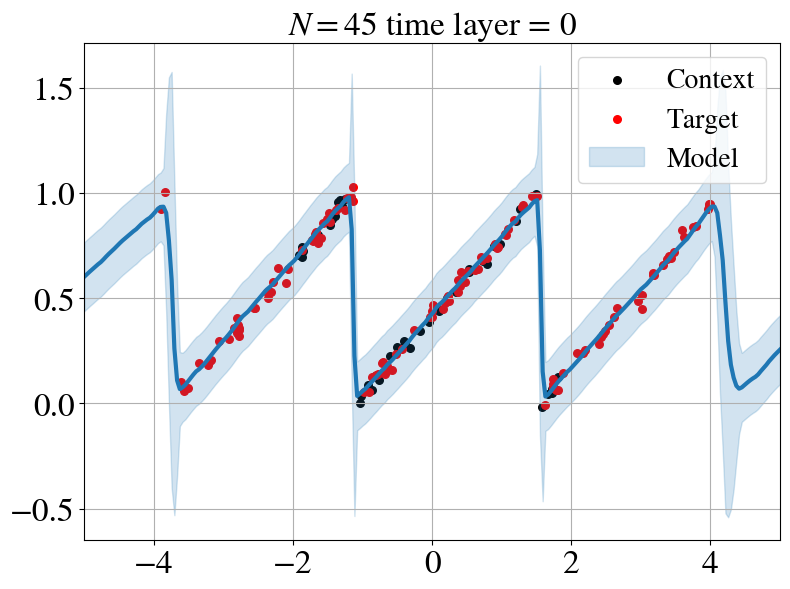

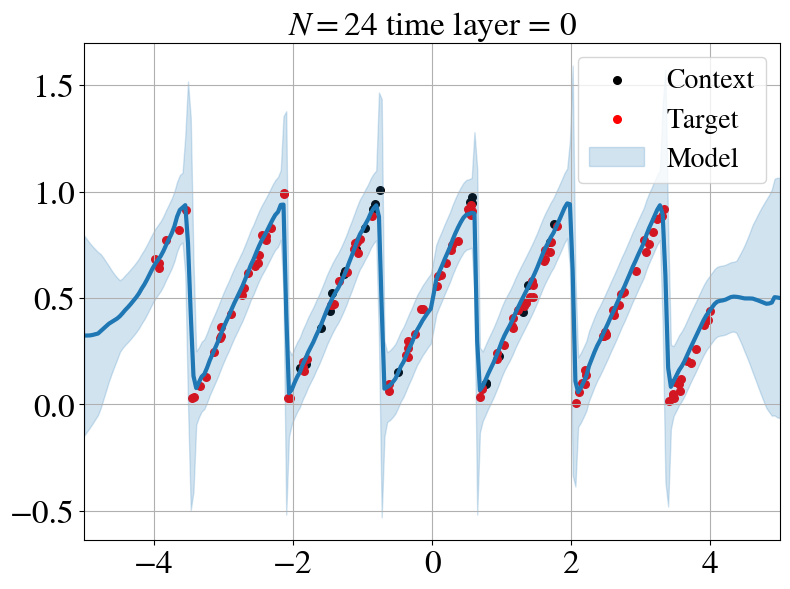

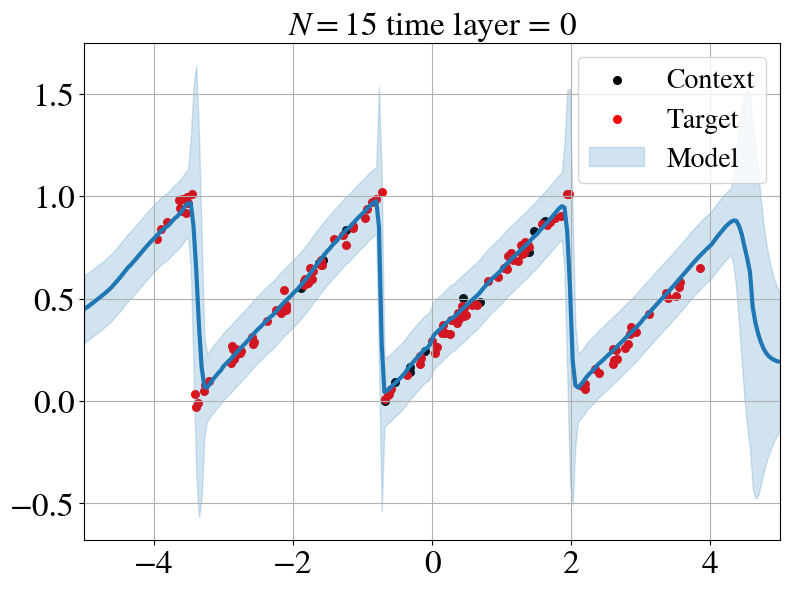

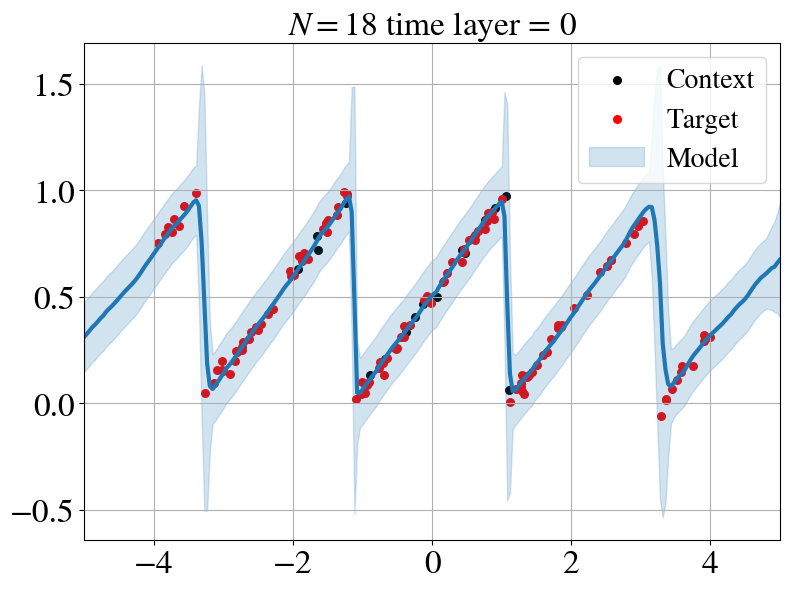

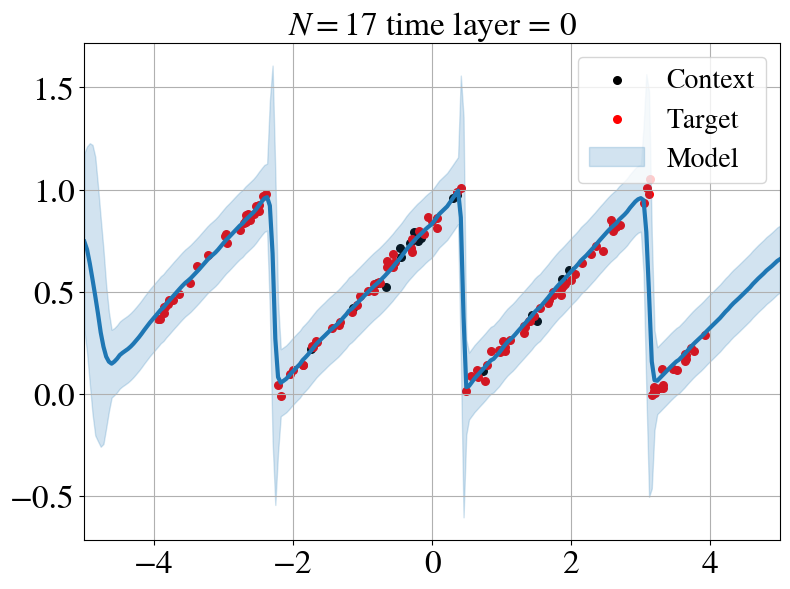

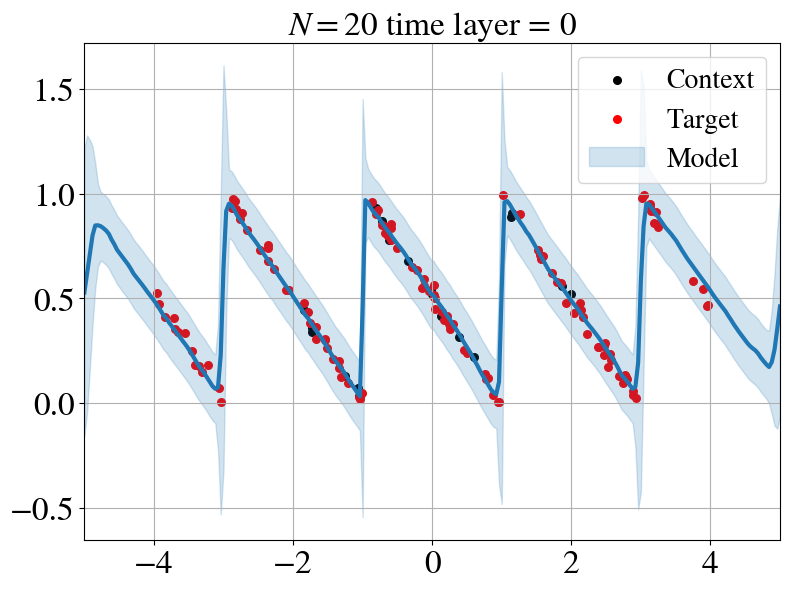

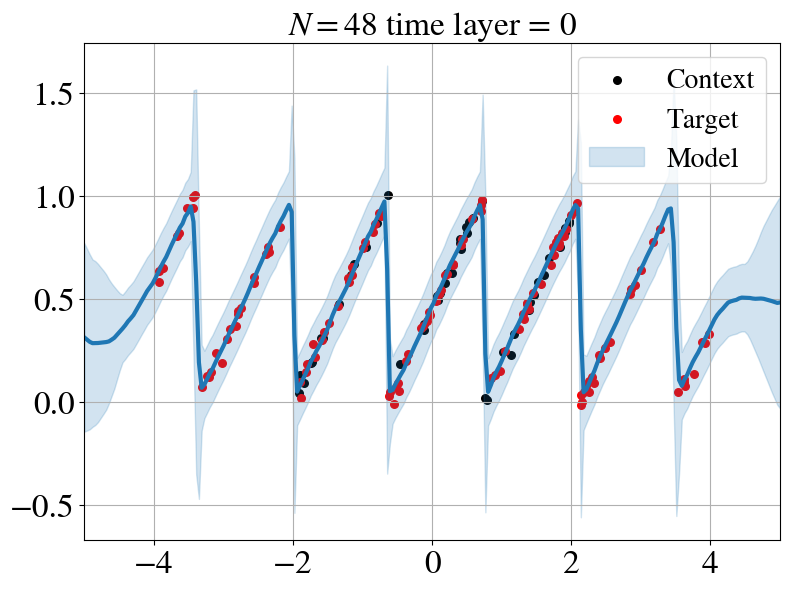

In [78]:
print("Predictions at each layer for model without Gaussian head, 0 layers")
for i, batch in enumerate(gen_test):
    plot(
            model=model,
            scheduler=scheduler,
            batch=batch,
            pred_fn=discrete_denoising_sampling,
        )
    if i > 5:
        break


Predictions at each layer for model without Gaussian head, 1 layer


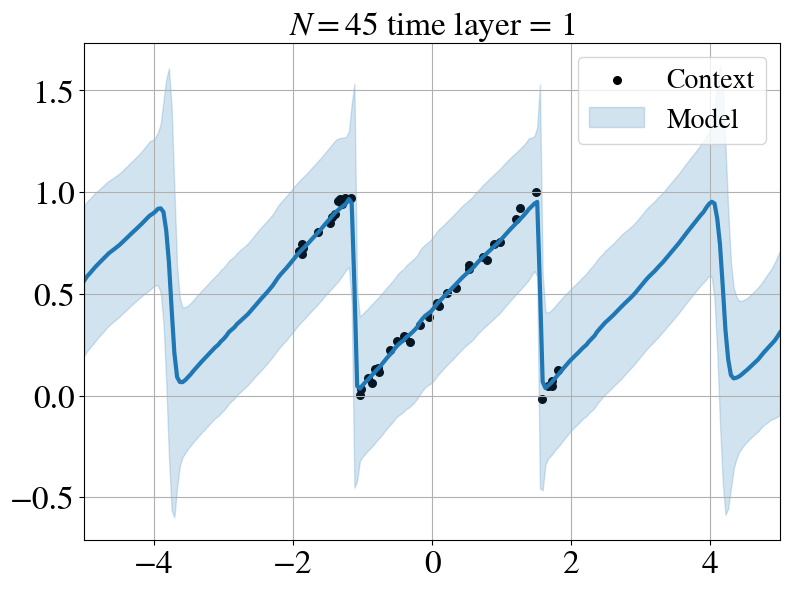

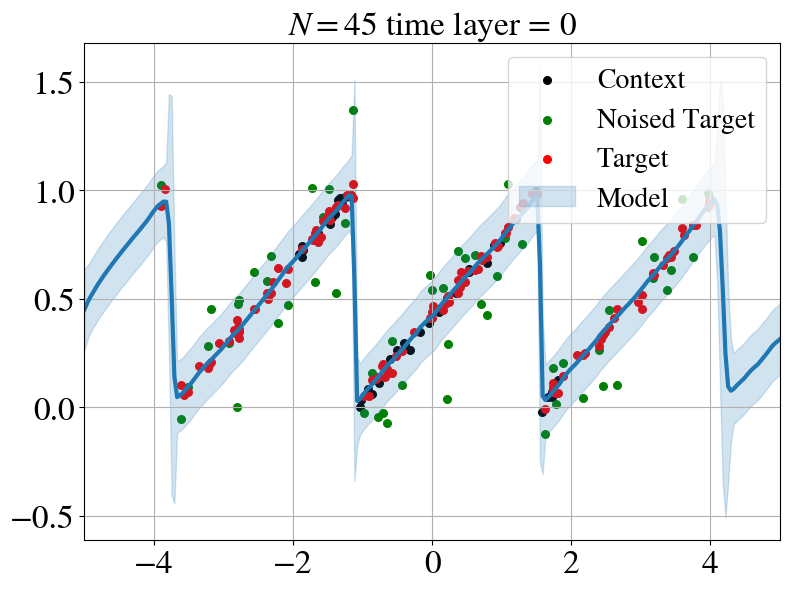

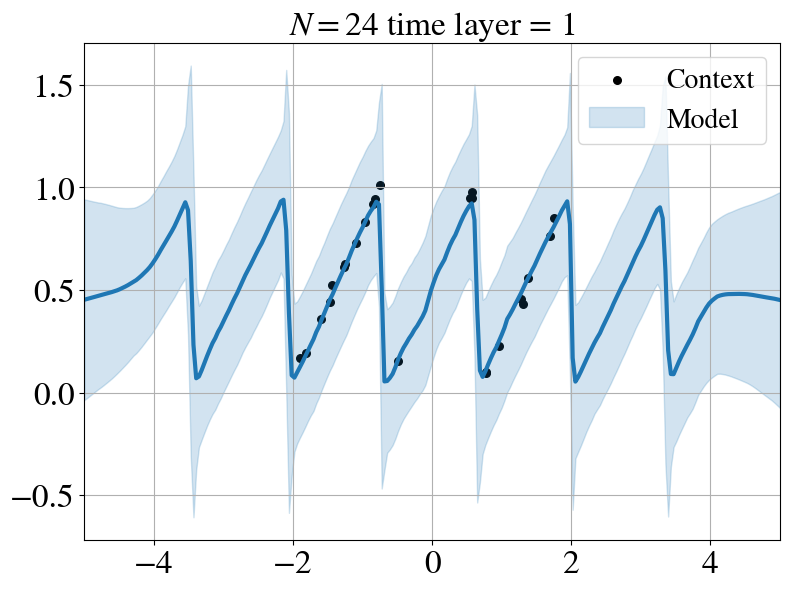

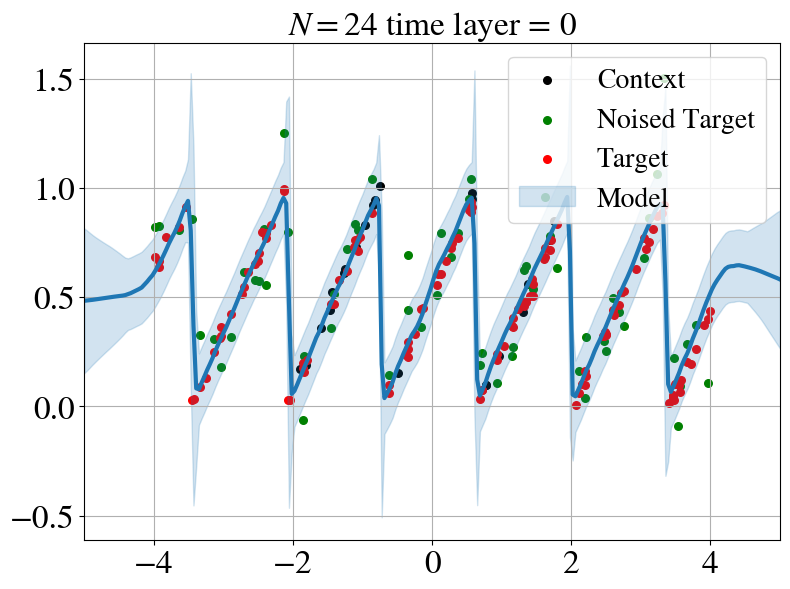

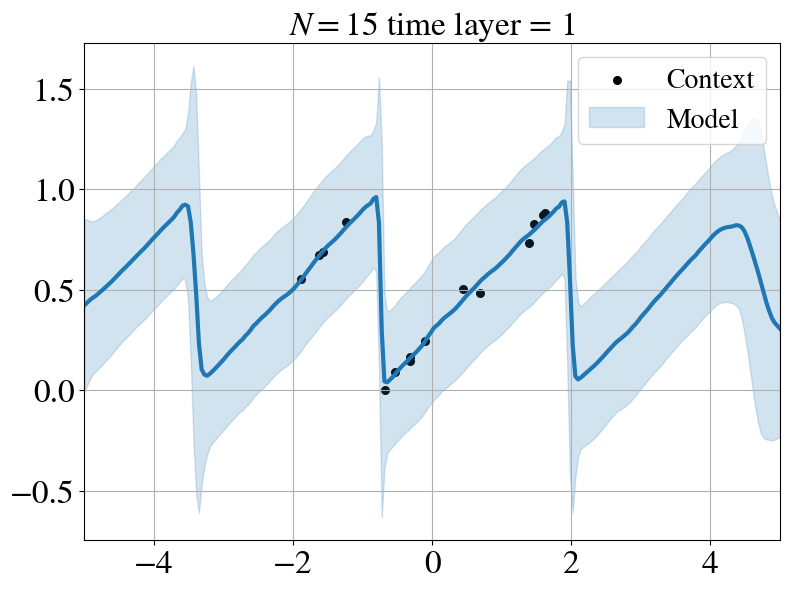

...

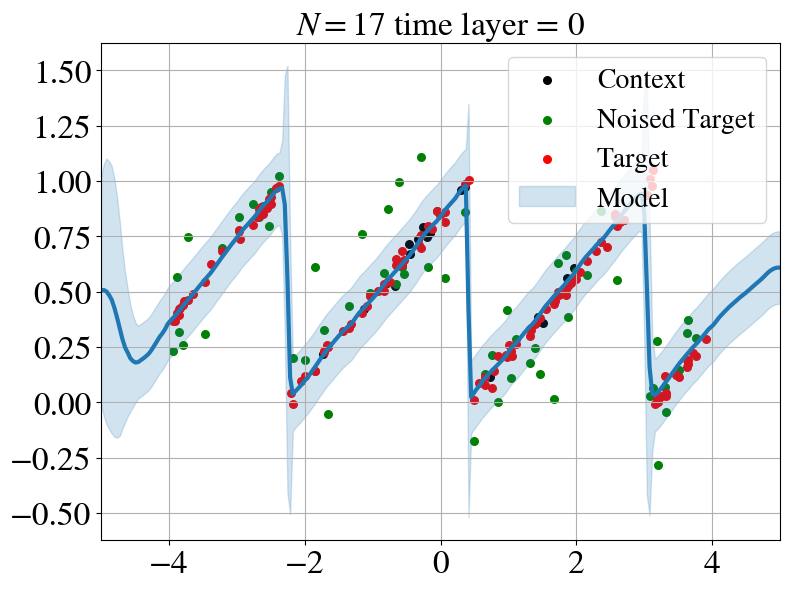

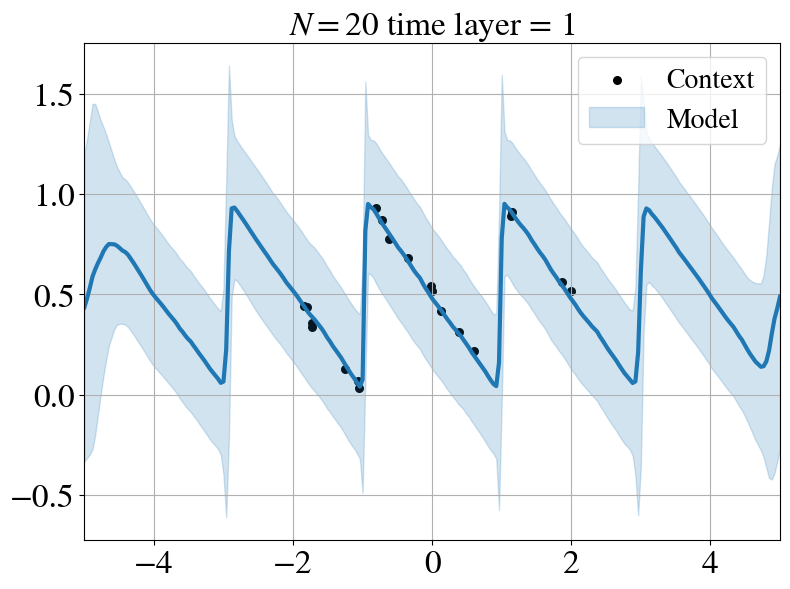

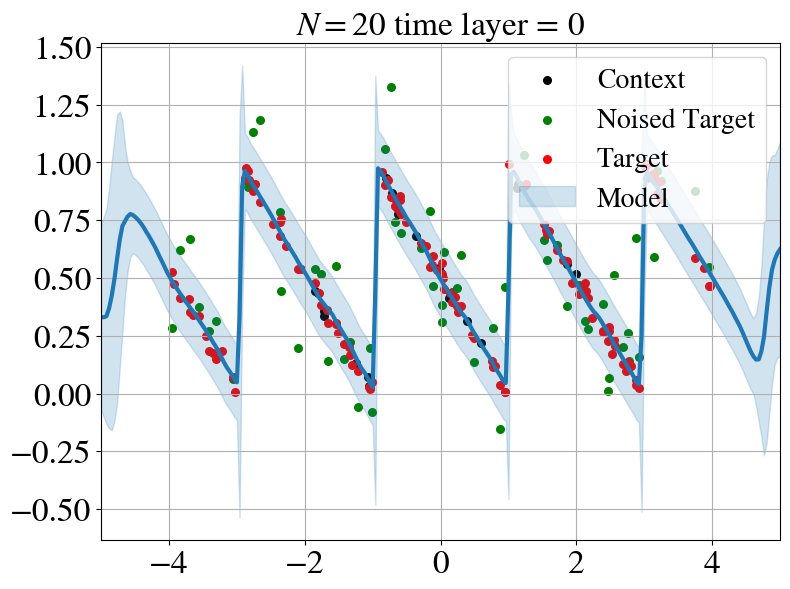

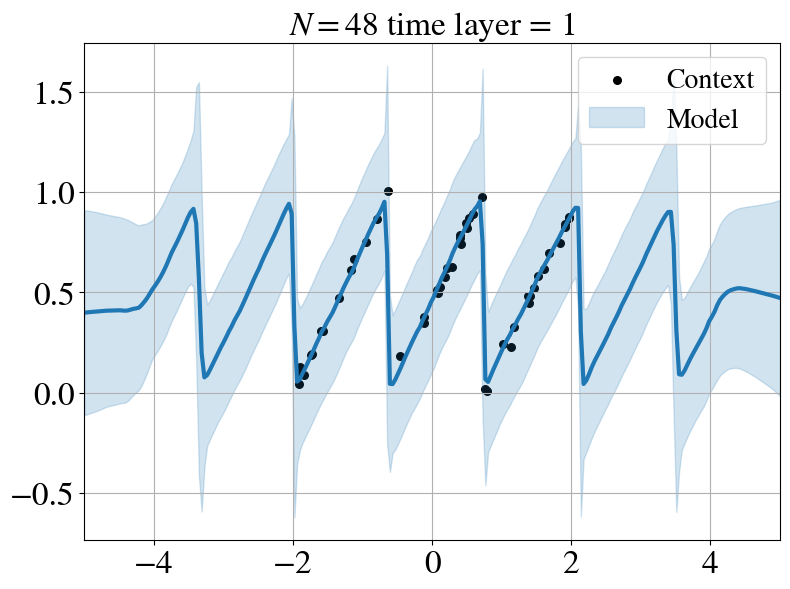

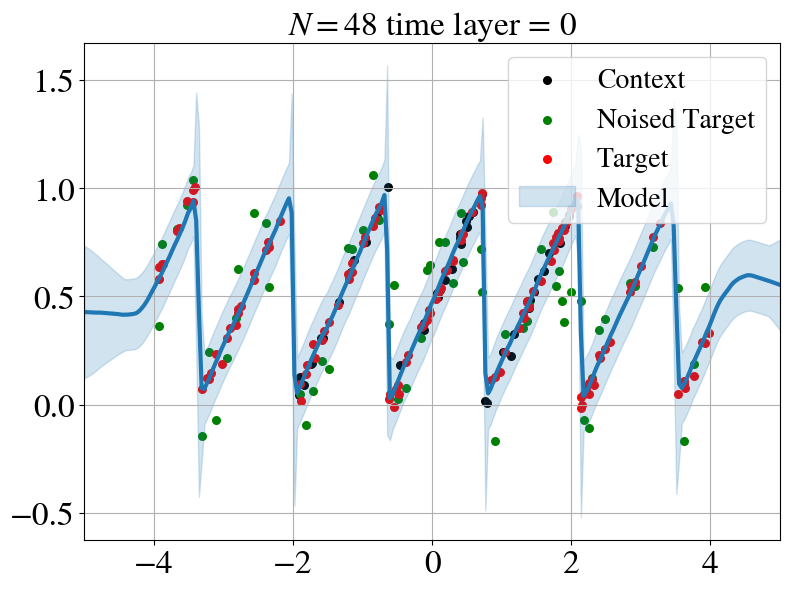

In [81]:
print("Predictions at each layer for model without Gaussian head, 1 layer")
for i, batch in enumerate(gen_test):
    plot(
            model=model,
            scheduler=scheduler,
            batch=batch,
            pred_fn=discrete_denoising_sampling,
        )
    if i > 5:
        break


## Plotting samples

Samples from model without Gaussian head, 0 layers


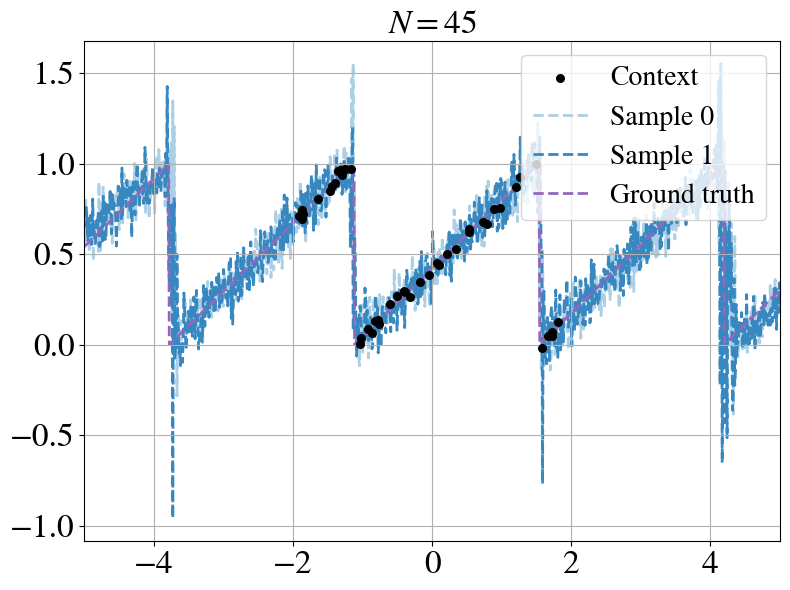

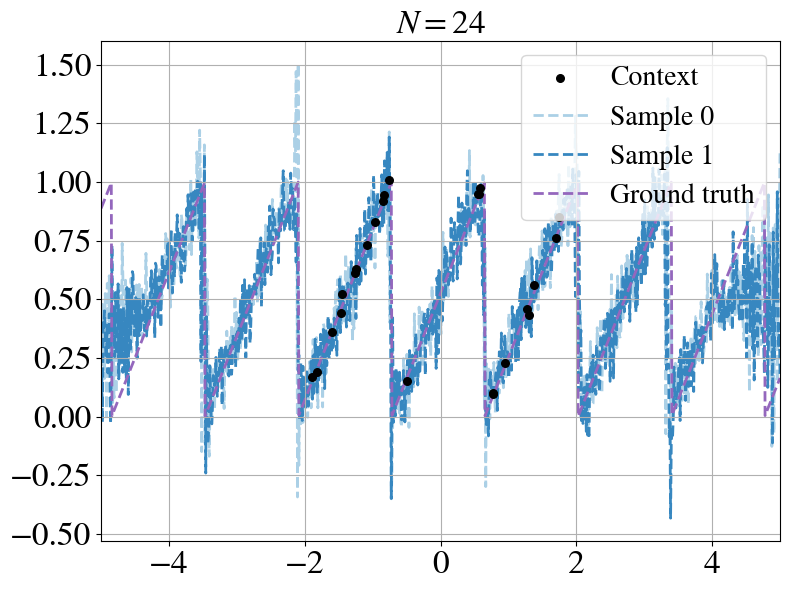

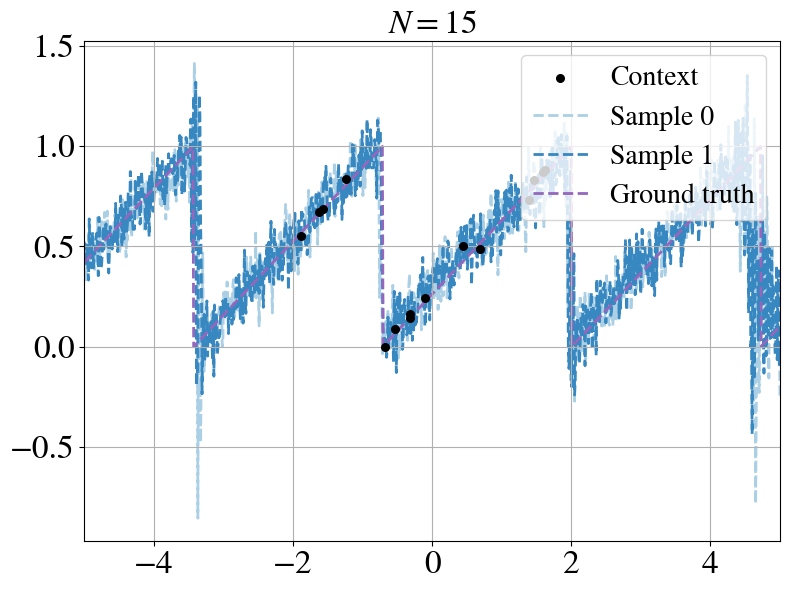

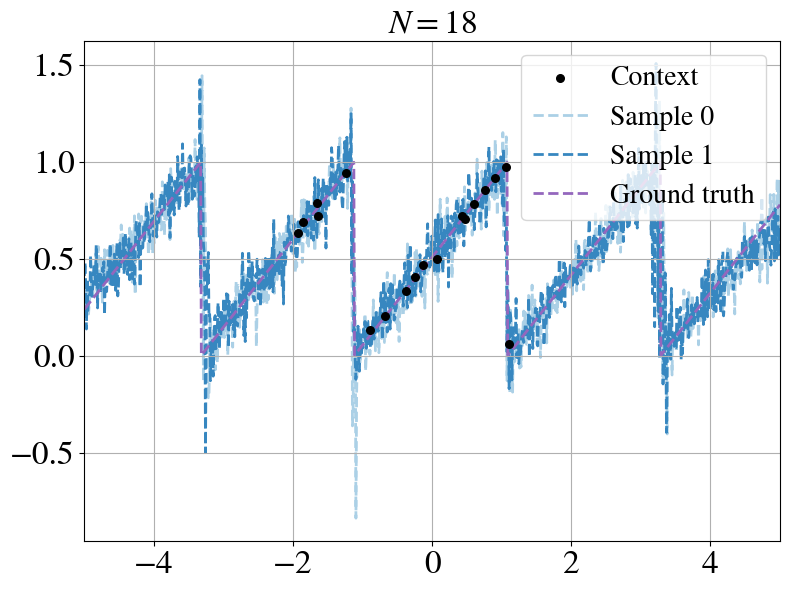

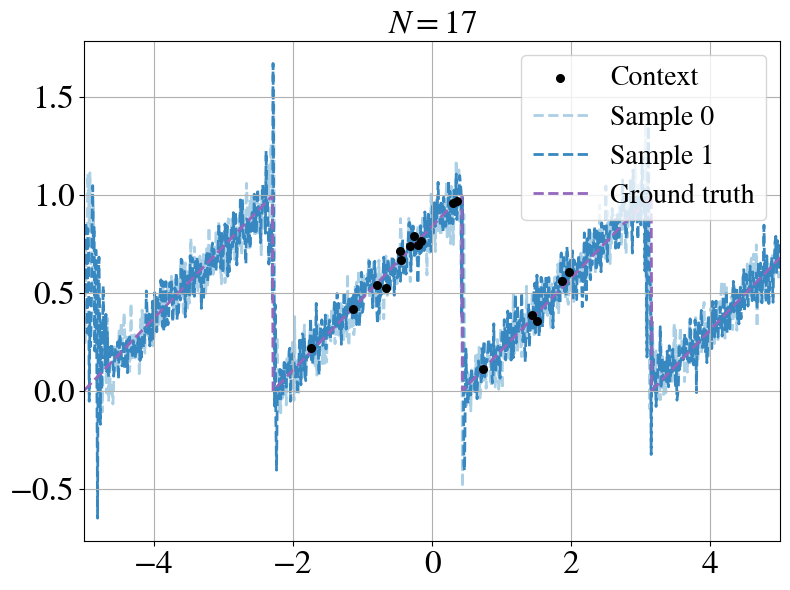

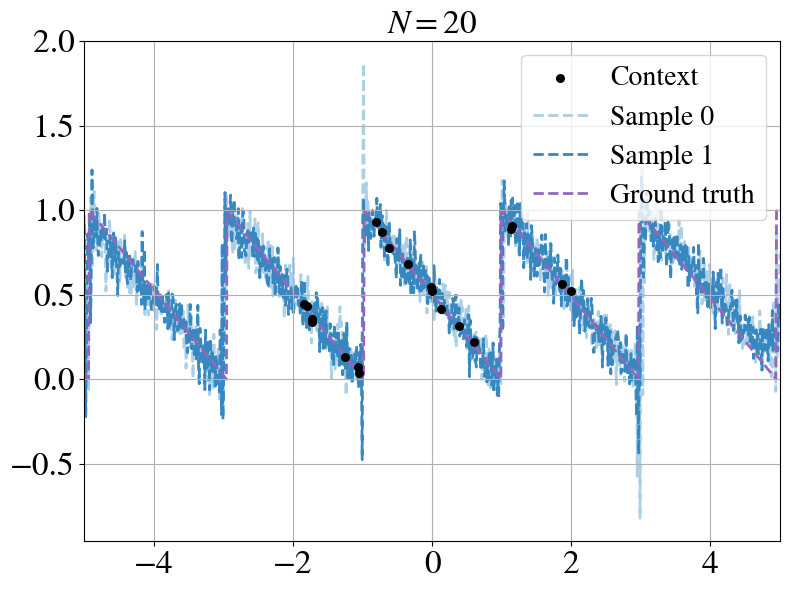

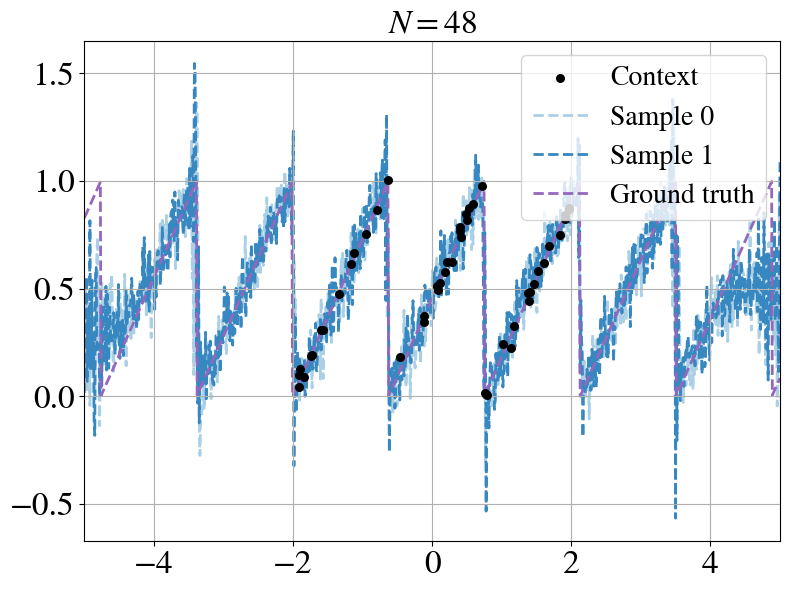

In [85]:
print("Samples from model without Gaussian head, 0 layers")
for i, batch in enumerate(gen_test):
    plot_samples(
            model=model,
            scheduler=scheduler,
            batch=batch,
            num_samples=2,
        )
    if i > 5:
        break

Samples from model without Gaussian head, 1 layer


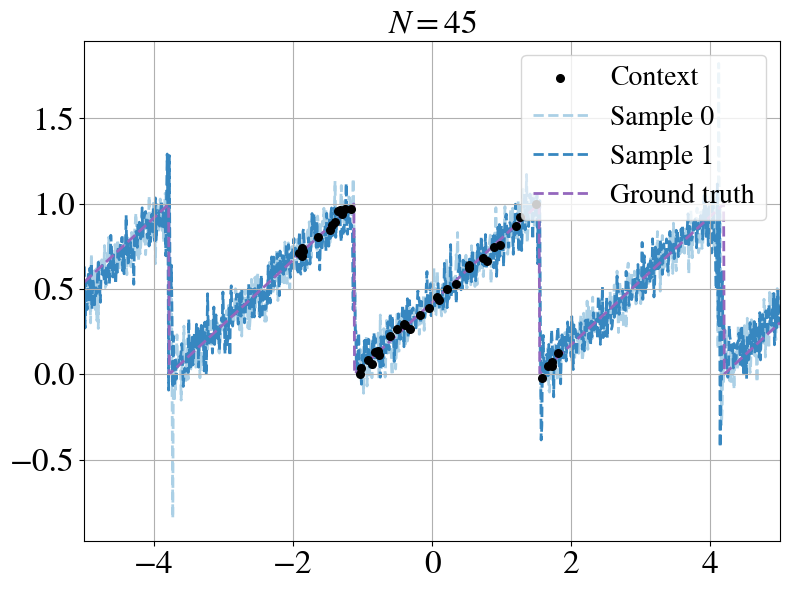

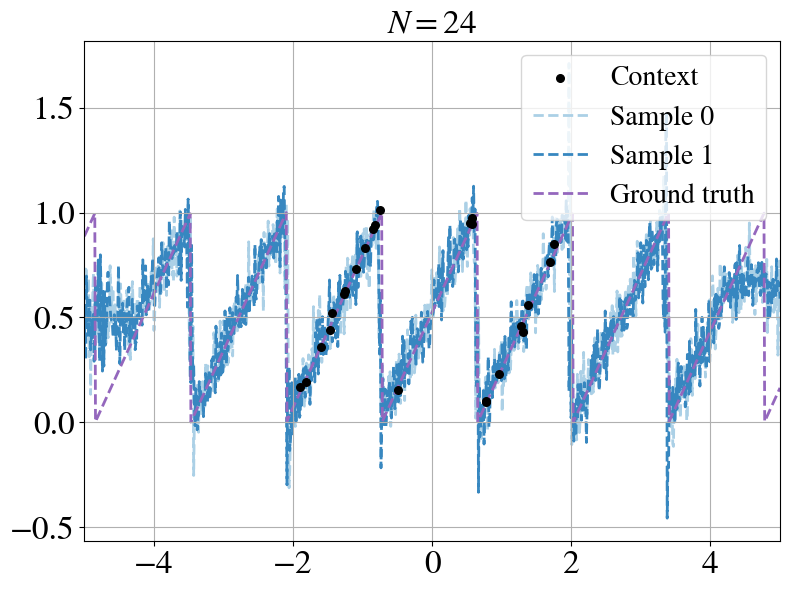

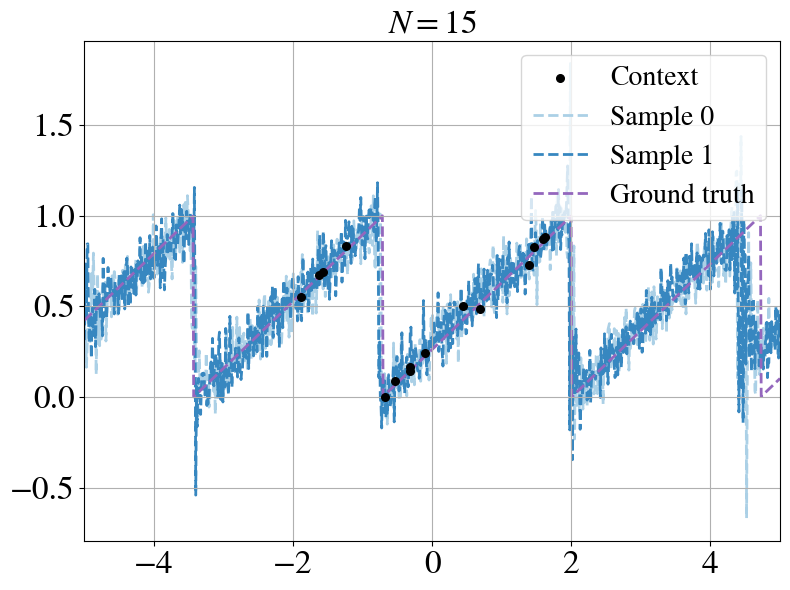

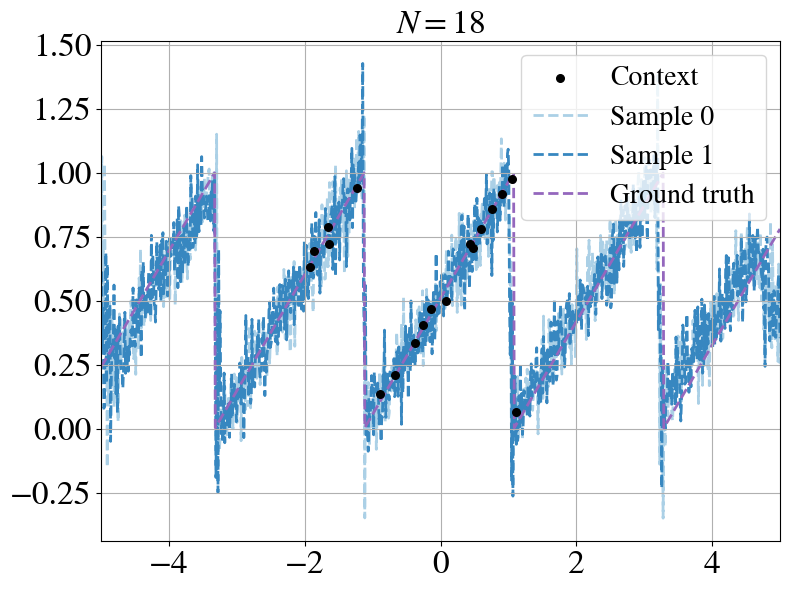

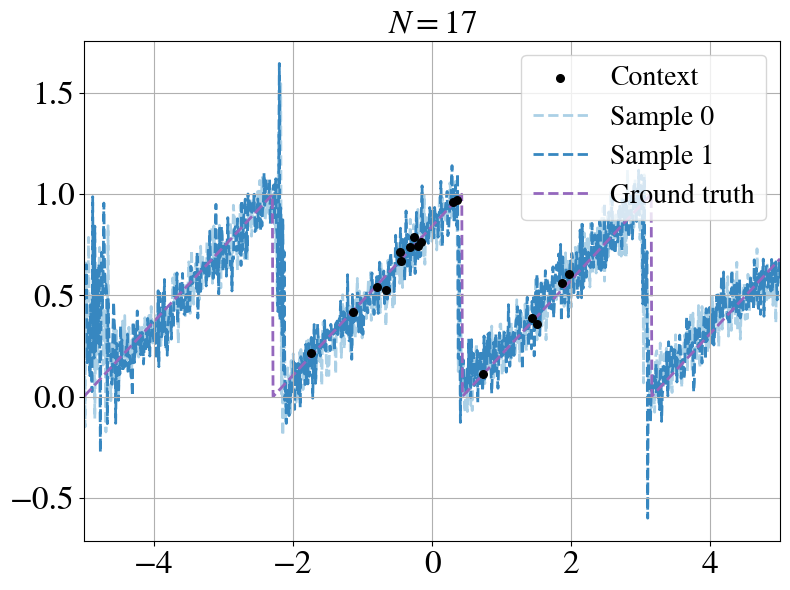

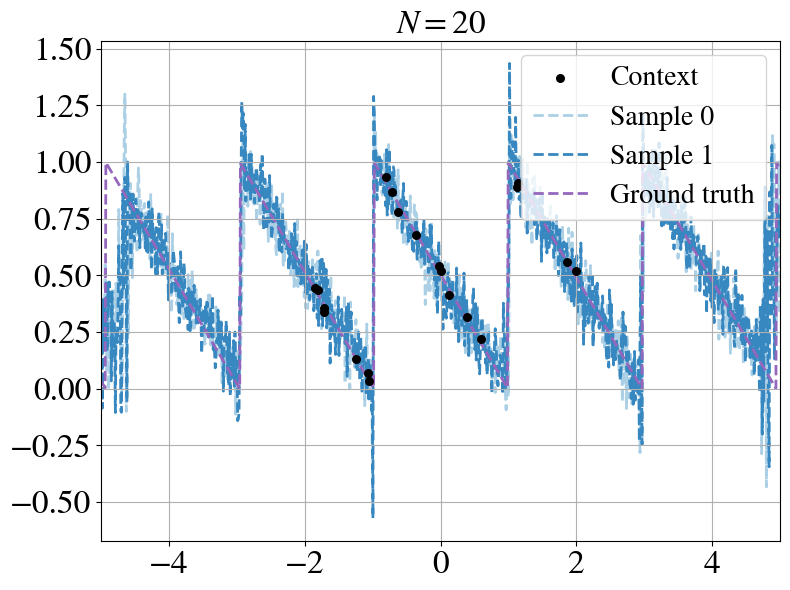

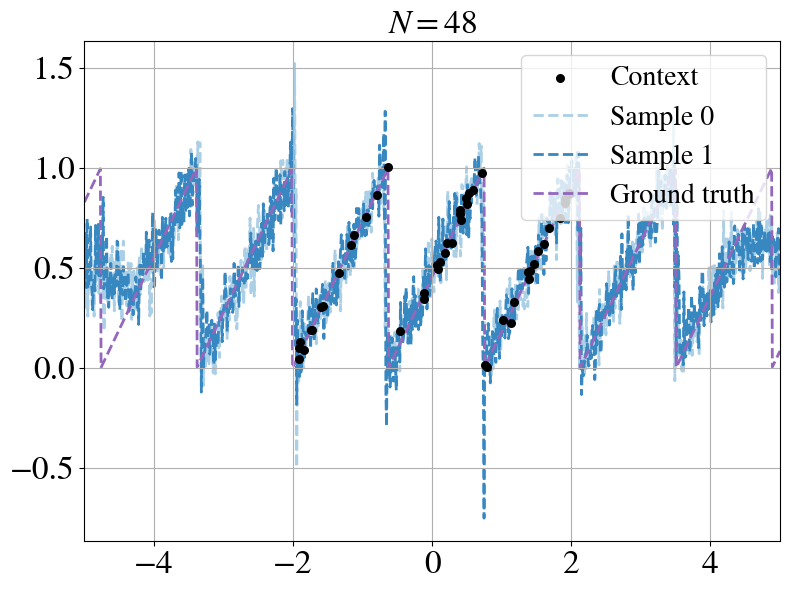

In [82]:
print("Samples from model without Gaussian head, 1 layer")
for i, batch in enumerate(gen_test):
    plot_samples(
            model=model,
            scheduler=scheduler,
            batch=batch,
            num_samples=2,
        )
    if i > 5:
        break

In [ ]:
def plot_samples(
    model: Union[
        nn.Module,
        Callable[..., torch.distributions.Distribution],
    ],
    scheduler: BaseScheduler,
    batch: Batch,
    figsize: Tuple[float, float] = (8.0, 6.0),
    x_range: Union[
        Tuple[float, float], Tuple[Tuple[float, float], Tuple[float, float]]
    ] = (-5.0, 5.0),
    y_lim: Tuple[float, float] = (-3.0, 3.0),
    points_per_dim: int = 1000,
    plot_ar_mode: bool = False,
    num_ar_samples: int = 20,
    plot_target: bool = True,
    name: str = "plot",
    savefig: bool = False,
    logging: bool = True,
    num_samples: int = 5,
):
    colors = iter(list(sns.color_palette("Blues", num_samples)))
    # Get dimension of input data
    dim = batch.xc.shape[-1]

    if dim == 1:
        x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]
        xc = batch.xc[:1]
        yc = batch.yc[:1]
        xt = batch.xt[:1]
        yt = batch.yt[:1]

        batch.xc = xc
        batch.yc = yc
        batch.xt = xt
        batch.yt = yt

        plot_batch = copy.deepcopy(batch)
        plot_batch.xt = x_plot

        with torch.no_grad():
            pred_dist = discrete_denoising_preddist(
                    model=model,
                    batch=plot_batch,
                    scheduler=scheduler,
                    num_samples=num_samples,
                    subsample_targets=True,
            )

        # Make figure for plotting
        fig = plt.figure(figsize=figsize)

        # Plot context and target points
        plt.scatter(
            xc[0, :, 0].cpu().numpy(),
            yc[0, :, 0].cpu().numpy(),
            c="k",
            label="Context",
            s=30,
            zorder=4,
        )

        # Plot model predictions
        # pred = pred_dist.rsample()
        # sorted_xt, idx = torch.sort(xt, dim=1)
        # pred = torch.gather(pred, 1, idx)
        for i in range(num_samples):
            pred = pred_dist.rsample()
            plt.plot(
                x_plot[0, :, 0].cpu(),
                pred.squeeze(-1)[0, :].cpu(),
                c=next(colors),
                lw=2,
                zorder=0,
                label=f"Sample {i}",
                linestyle="--",
            )
        title_str = f"$N = {xc.shape[1]}$"        

        if isinstance(batch, SyntheticBatch) and batch.gt_pred is not None:
            with torch.no_grad():
                gt_mean, gt_std, _, _ = batch.gt_pred(
                    xc=xc[:1],
                    yc=yc[:1],
                    xt=x_plot[:1],
                )
                _, _, gt_loglik, _ = batch.gt_pred(
                    xc=xc[:1],
                    yc=yc[:1],
                    xt=xt[:1],
                    yt=yt[:1],
                )
                gt_nll = -gt_loglik.sum() / batch.yt[..., 0].numel()

            # Plot ground truth
            plt.plot(
                x_plot[0, :, 0].cpu(),
                gt_mean[0, :].cpu(),
                "--",
                color="tab:purple",
                lw=2,
                zorder=0,
            )

            plt.plot(
                x_plot[0, :, 0].cpu(),
                gt_mean[0, :].cpu() + 2 * gt_std[0, :].cpu(),
                "--",
                color="tab:purple",
                lw=2,
                zorder=0,
            )

            plt.plot(
                x_plot[0, :, 0].cpu(),
                gt_mean[0, :].cpu() - 2 * gt_std[0, :].cpu(),
                "--",
                color="tab:purple",
                label="Ground truth",
                lw=2,
                zorder=0,
            )

            title_str += f" GT NLL = {gt_nll:.3f}"
        
        elif isinstance(batch, SyntheticBatch) and batch.params is not None:
            if batch.params[0] == "squarewave":
                _, freq, offset = batch.params
                f = torch.where(
                    torch.floor(x_plot[0, :, 0].cpu() * freq[0, ...].cpu() - offset[0, ...].cpu()) % 2 == 0, 
                    1.0, 0.0)
                plt.plot(
                    x_plot[0, :, 0].cpu(), 
                    f.cpu(), 
                    "--",
                    color="tab:purple",
                    label="Ground truth",
                    lw=2,
                    zorder=0,
                )
            elif batch.params[0] == "sawtooth":
                _, freq, offset, direction = batch.params
                f = (
                    freq[0, ...].cpu() * (x_plot[0, :, 0].cpu() * direction[0, ...].cpu() - offset[0, ...].cpu())
                ) % 1
                plt.plot(
                    x_plot[0, :, 0].cpu(), 
                    f.cpu(), 
                    "--",
                    color="tab:purple",
                    label="Ground truth",
                    lw=2,
                    zorder=0,
                )


        if plot_ar_mode:
            ar_x_plot = torch.linspace(xc.max(), x_range[1], 50).to(batch.xc)[
                None, :, None
            ]
            _, ar_sample_logprobs = ar_predict(
                model, xc=xc, yc=yc, xt=xt, num_samples=num_ar_samples
            )
            ar_samples, _ = ar_predict(
                model, xc=xc, yc=yc, xt=ar_x_plot, num_samples=num_ar_samples
            )

            for ar_sample in ar_samples[:1]:
                plt.plot(
                    ar_x_plot[0, :, 0].cpu(),
                    ar_sample[0, :, 0].cpu(),
                    color="tab:blue",
                    alpha=0.4,
                    label="AR samples",
                )

            ar_nll = -ar_sample_logprobs.mean()
            title_str += f" AR NLL: {ar_nll:.3f}"

        plt.title(title_str, fontsize=24)
        plt.grid()

        # Set axis limits
        plt.xlim(x_range)
        # plt.ylim(y_lim)
        if batch.gt_pred is not None:
            y_max = 0.25 + max(gt_mean[0, ...] + 2 * gt_std[0, ...])
            y_min = -0.25 + min(gt_mean[0, ...] - 2 * gt_std[0, ...])
            y_lim = (y_min.cpu(), y_max.cpu())
            plt.ylim(y_lim)

        plt.xticks(fontsize=24)
        plt.yticks(fontsize=24)

        plt.legend(loc="upper right", fontsize=20)
        plt.tight_layout()
        fname = f"fig/{name}/{i:03d}"
        if wandb.run is not None and logging:
            wandb.log({fname: wandb.Image(fig)})
        elif savefig:
            if not os.path.isdir(f"fig/{name}"):
                os.makedirs(f"fig/{name}")
            plt.savefig(fname, bbox_inches="tight")
        else:
            plt.show()

        plt.close()

        plt.close()
    else:
        raise NotImplementedError

Samples from 0 layer model, with Gaussian head


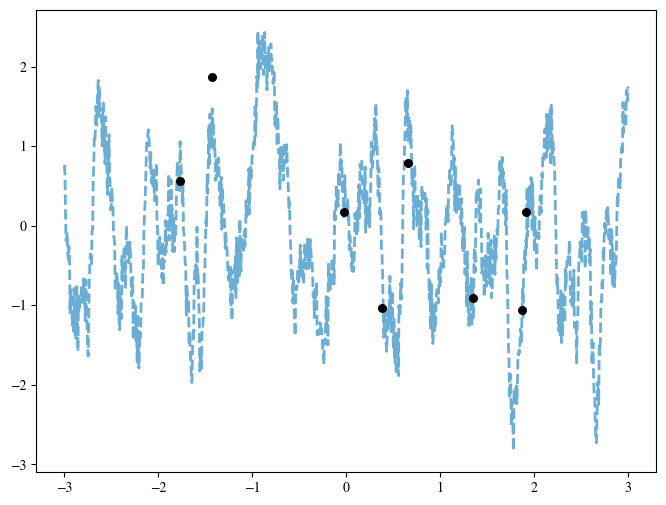

In [12]:
x_range = (-3, 3)
points_per_dim = 1000
num_samples = 1
figsize = (8, 6)

for i, batch_iter in enumerate(gen_test):
    if i == 3:
        batch = copy.deepcopy(batch_iter)

colors = iter(list(sns.color_palette("Blues", num_samples)))
x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]
xc = batch.xc[:1]
yc = batch.yc[:1]
xt = batch.xt[:1]
yt = batch.yt[:1]

batch.xc = xc
batch.yc = yc
batch.xt = xt
batch.yt = yt

plot_batch = copy.deepcopy(batch)
plot_batch.xt = x_plot

with torch.no_grad():
    pred_dist = discrete_denoising_preddist(
            model=model,
            batch=plot_batch,
            scheduler=scheduler,
            num_samples=num_samples,
            subsample_targets=True,
    )

# Make figure for plotting
fig = plt.figure(figsize=figsize)

# Plot context and target points
plt.scatter(
    xc[0, :, 0].cpu().numpy(),
    yc[0, :, 0].cpu().numpy(),
    c="k",
    label="Context",
    s=30,
    zorder=4,
)

# Plot model predictions
for i in range(num_samples):
    pred = pred_dist.rsample()
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[0, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
print("Samples from 0 layer model, with Gaussian head")

Samples from 0 layer model, no Gaussian head


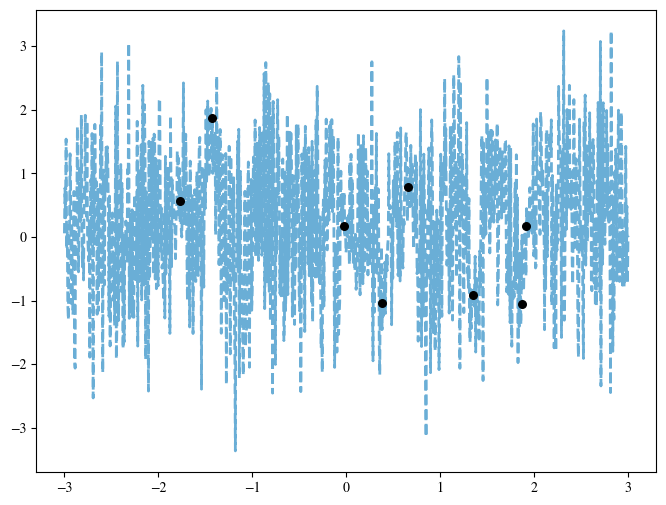

In [7]:
x_range = (-3, 3)
points_per_dim = 1000
num_samples = 1
figsize = (8, 6)

for i, batch_iter in enumerate(gen_test):
    if i == 3:
        batch = copy.deepcopy(batch_iter)

colors = iter(list(sns.color_palette("Blues", num_samples)))
x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]
xc = batch.xc[:1]
yc = batch.yc[:1]
xt = batch.xt[:1]
yt = batch.yt[:1]

batch.xc = xc
batch.yc = yc
batch.xt = xt
batch.yt = yt

plot_batch = copy.deepcopy(batch)
plot_batch.xt = x_plot

with torch.no_grad():
    pred_dist = discrete_denoising_preddist(
            model=model,
            batch=plot_batch,
            scheduler=scheduler,
            num_samples=num_samples,
            subsample_targets=True,
    )

# Make figure for plotting
fig = plt.figure(figsize=figsize)

# Plot context and target points
plt.scatter(
    xc[0, :, 0].cpu().numpy(),
    yc[0, :, 0].cpu().numpy(),
    c="k",
    label="Context",
    s=30,
    zorder=4,
)

# Plot model predictions
for i in range(num_samples):
    pred = pred_dist.rsample()
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[0, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
print("Samples from 0 layer model, no Gaussian head")

Samples from 1 layer model, with Gaussian head


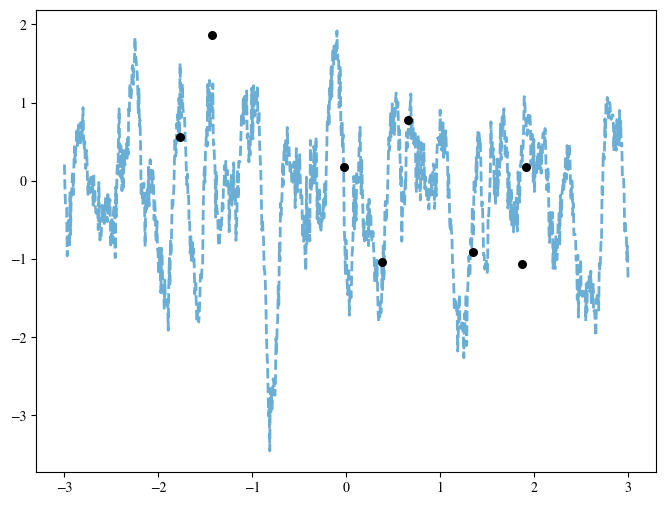

In [17]:
x_range = (-3, 3)
points_per_dim = 1000
num_samples = 1
figsize = (8, 6)

for i, batch_iter in enumerate(gen_test):
    if i == 3:
        batch = copy.deepcopy(batch_iter)

colors = iter(list(sns.color_palette("Blues", num_samples)))
x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]
xc = batch.xc[:1]
yc = batch.yc[:1]
xt = batch.xt[:1]
yt = batch.yt[:1]

batch.xc = xc
batch.yc = yc
batch.xt = xt
batch.yt = yt

plot_batch = copy.deepcopy(batch)
plot_batch.xt = x_plot

with torch.no_grad():
    pred_dist = discrete_denoising_preddist(
            model=model,
            batch=plot_batch,
            scheduler=scheduler,
            num_samples=num_samples,
            subsample_targets=True,
    )

# Make figure for plotting
fig = plt.figure(figsize=figsize)

# Plot context and target points
plt.scatter(
    xc[0, :, 0].cpu().numpy(),
    yc[0, :, 0].cpu().numpy(),
    c="k",
    label="Context",
    s=30,
    zorder=4,
)

# Plot model predictions
for i in range(num_samples):
    pred = pred_dist.rsample()
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[0, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
print("Samples from 1 layer model, with Gaussian head")

Samples from 1 layer model, no Gaussian head


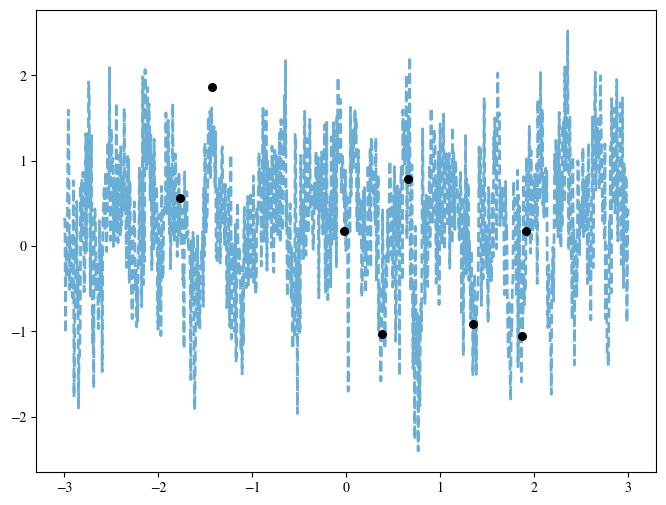

In [24]:
x_range = (-3, 3)
points_per_dim = 1000
num_samples = 1
figsize = (8, 6)

for i, batch_iter in enumerate(gen_test):
    if i == 3:
        batch = copy.deepcopy(batch_iter)

colors = iter(list(sns.color_palette("Blues", num_samples)))
x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]
xc = batch.xc[:1]
yc = batch.yc[:1]
xt = batch.xt[:1]
yt = batch.yt[:1]

batch.xc = xc
batch.yc = yc
batch.xt = xt
batch.yt = yt

plot_batch = copy.deepcopy(batch)
plot_batch.xt = x_plot

with torch.no_grad():
    pred_dist = discrete_denoising_preddist(
            model=model,
            batch=plot_batch,
            scheduler=scheduler,
            num_samples=num_samples,
            subsample_targets=True,
    )

# Make figure for plotting
fig = plt.figure(figsize=figsize)

# Plot context and target points
plt.scatter(
    xc[0, :, 0].cpu().numpy(),
    yc[0, :, 0].cpu().numpy(),
    c="k",
    label="Context",
    s=30,
    zorder=4,
)

# Plot model predictions
for i in range(num_samples):
    pred = pred_dist.rsample()
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[0, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
print("Samples from 1 layer model, no Gaussian head")

Samples from model with Gaussian head, 0 layers


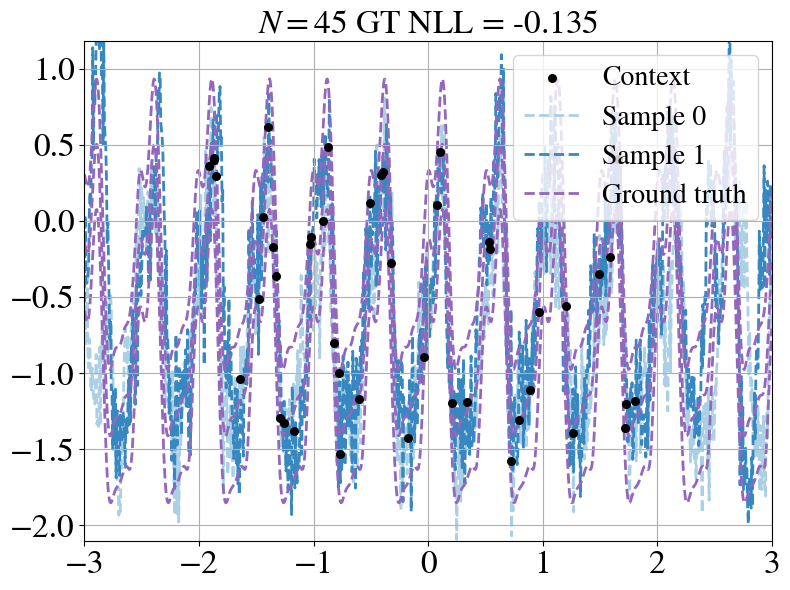

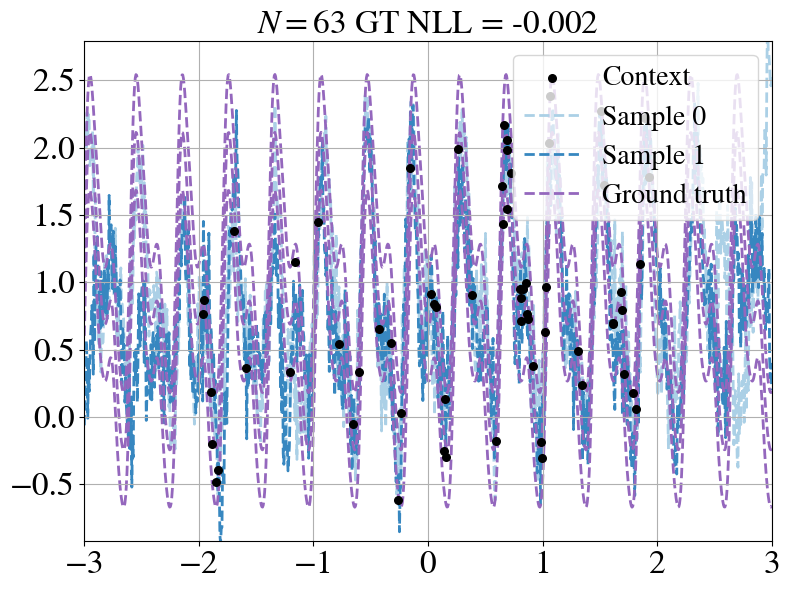

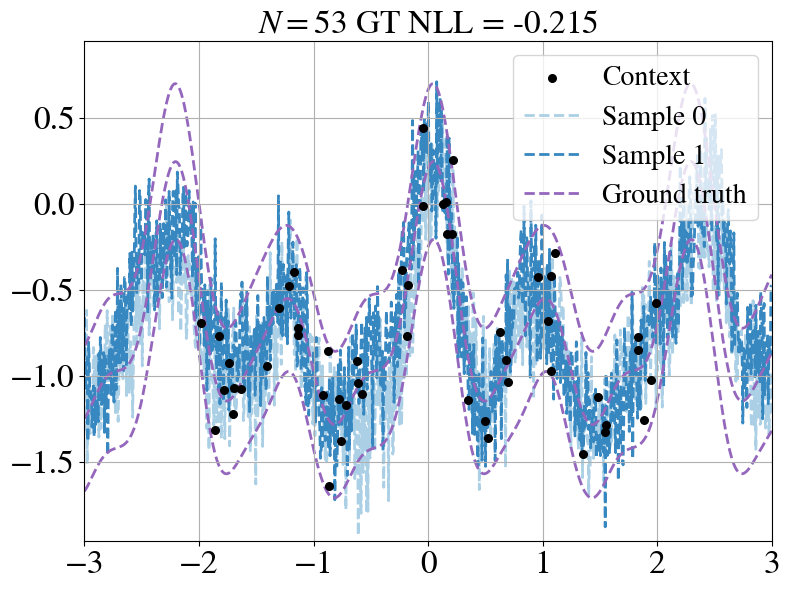

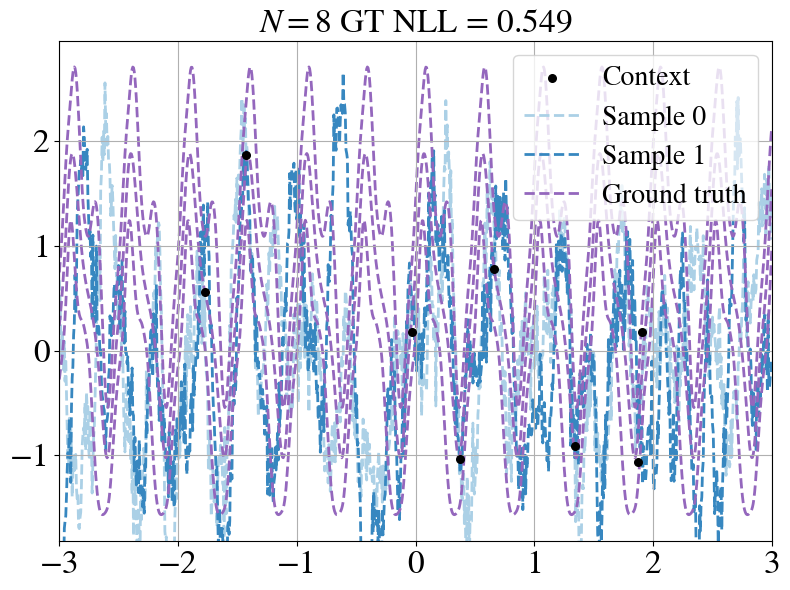

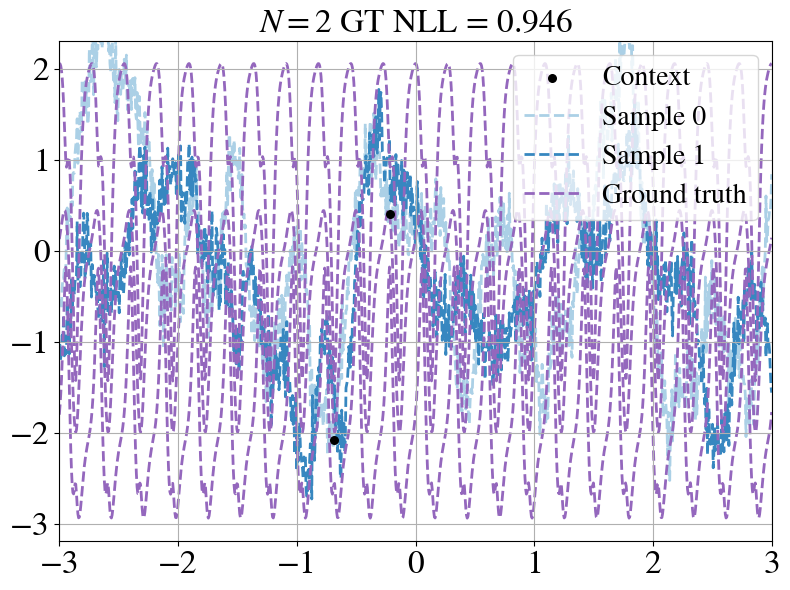

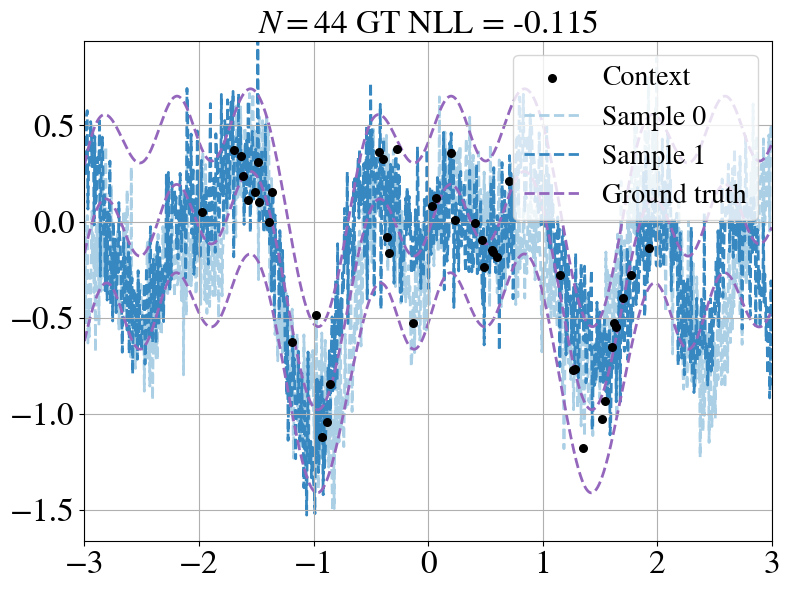

In [154]:
print("Samples from model with Gaussian head, 0 layers")
for i, batch in enumerate(gen_test):
    plot_samples(
            model=model,
            scheduler=scheduler,
            batch=batch,
            num_samples=2,
        )
    if i > 5:
        break

Samples from model with Gaussian head, 1 layer


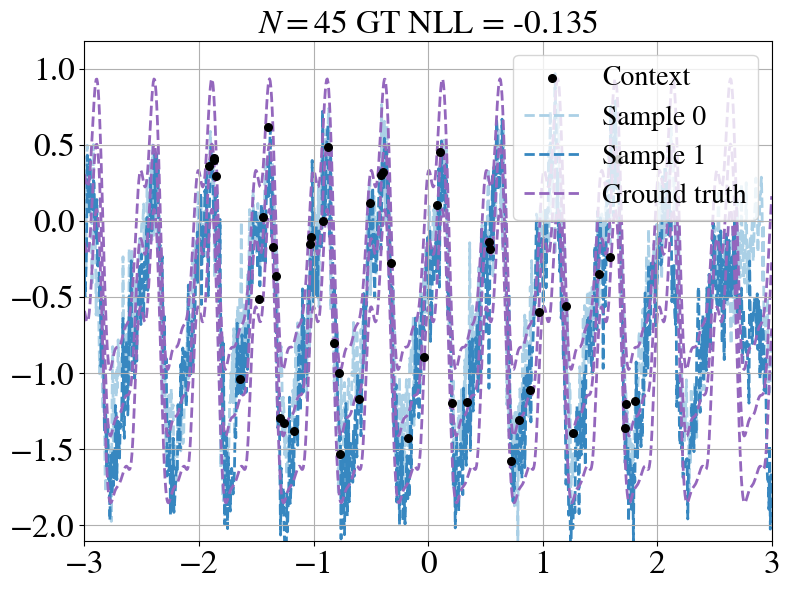

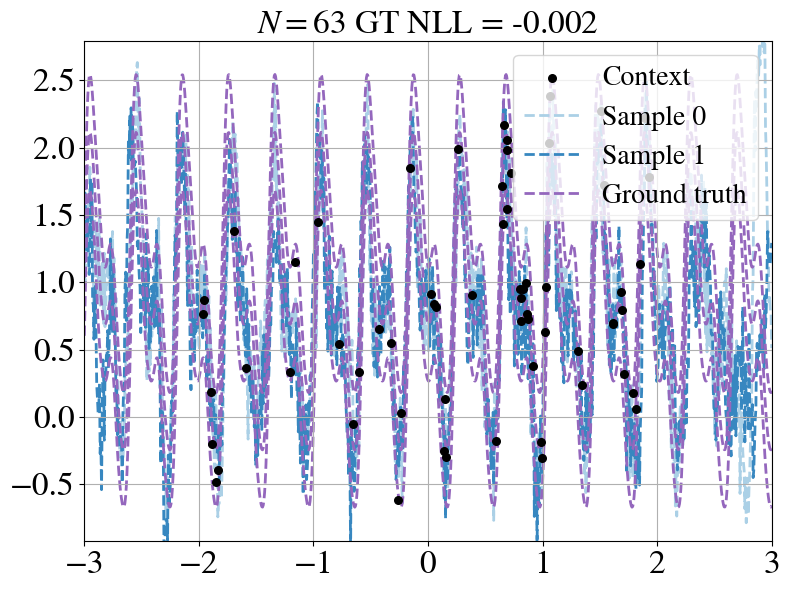

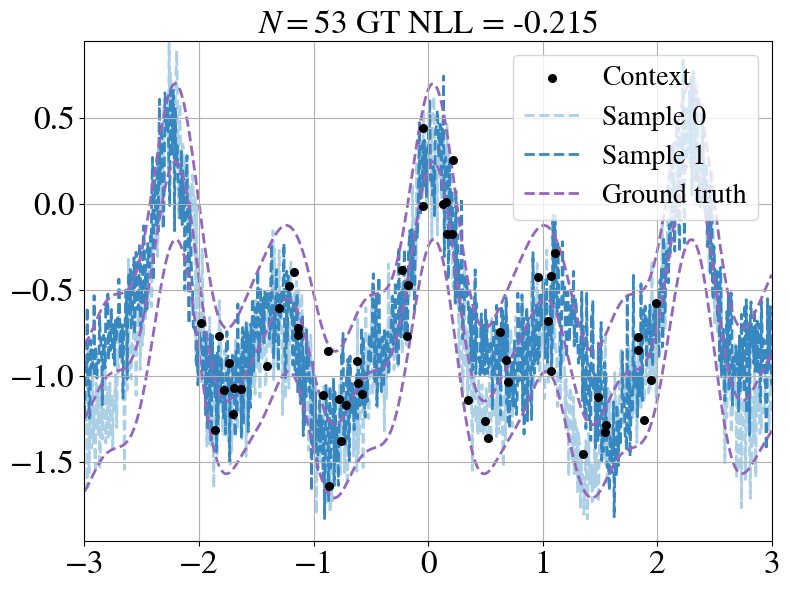

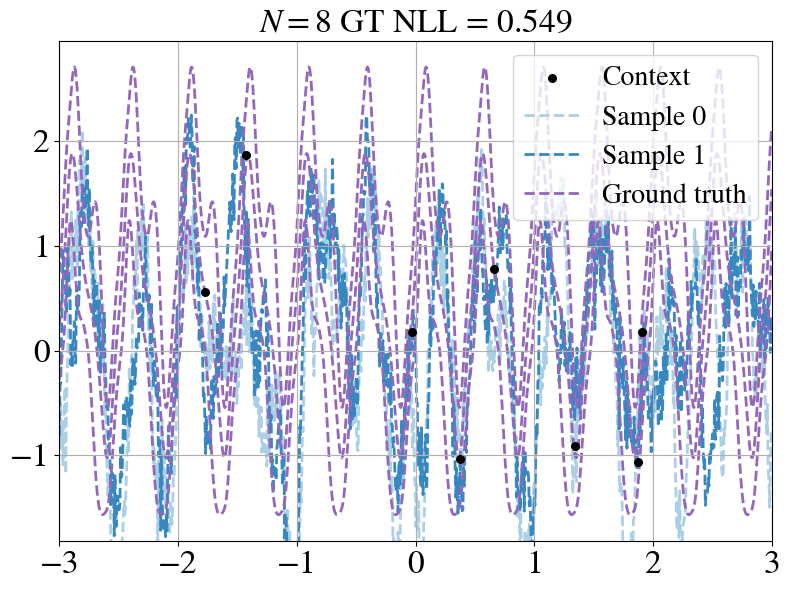

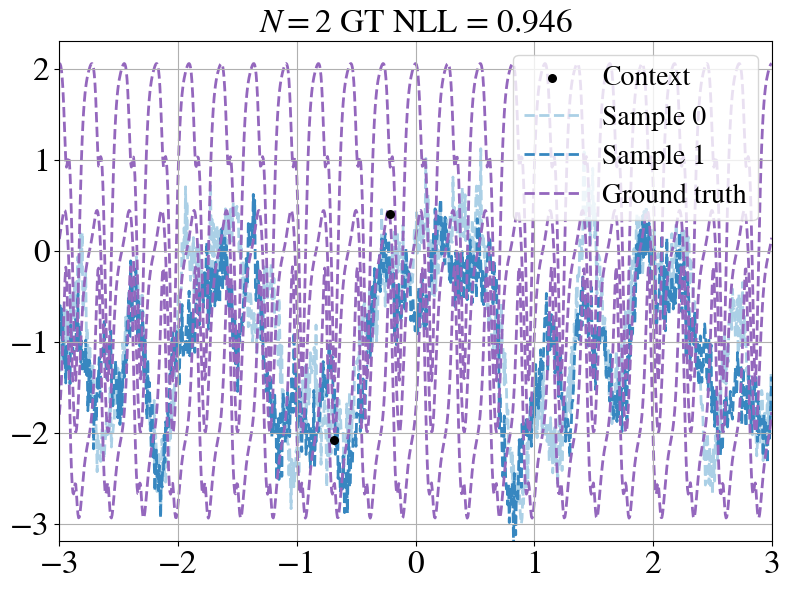

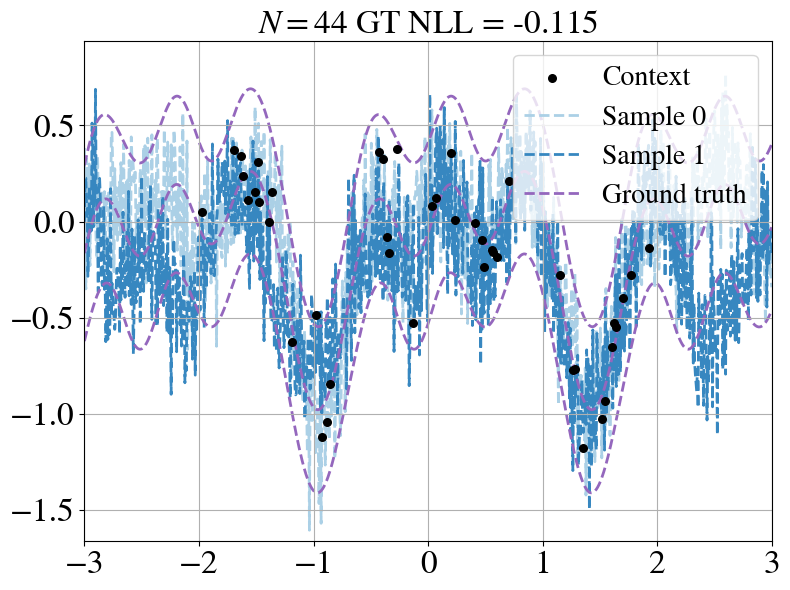

In [190]:
print("Samples from model with Gaussian head, 1 layer")
for i, batch in enumerate(gen_test):
    plot_samples(
            model=model,
            scheduler=scheduler,
            batch=batch,
            num_samples=2,
        )
    if i > 5:
        break

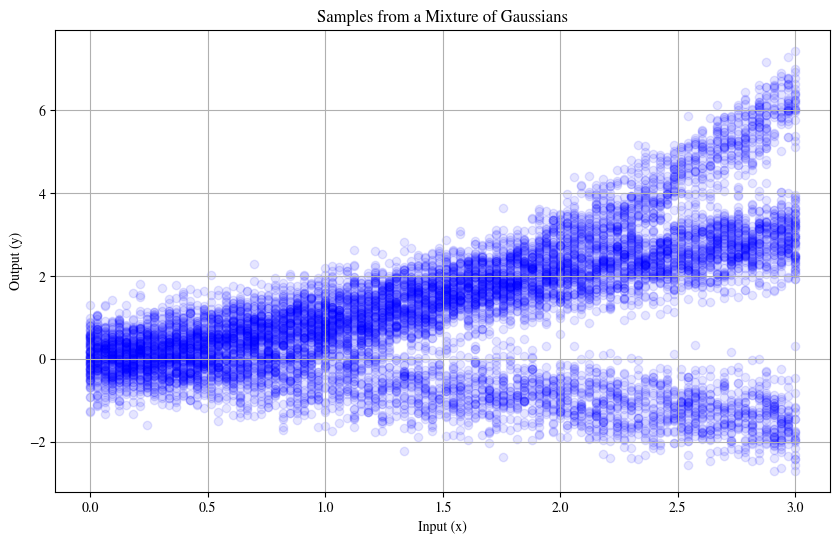

In [15]:
import numpy as np
import matplotlib.pyplot as plt

def sample_mixture_of_gaussians(x, num_samples=1000):
    # Define the weights for the mixture components
    weights = [0.25, 0.5, 0.25]

    # Allocate space for the samples
    y_samples = np.zeros(num_samples)

    for i in range(num_samples):
        # Randomly select a component based on the weights
        component = np.random.choice([0, 1, 2], p=weights)
        
        if component == 0:
            mean = 0.7*x**2
        elif component == 1:
            mean = x
        elif component == 2:
            mean = -0.5*x
        
        # Generate a sample from the selected Gaussian component
        y_samples[i] = np.random.normal(mean, 0.5)

    return y_samples

# Define the range of inputs (x values)
x_values = np.linspace(0, 3, 100)
num_samples_per_x = 100

# Generate samples for each x value
all_samples = []
for x in x_values:
    y_samples = sample_mixture_of_gaussians(x, num_samples_per_x)
    all_samples.append((x, y_samples))

# Plot the samples
plt.figure(figsize=(10, 6))
for x, y_samples in all_samples:
    plt.scatter([x] * num_samples_per_x, y_samples, alpha=0.1, color='blue')

plt.title('Samples from a Mixture of Gaussians')
plt.xlabel('Input (x)')
plt.ylabel('Output (y)')
plt.grid(True)
plt.show()

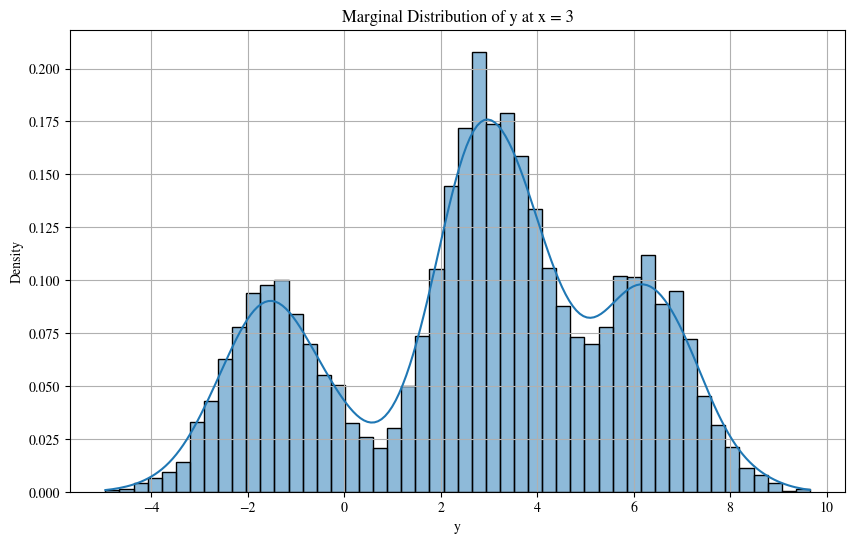

In [20]:
def sample_mixture_of_gaussians(x, num_samples=1000):
    # Define the weights for the mixture components
    weights = [0.25, 0.5, 0.25]

    # Allocate space for the samples
    y_samples = np.zeros(num_samples)

    for i in range(num_samples):
        # Randomly select a component based on the weights
        component = np.random.choice([0, 1, 2], p=weights)
        
        if component == 0:
            mean = 0.7*x**2
        elif component == 1:
            mean = x
        elif component == 2:
            mean = -0.5*x
        
        # Generate a sample from the selected Gaussian component
        y_samples[i] = np.random.normal(mean, 1.0)

    return y_samples

# Define a specific x value
x_specific = 3
num_samples = 10000

# Generate samples for the specific x value
y_samples = sample_mixture_of_gaussians(x_specific, num_samples)

# Plot the histogram and density plot of the samples
plt.figure(figsize=(10, 6))
sns.histplot(y_samples, bins=50, kde=True, stat='density')
plt.title(f'Marginal Distribution of y at x = {x_specific}')
plt.xlabel('y')
plt.ylabel('Density')
plt.grid(True)
plt.show()

### Plot marginal distributions

In [18]:
for i, batch_iter in enumerate(gen_test):
    if batch_iter.xc.shape[1]==1:
        batch=batch_iter
print(batch.xc.shape)

torch.Size([16, 1, 1])


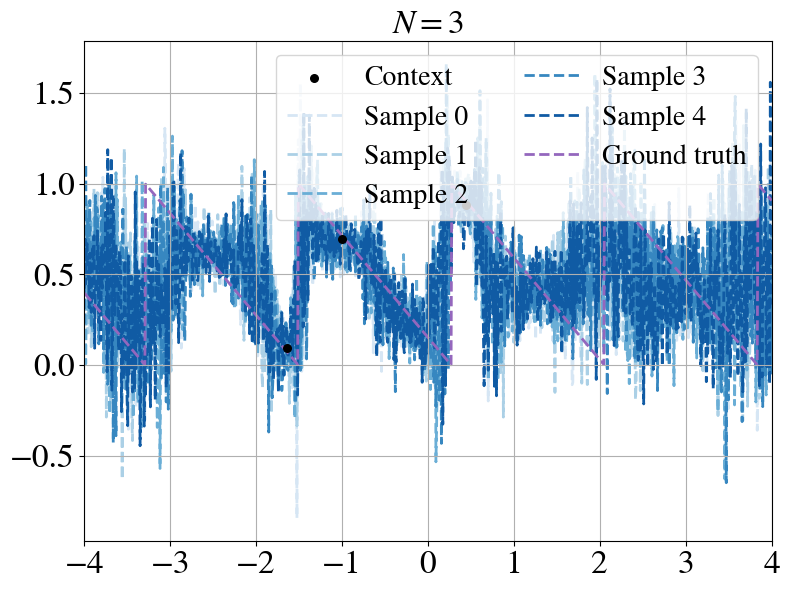

In [147]:
# 0 layers
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

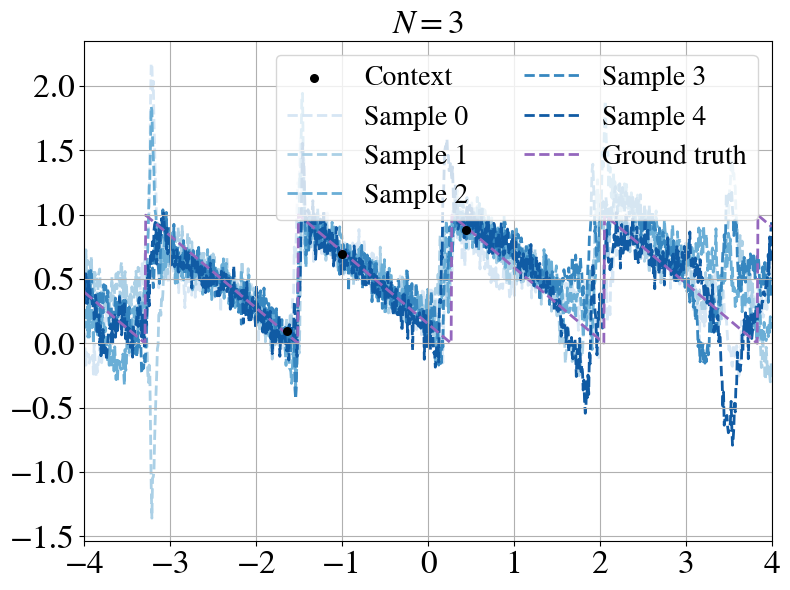

In [113]:
# 0 layers, cov
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

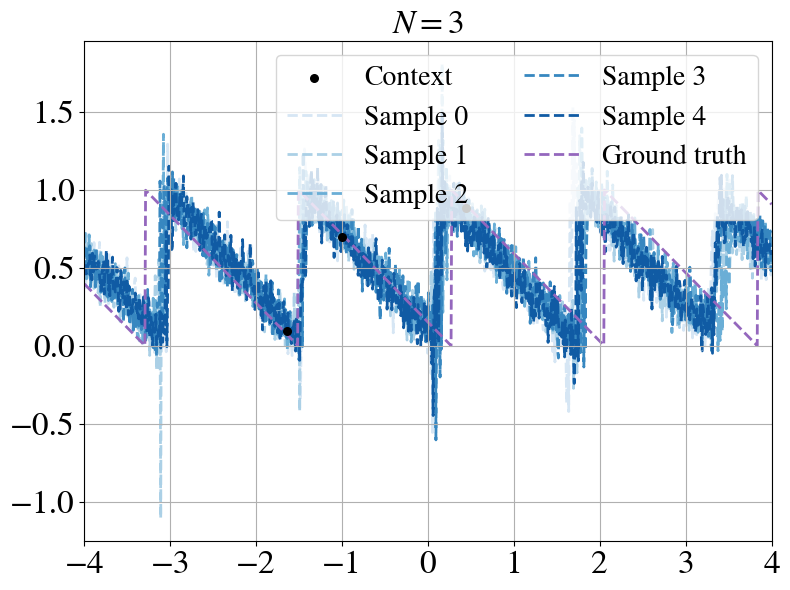

In [150]:
# 1 layer, beta 0.03
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

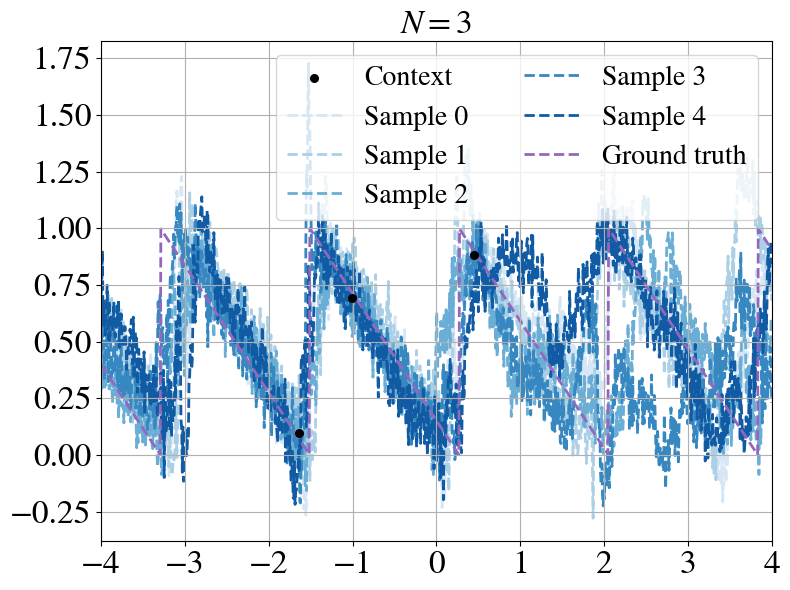

In [117]:
# 1 layer, cov, beta 0.03
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

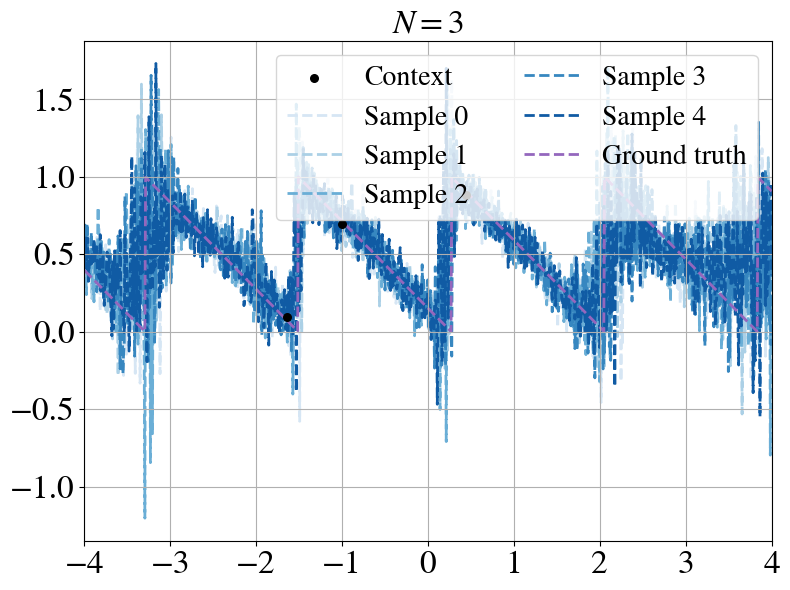

In [134]:
# TE 0 layers
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

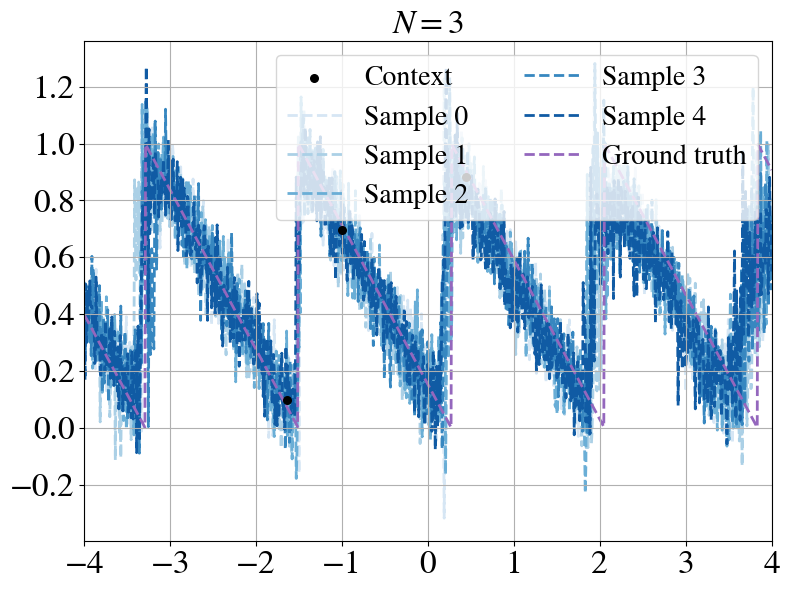

In [8]:
# TE 1 layer, 0.03
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 5

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

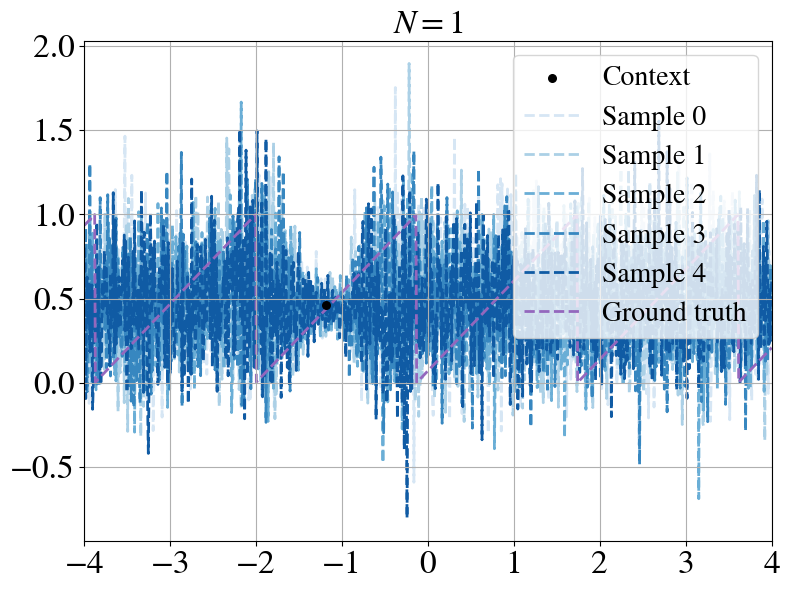

In [138]:
# 0 layers
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

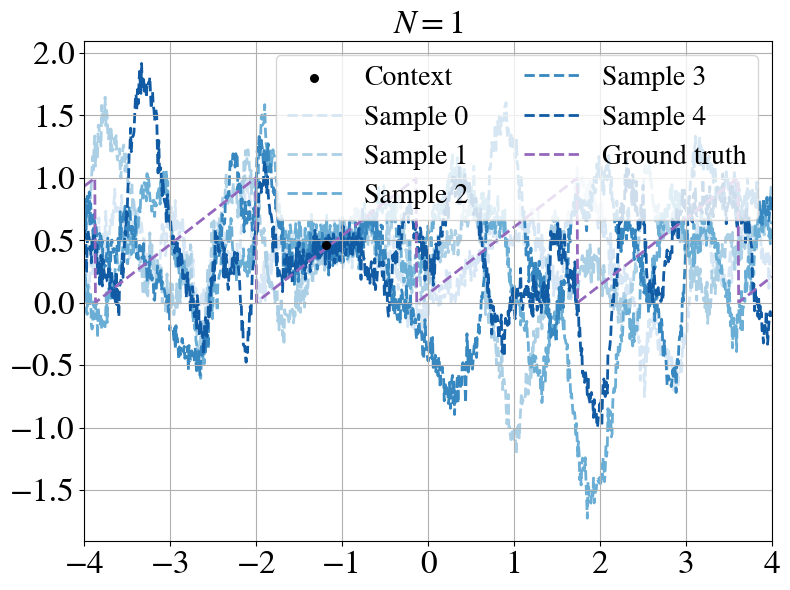

In [19]:
# 0 layers, cov
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000
x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
            batch.xc
        )[None, :, None]

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

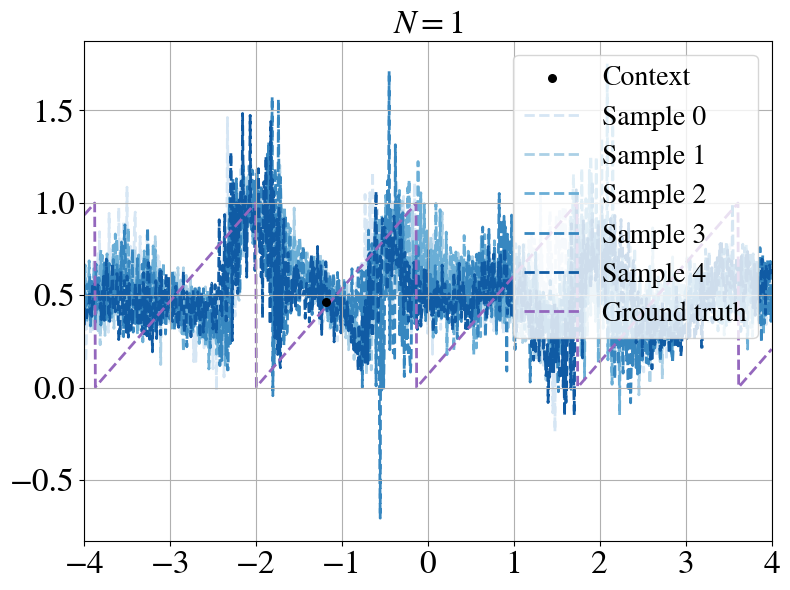

In [132]:
# 1 layer, beta 0.03
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

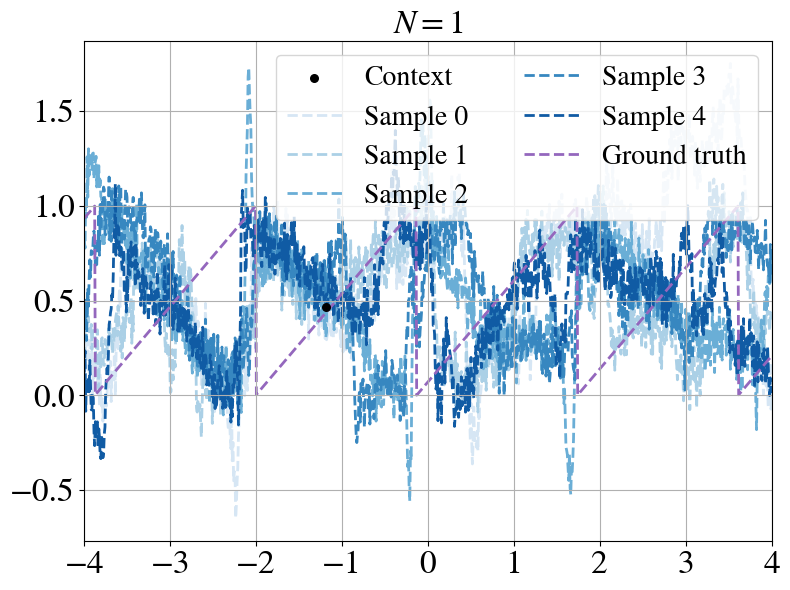

In [123]:
# 1 layer, cov, beta 0.03
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

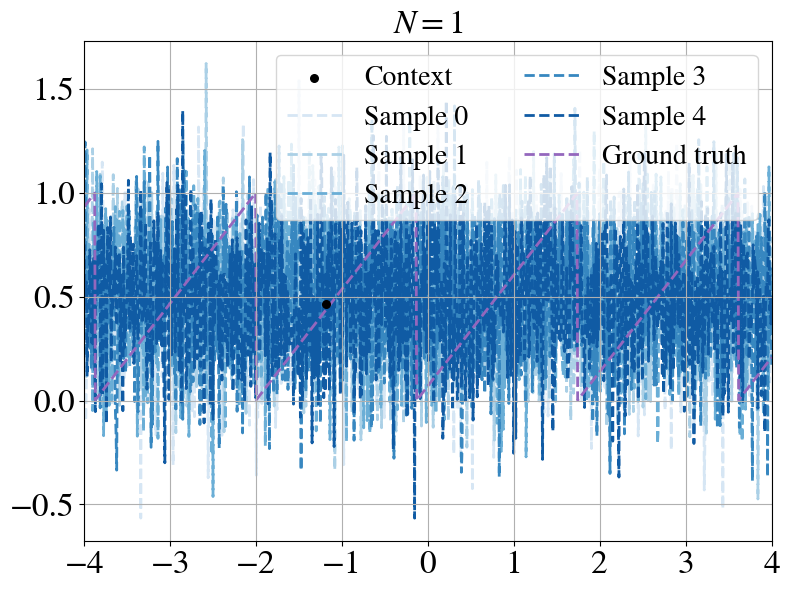

In [131]:
# TE, 0 layers
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 2000

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

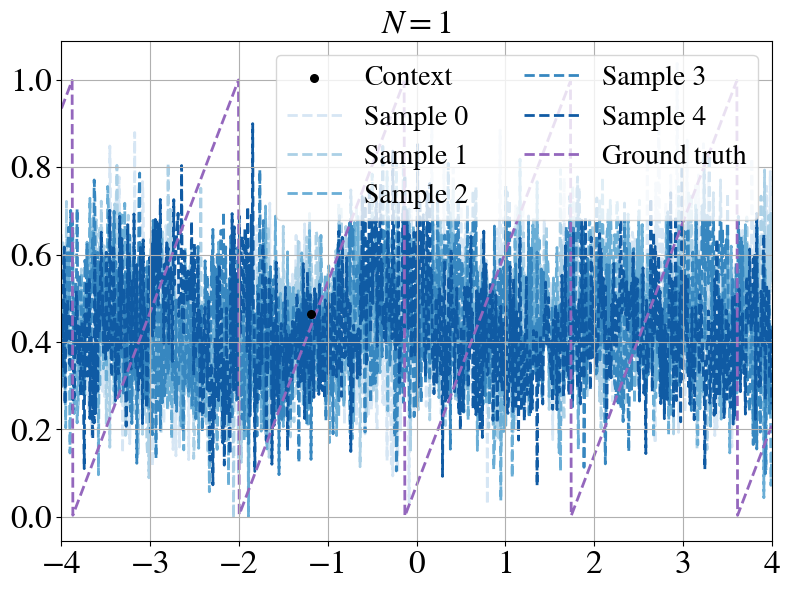

In [10]:
# TE, 1 layer, 0.03
x_range = (-4.0, 4.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 5

pred = plot_samples(
    model=model,
    scheduler=scheduler,
    batch=batch,
    figsize=(8.0, 6.0),
    x_range=(-4.0, 4.0),
    points_per_dim=points_per_dim,
    num_samples=num_samples,
    num_samples_plot=5,
)

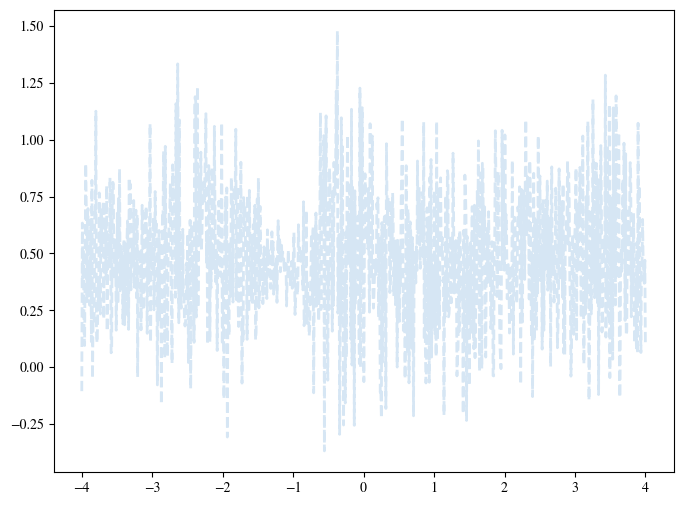

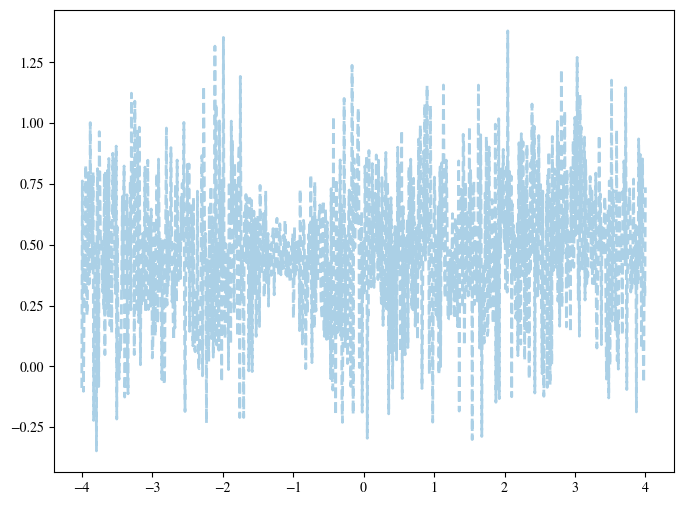

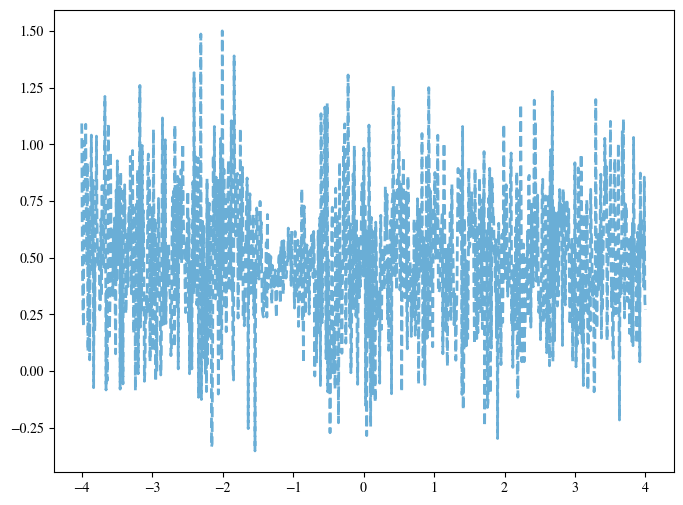

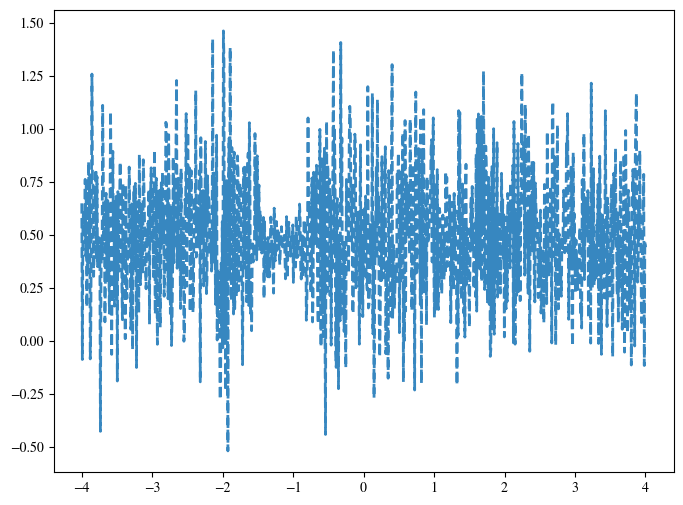

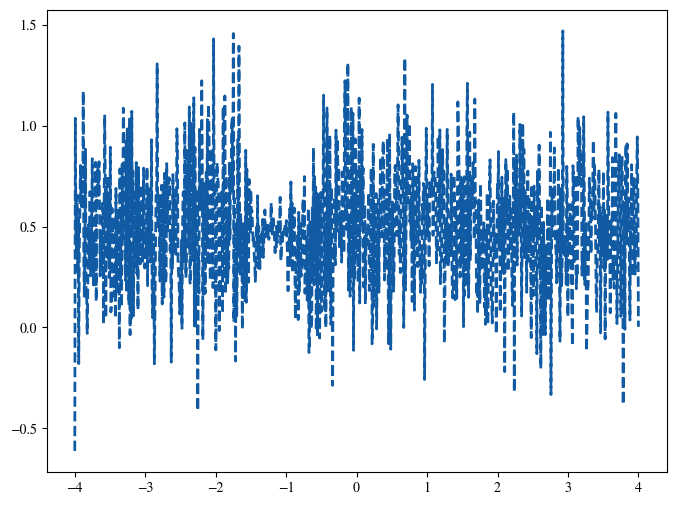

In [139]:
# 0 layers
num_samples_plot = 5
colors = iter(list(sns.color_palette("Blues", num_samples_plot)))
for i in range(num_samples_plot):
    fig = plt.figure(figsize = (8.0, 6.0))
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[i+10, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
title_str = f"$N = {xc.shape[1]}$"  

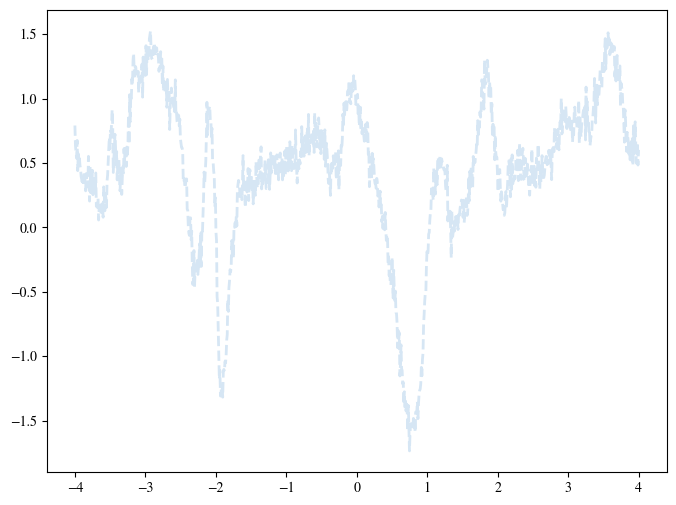

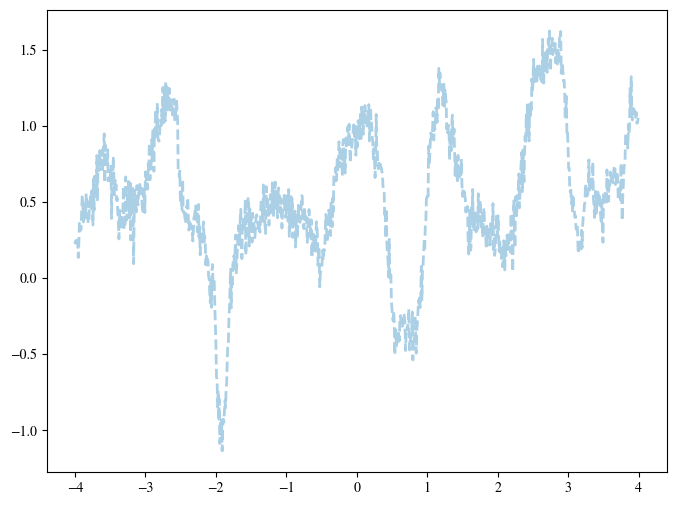

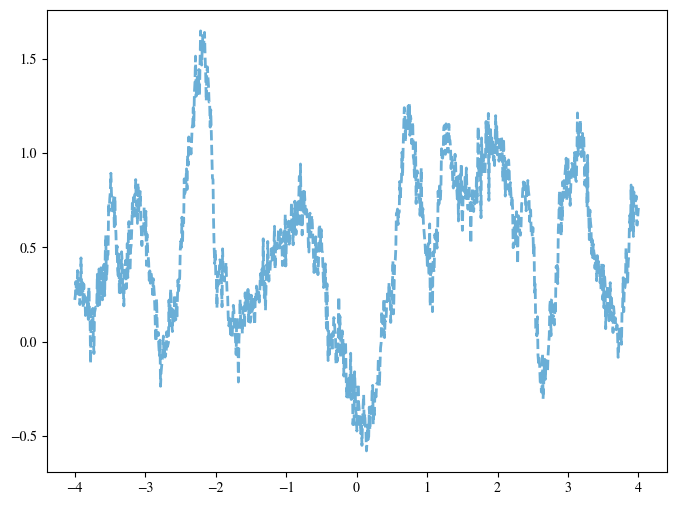

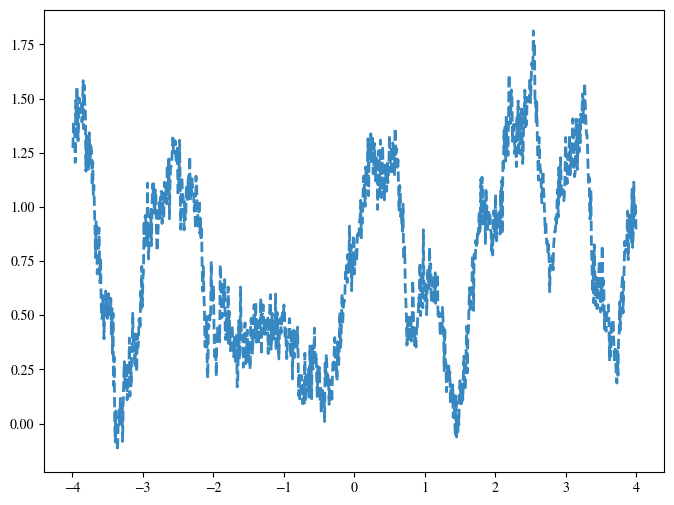

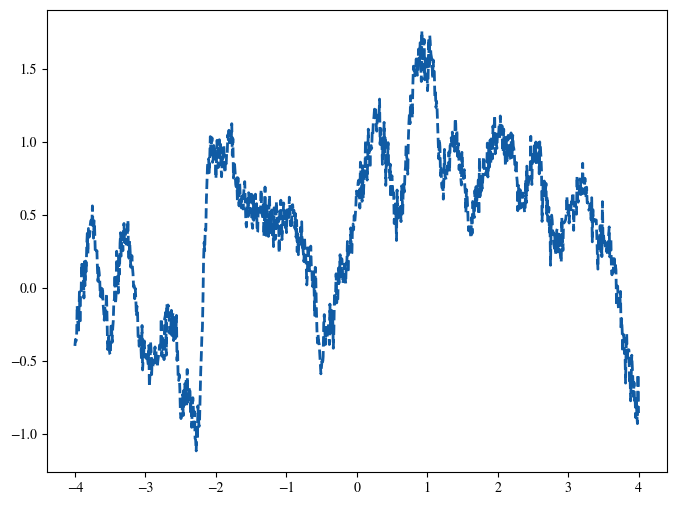

In [21]:
# 0 layers, cov
num_samples_plot = 5
colors = iter(list(sns.color_palette("Blues", num_samples_plot)))
for i in range(num_samples_plot):
    fig = plt.figure(figsize = (8.0, 6.0))
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[i+10, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )

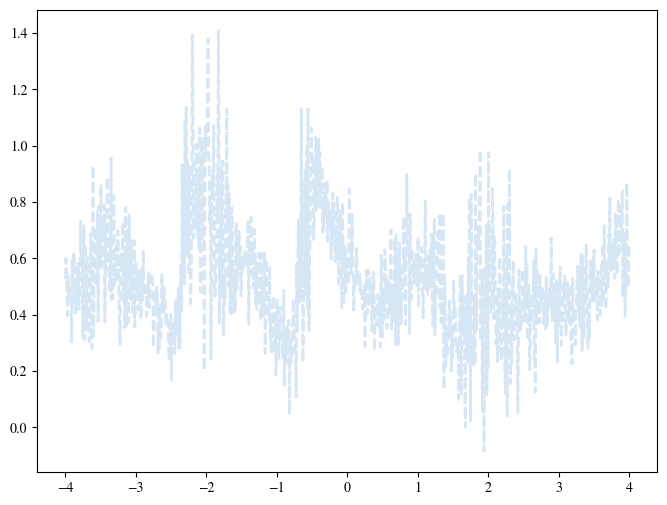

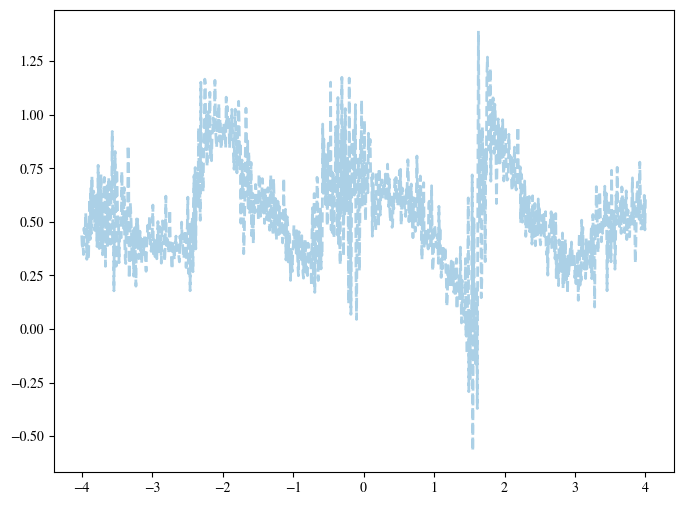

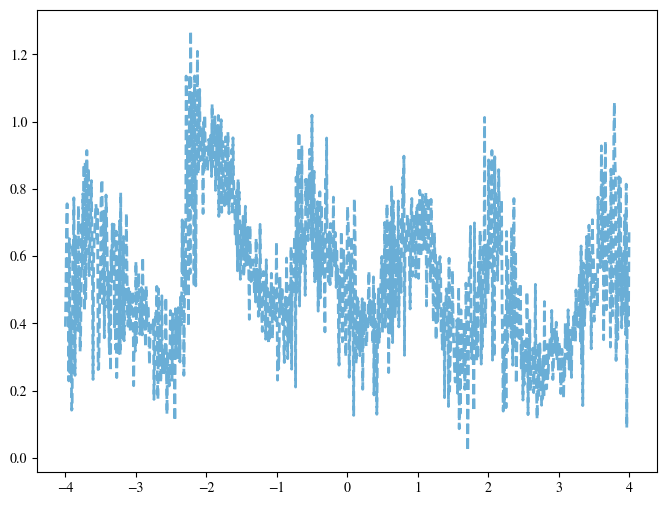

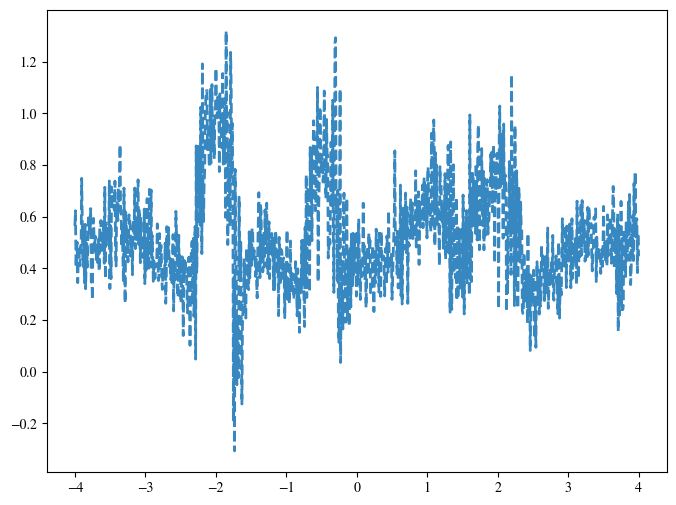

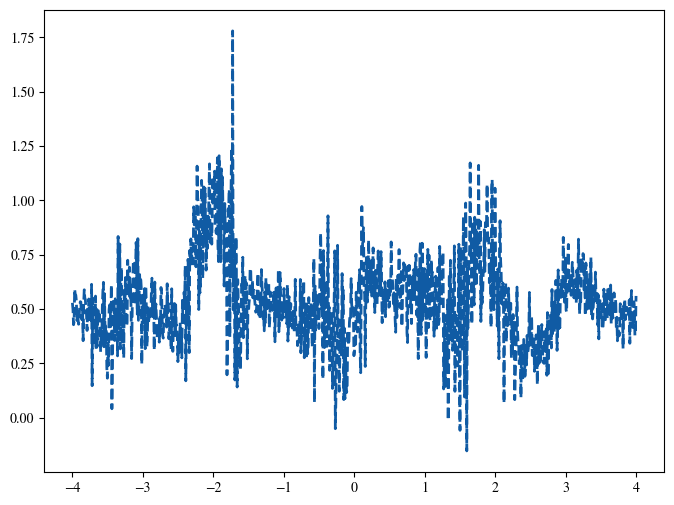

In [135]:
# 1 layer, beta 0.03
num_samples_plot = 5
colors = iter(list(sns.color_palette("Blues", num_samples_plot)))
for i in range(num_samples_plot):
    fig = plt.figure(figsize = (8.0, 6.0))
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[i+10, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
title_str = f"$N = {xc.shape[1]}$"  

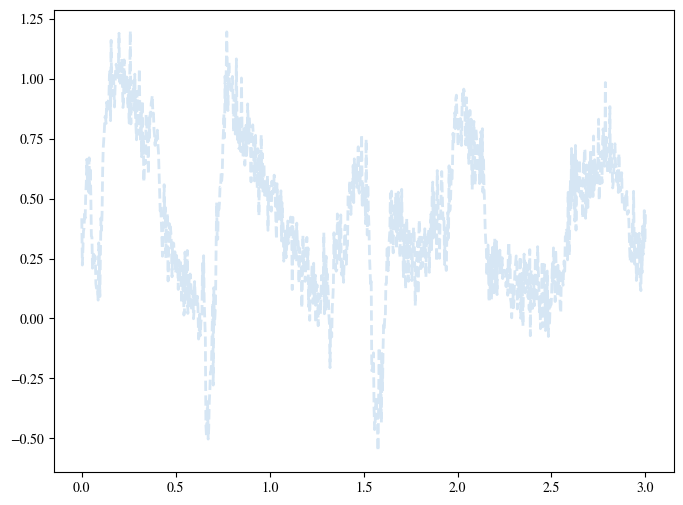

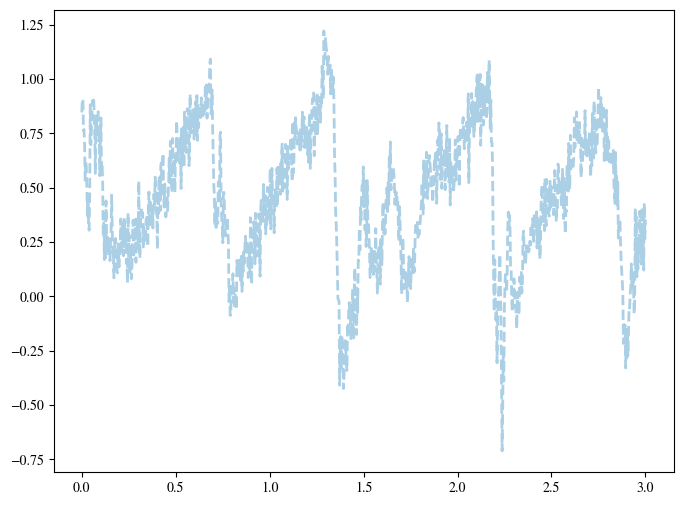

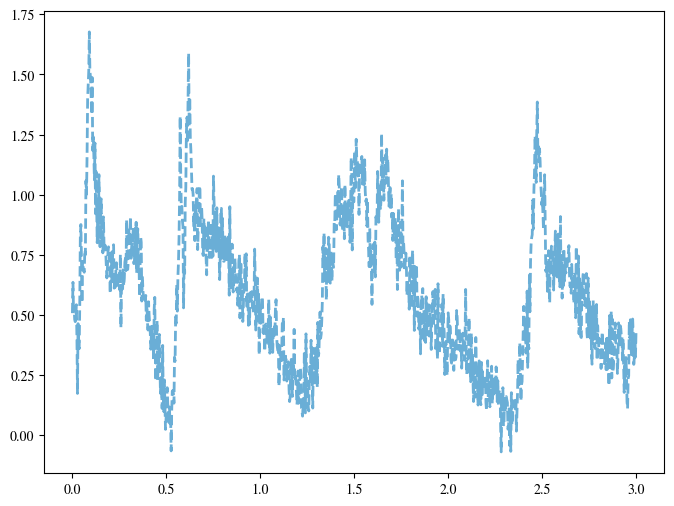

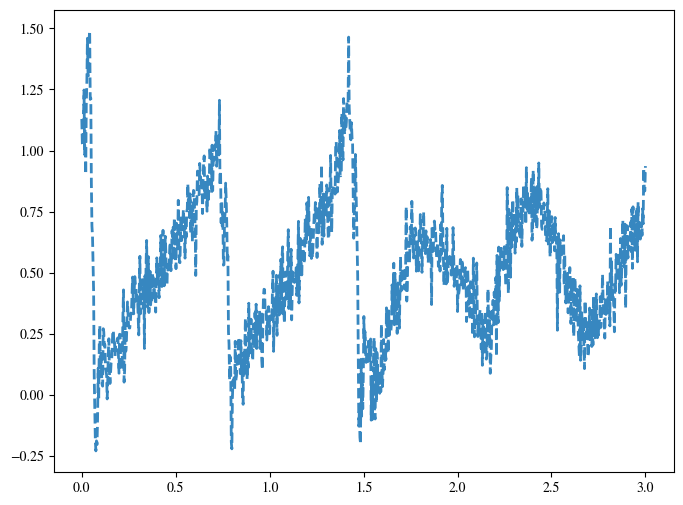

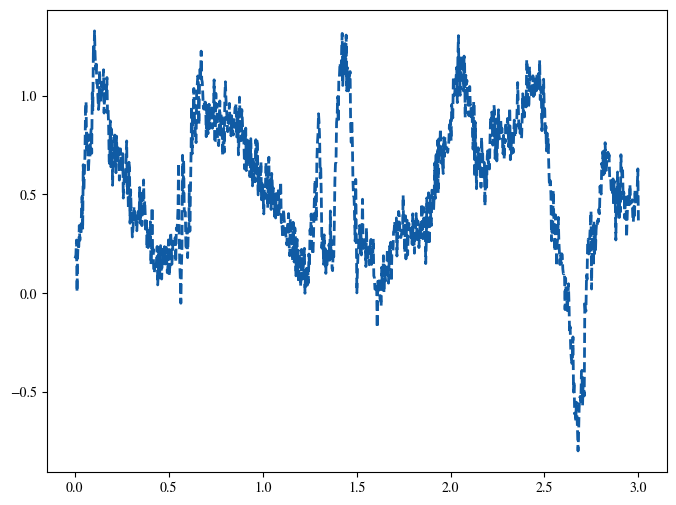

In [125]:
# 1 layer, cov, beta 0.03
num_samples_plot = 5
colors = iter(list(sns.color_palette("Blues", num_samples_plot)))
for i in range(num_samples_plot):
    fig = plt.figure(figsize = (8.0, 6.0))
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[i+10, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
title_str = f"$N = {xc.shape[1]}$"  

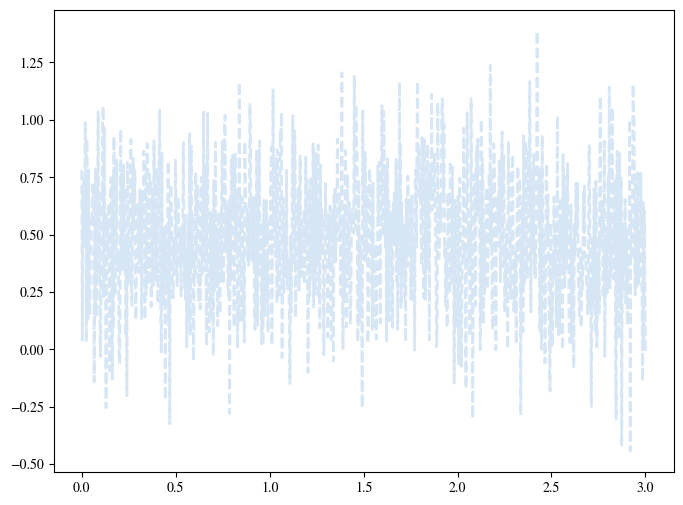

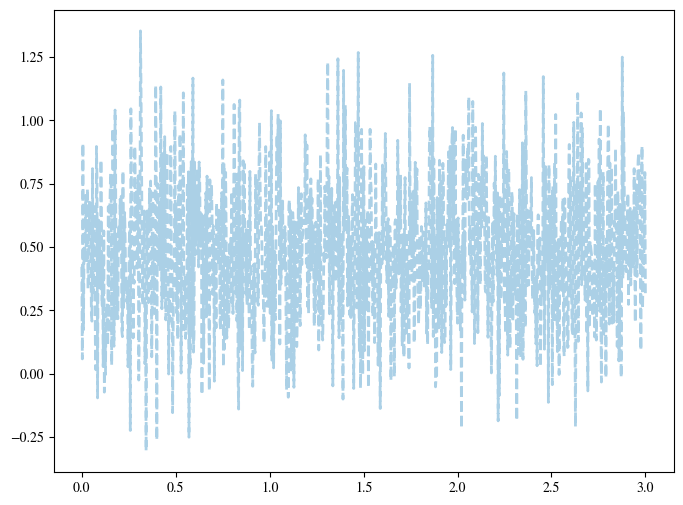

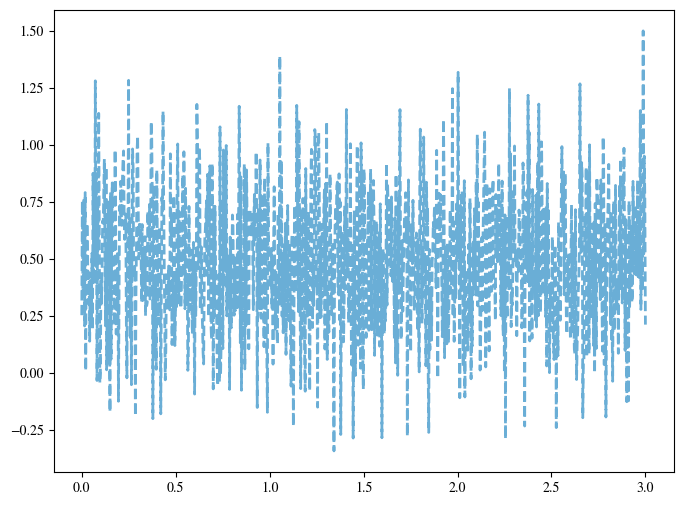

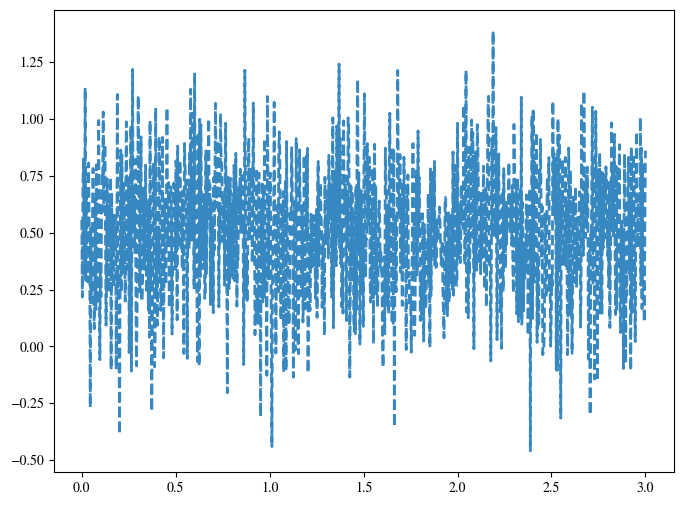

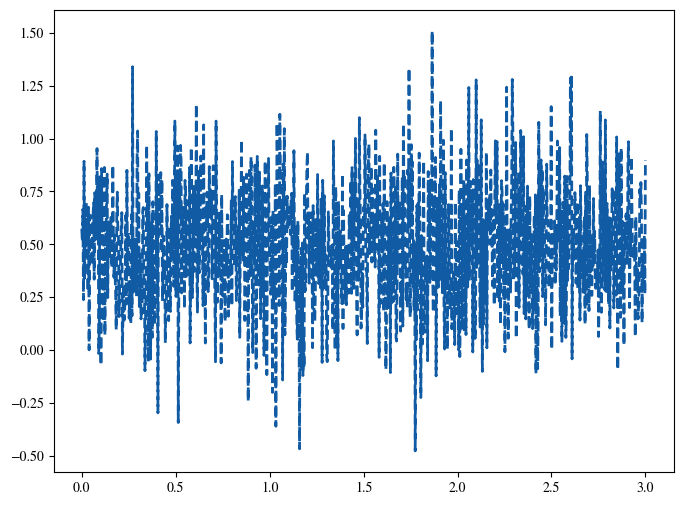

In [132]:
# TE 0 layers
num_samples_plot = 5
colors = iter(list(sns.color_palette("Blues", num_samples_plot)))
for i in range(num_samples_plot):
    fig = plt.figure(figsize = (8.0, 6.0))
    plt.plot(
        x_plot[0, :, 0].cpu(),
        pred.squeeze(-1)[i+10, :].cpu(),
        c=next(colors),
        lw=2,
        zorder=0,
        label=f"Sample {i}",
        linestyle="--",
    )
title_str = f"$N = {xc.shape[1]}$"  

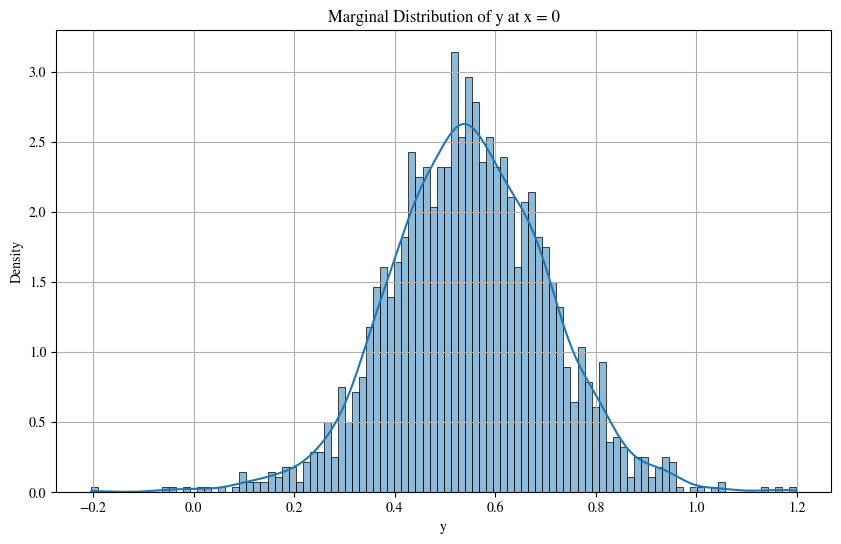

In [121]:
# Plot the histogram and density plot of the samples
x_specific = 0
# Compute the absolute difference
diff = torch.abs(x_plot - x_specific)
# Find the index of the minimum value along axis 1
idx = torch.argmin(diff, dim=1)[0][0]

plt.figure(figsize=(10, 6))
sns.histplot(pred[:, idx], bins=100, kde=True, stat='density')
plt.title(f'Marginal Distribution of y at x = {x_specific}')
plt.xlabel('y')
plt.ylabel('Density')
plt.grid(True)
plt.show()

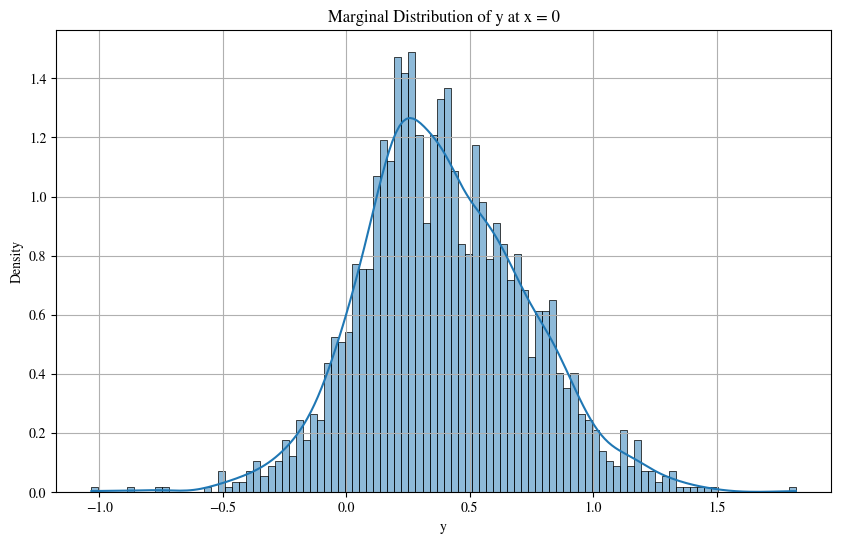

In [127]:
# Plot the histogram and density plot of the samples
x_specific = 0
# Compute the absolute difference
diff = torch.abs(x_plot - x_specific)
# Find the index of the minimum value along axis 1
idx = torch.argmin(diff, dim=1)[0][0]

plt.figure(figsize=(10, 6))
sns.histplot(pred[:, idx], bins=100, kde=True, stat='density')
plt.title(f'Marginal Distribution of y at x = {x_specific}')
plt.xlabel('y')
plt.ylabel('Density')
plt.grid(True)
plt.show()

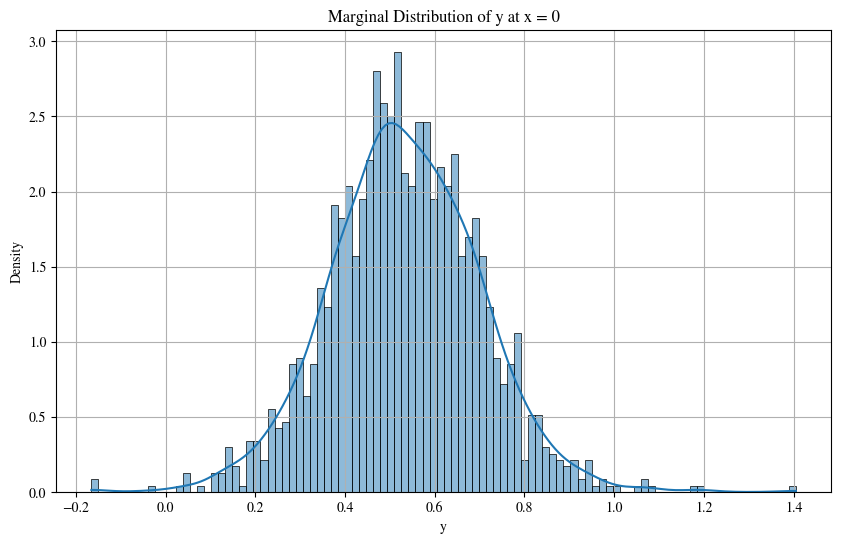

In [107]:
# Plot the histogram and density plot of the samples
x_specific = 0
# Compute the absolute difference
diff = torch.abs(x_plot - x_specific)
# Find the index of the minimum value along axis 1
idx = torch.argmin(diff, dim=1)[0][0]

plt.figure(figsize=(10, 6))
sns.histplot(pred[:, idx, 0], bins=100, kde=True, stat='density')
plt.title(f'Marginal Distribution of y at x = {x_specific}')
plt.xlabel('y')
plt.ylabel('Density')
plt.grid(True)
plt.show()

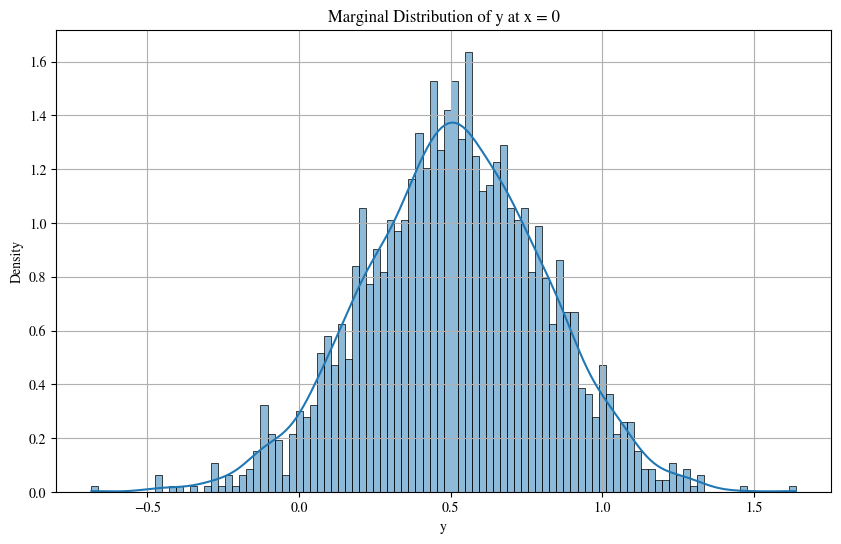

In [129]:
# Plot the histogram and density plot of the samples
x_specific = 0
# Compute the absolute difference
diff = torch.abs(x_plot - x_specific)
# Find the index of the minimum value along axis 1
idx = torch.argmin(diff, dim=1)[0][0]

plt.figure(figsize=(10, 6))
sns.histplot(pred[:, idx, 0], bins=100, kde=True, stat='density')
plt.title(f'Marginal Distribution of y at x = {x_specific}')
plt.xlabel('y')
plt.ylabel('Density')
plt.grid(True)
plt.show()

# Deterministic functions

In [68]:
@dataclass
class EvalConfig:
    run_path: str = 'cdd43/det-poly-1d/runs/sd0gwahw' # 0 layers
    # run_path: str = 'cdd43/det-poly-1d/runs/uy23eerx' # 1 layer, beta = 0.3
    run_path: str = 'cdd43/det-poly-1d/runs/dfmrdzdc' # 1 layer, beta = 0.5
    # run_path: str = 'cdd43/det-poly-1d/runs/pr8jp56g' # 2 layers, beta = 0.5
    config: str = 'experiments/configs/generators/det-poly-1d.yml'
    ckpt: str = 'last'

config_eval = omegaconf.OmegaConf.structured(EvalConfig)

In [22]:
@dataclass
class EvalConfig:
    run_path: str = 'cdd43/det-poly-1d/runs/qyhfx5m6' # 0 layers
    # run_path: str = 'cdd43/det-poly-1d/runs/vn7df1fs' # 3 layers, beta = 0.95
    # run_path: str = 'cdd43/det-poly-1d/runs/uonsjwne' # 5 layers, beta = 0.95
    run_path: str = 'cdd43/det-poly-1d/runs/x0jzwf63' # 3 layers, beta = 0.8
    # run_path: str = 'cdd43/det-poly-1d/runs/u6h3lijl' # 3 layers, beta = 0.7
    # run_path: str = 'cdd43/det-poly-1d/runs/atn9v664' # 3 layers, beta = 0.6
    run_path: str = 'cdd43/det-poly-1d/runs/ynbdqiyu' # 3 layers, beta = 0.6 to 0.8
    config: str = 'experiments/configs/generators/det-poly-1d.yml'
    ckpt: str = 'last'

config_eval = omegaconf.OmegaConf.structured(EvalConfig)

In [23]:
experiment = initialize_evaluation(config_eval)

model = experiment.model
scheduler = experiment.scheduler
eval_name = experiment.misc.eval_name
gen_test = experiment.generators.test
gen_train = experiment.generators.train

model.eval()

Global seed set to 0
Global seed set to 0


TimeConditionedNP(
  (neural_process): TNP(
    (encoder): TNPEncoder(
      (transformer_encoder): TNPTransformerEncoder(
        (mhca_layers): ModuleList(
          (0-4): 5 x MultiHeadCrossAttentionLayer(
            (attn): MultiHeadCrossAttention(
              (to_q): Linear(in_features=128, out_features=128, bias=False)
              (to_k): Linear(in_features=128, out_features=128, bias=False)
              (to_v): Linear(in_features=128, out_features=128, bias=False)
              (to_out): Sequential(
                (0): Linear(in_features=128, out_features=128, bias=True)
                (1): Dropout(p=0.0, inplace=False)
              )
            )
            (ff_block): Sequential(
              (0): Linear(in_features=128, out_features=128, bias=True)
              (1): ReLU()
              (2): Dropout(p=0.0, inplace=False)
              (3): Linear(in_features=128, out_features=128, bias=True)
              (4): Dropout(p=0.0, inplace=False)
            )
         

Predictions at layer 0 for model without Gaussian head, 0 layers


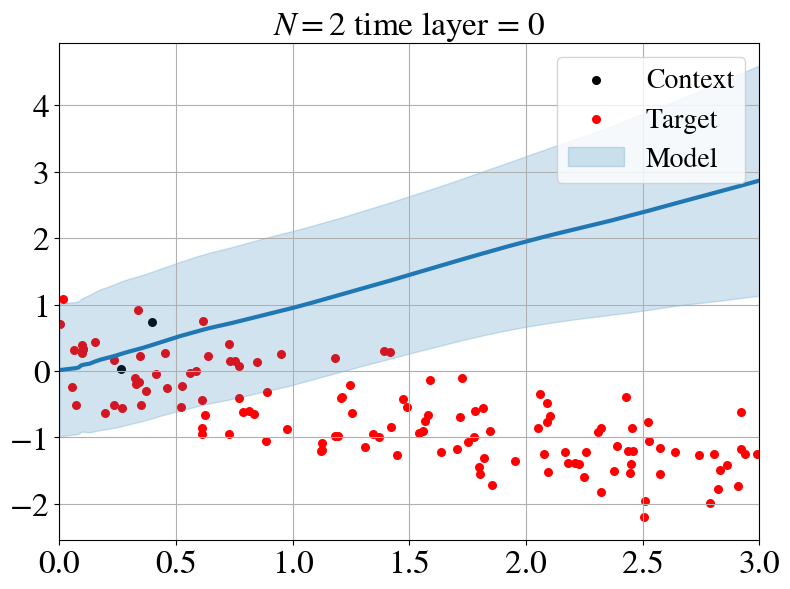

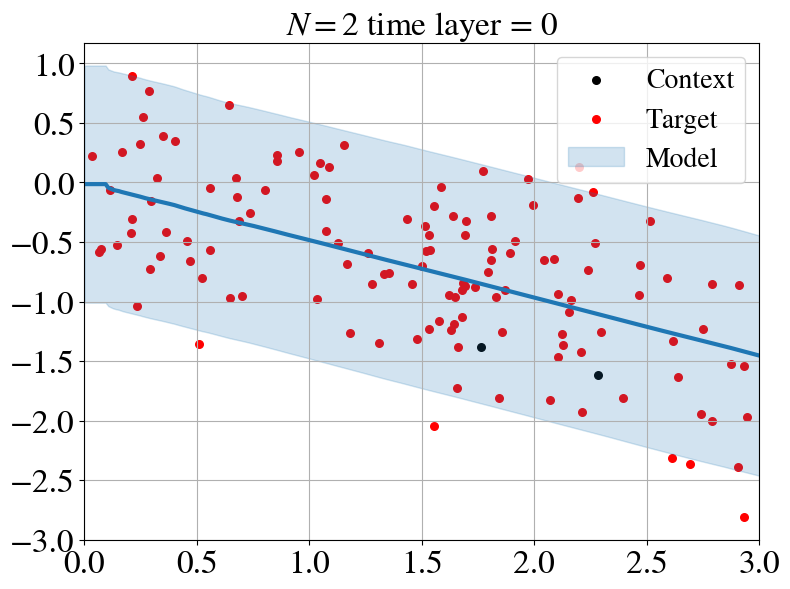

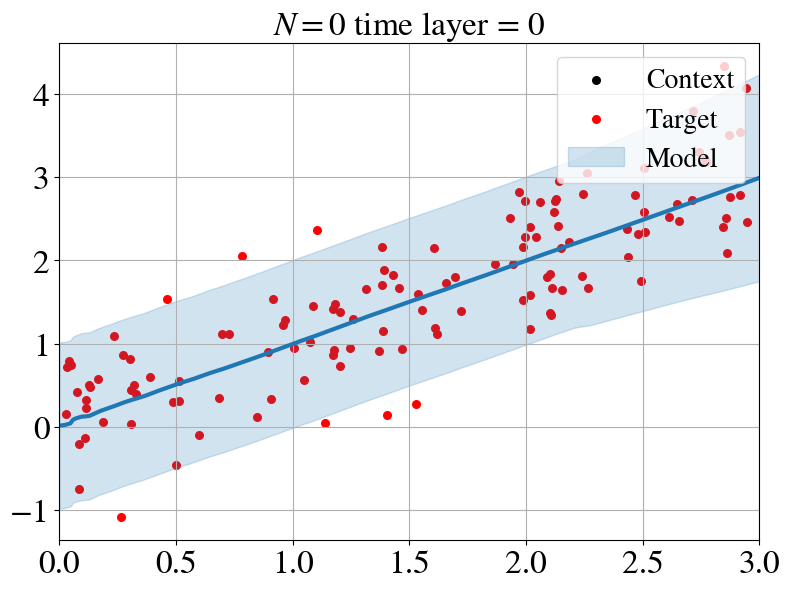

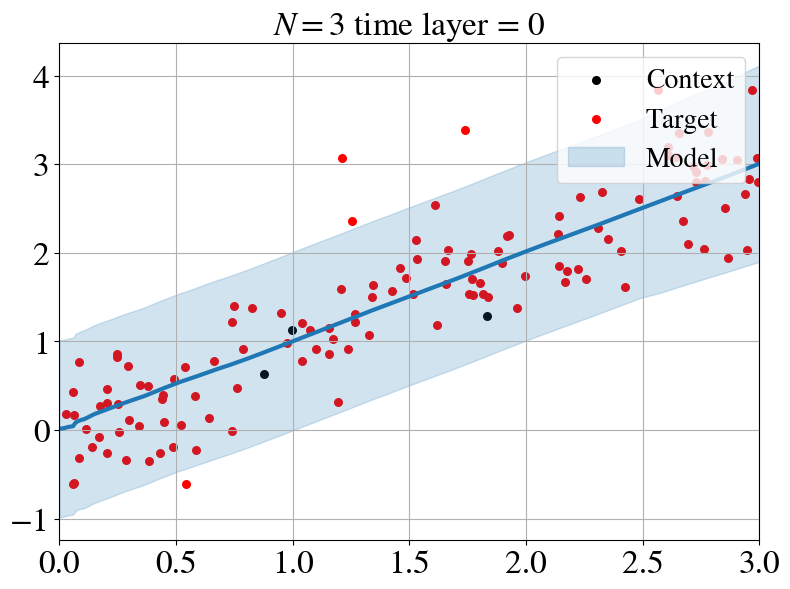

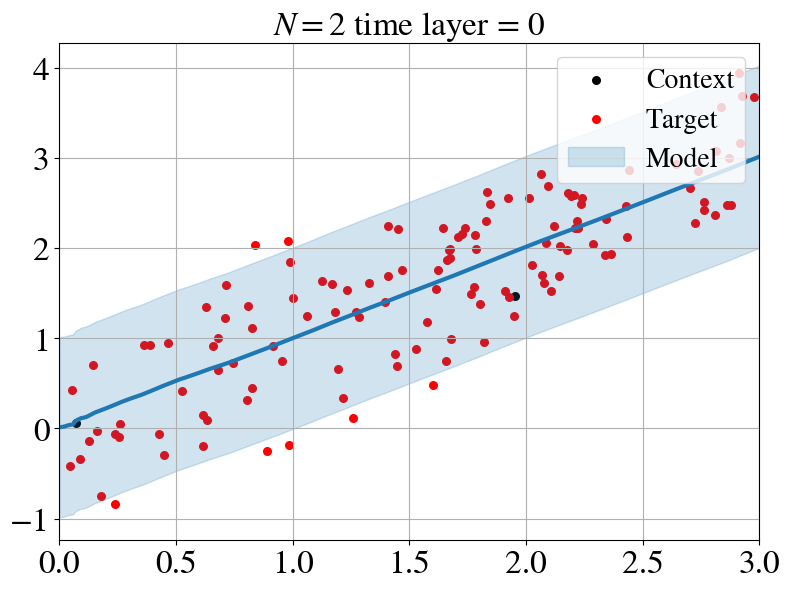

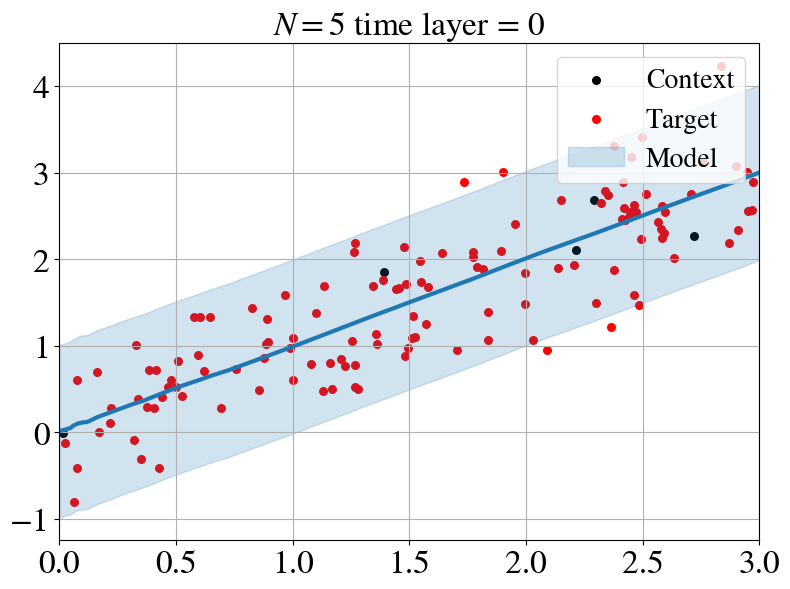

In [38]:
print("Predictions at layer 0 for model without Gaussian head, 0 layers")
for i, batch in enumerate(gen_test):
    plot(
            model=model,
            scheduler=scheduler,
            batch=batch,
            pred_fn=discrete_denoising_sampling,
            x_range = (0.0, 3.0),
        )
    if i > 5:
        break


Predictions at each layer for model without Gaussian head, 3 layers, beta 0.95


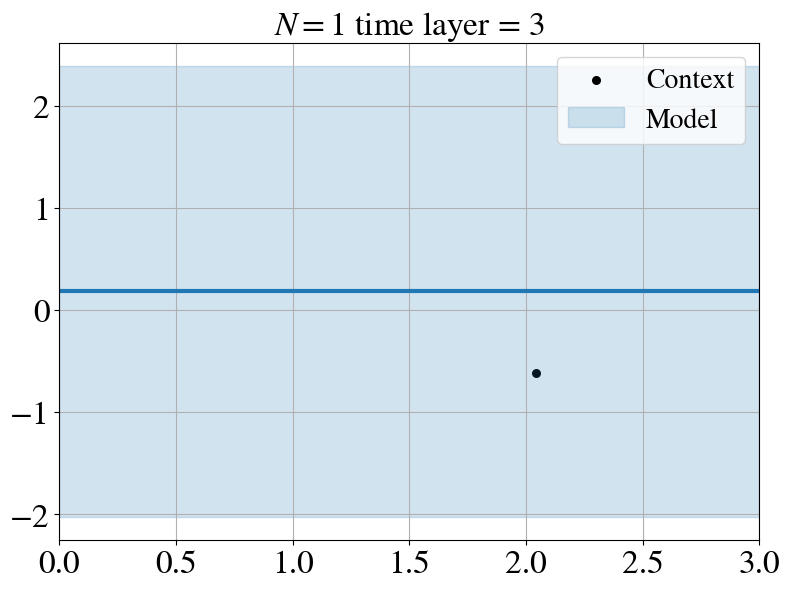

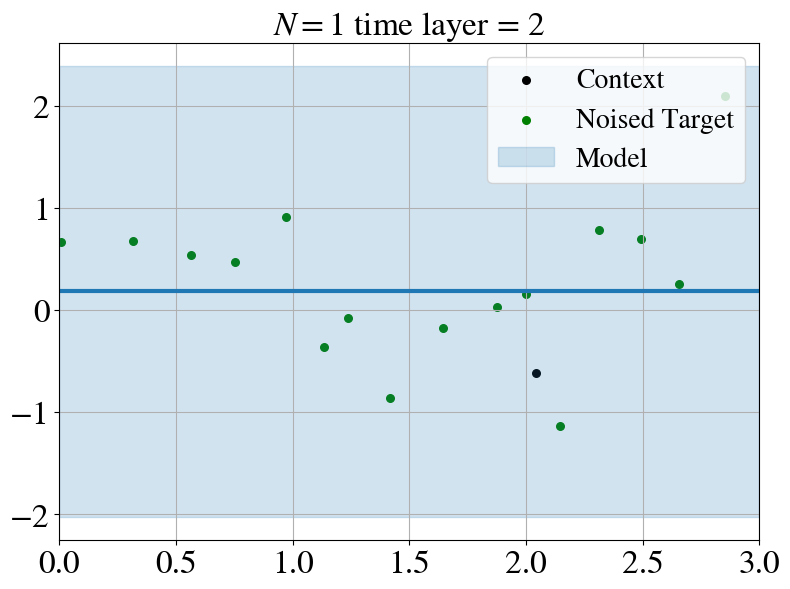

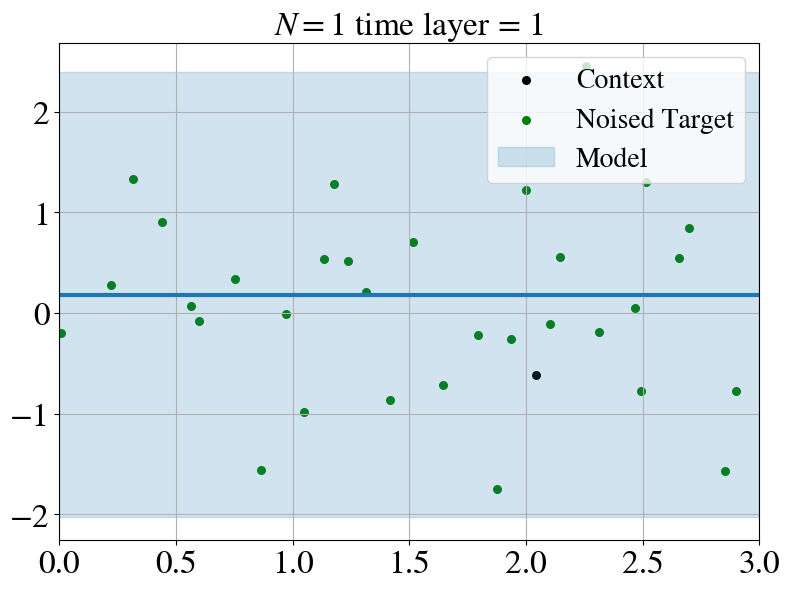

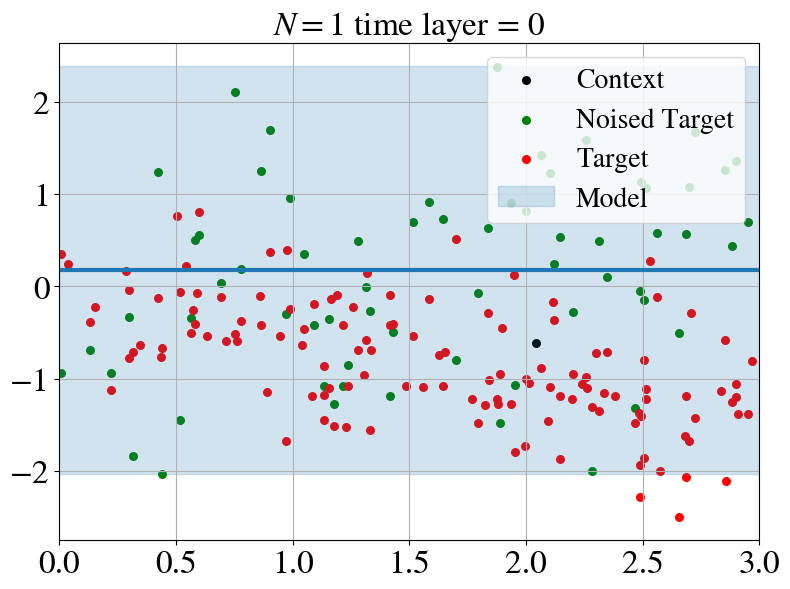

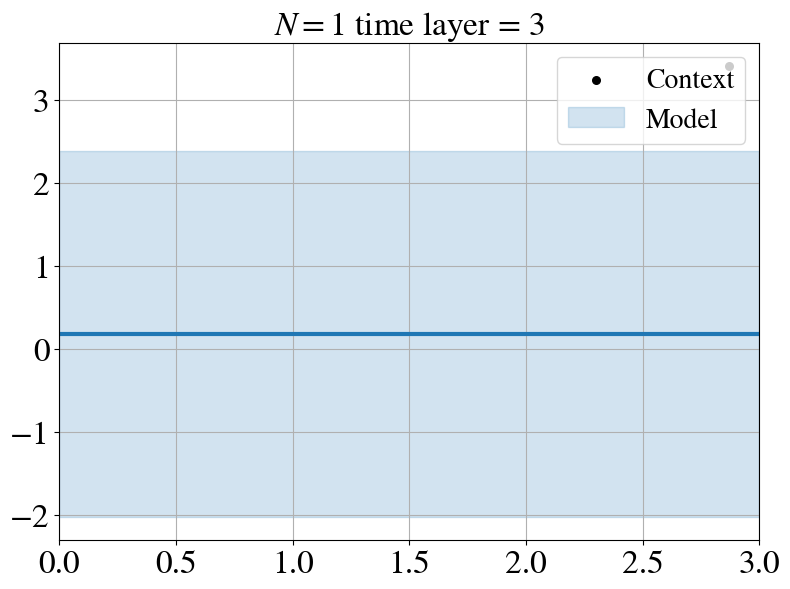

...

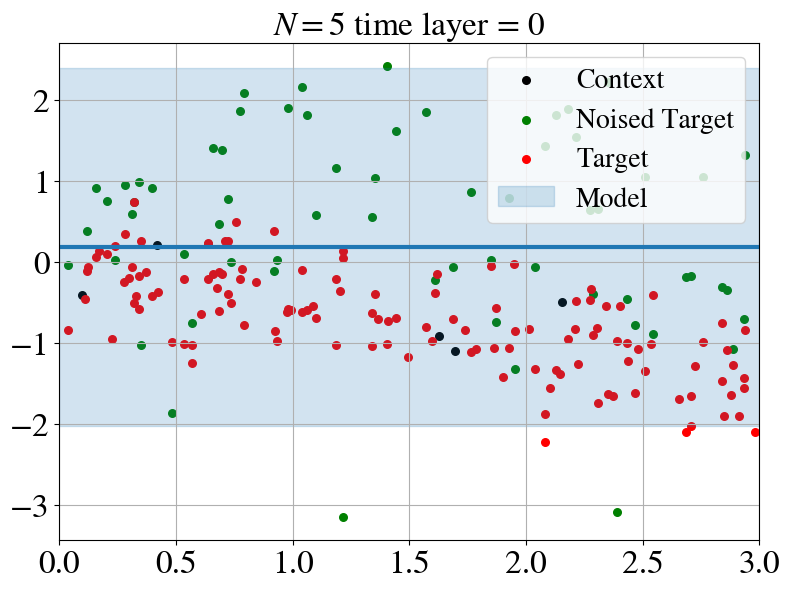

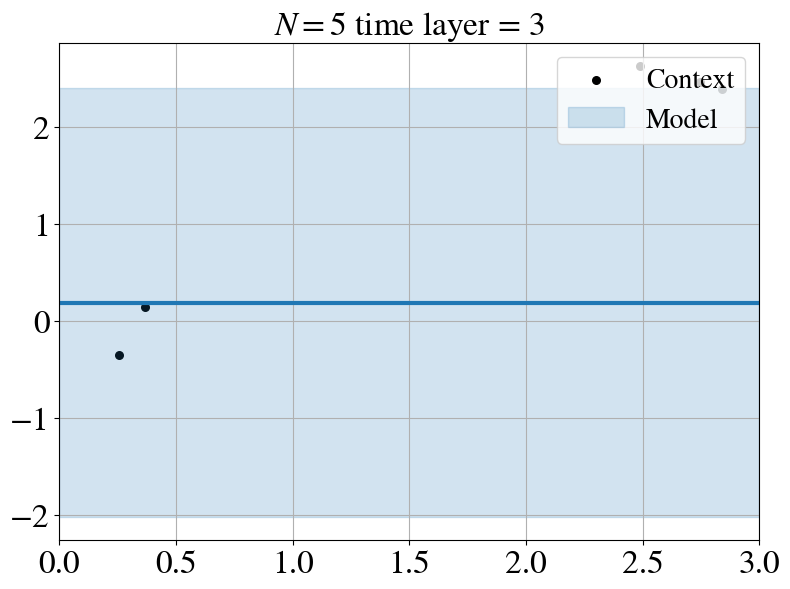

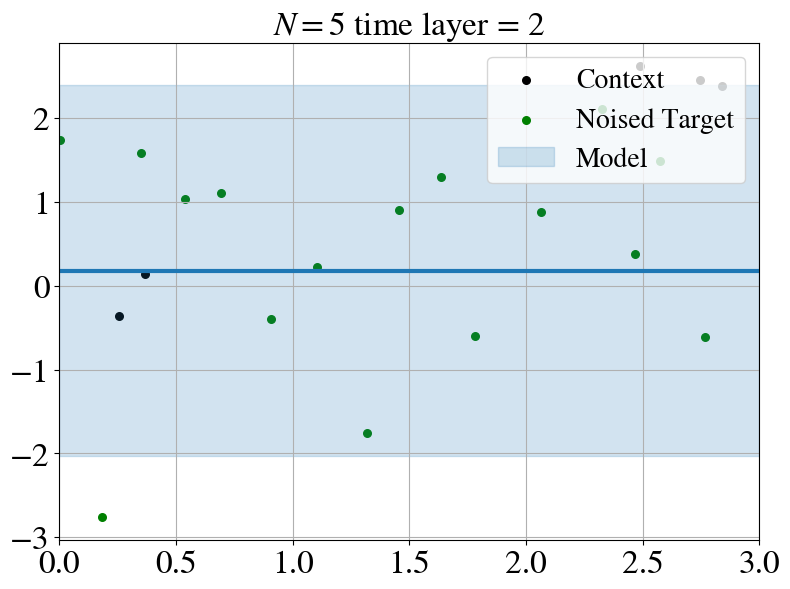

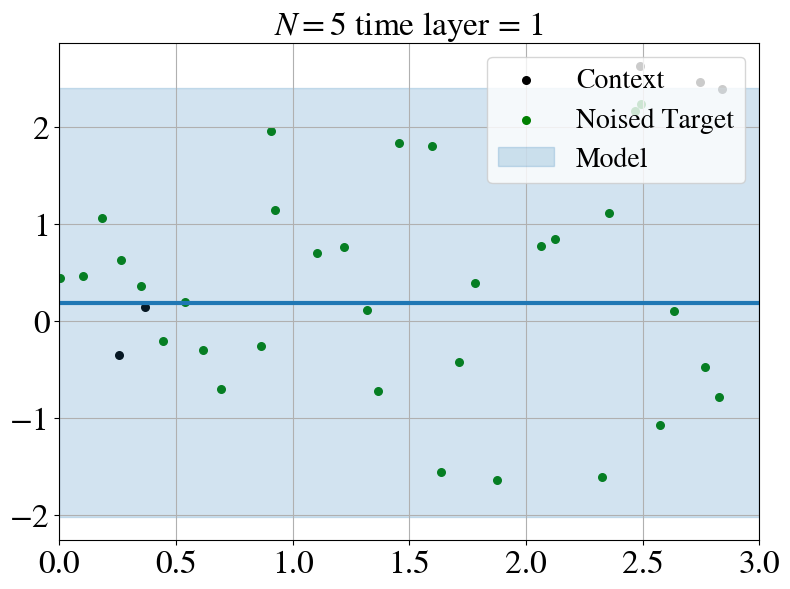

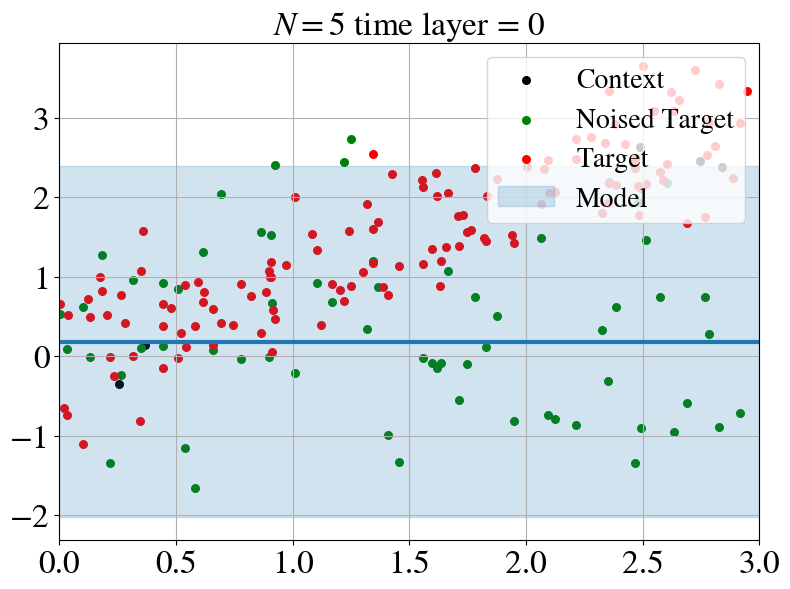

In [29]:
print("Predictions at each layer for model without Gaussian head, 3 layers, beta 0.95")
for i, batch in enumerate(gen_test):
    plot(
            model=model,
            scheduler=scheduler,
            batch=batch,
            pred_fn=discrete_denoising_sampling,
            x_range = (0.0, 3.0),
        )
    if i > 5:
        break


Predictions at each layer for model without Gaussian head, 3 layers, beta 0.8


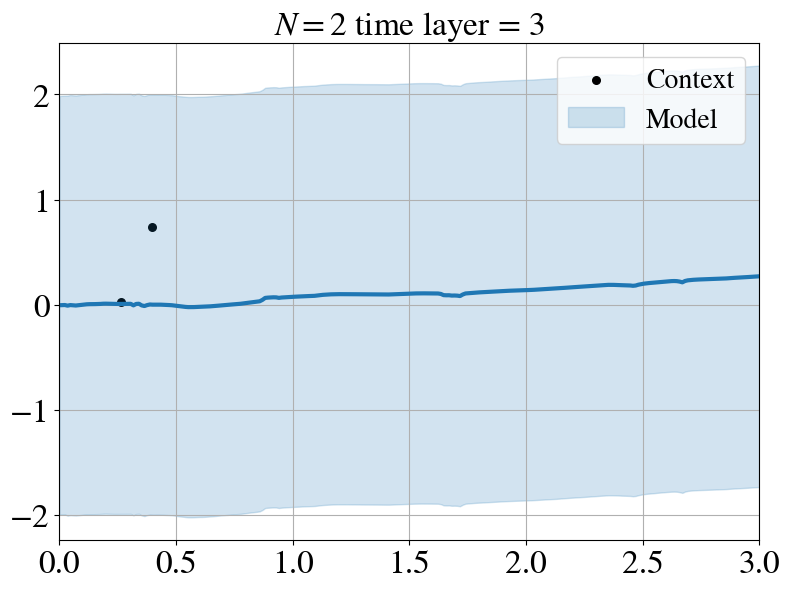

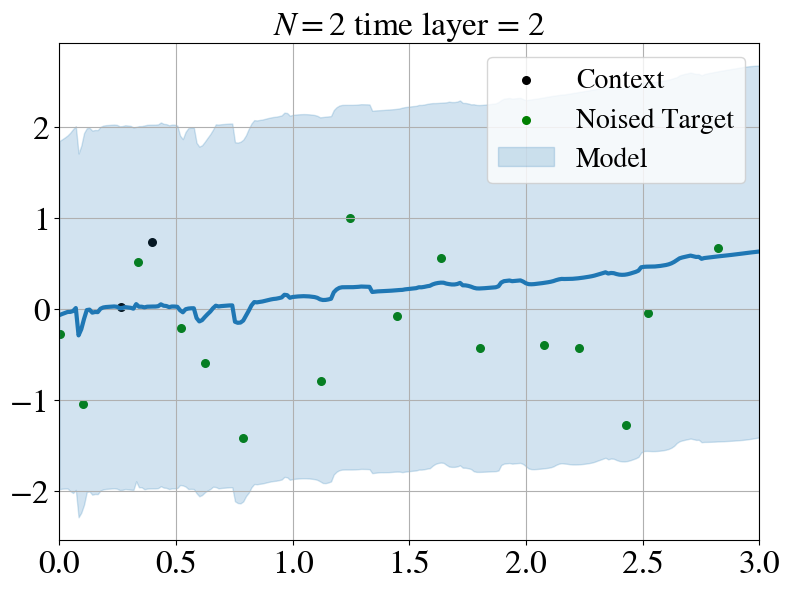

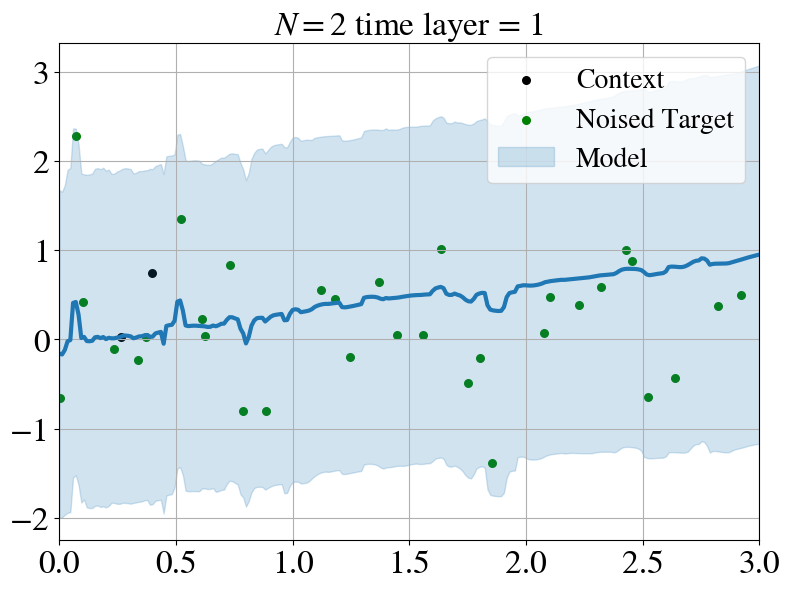

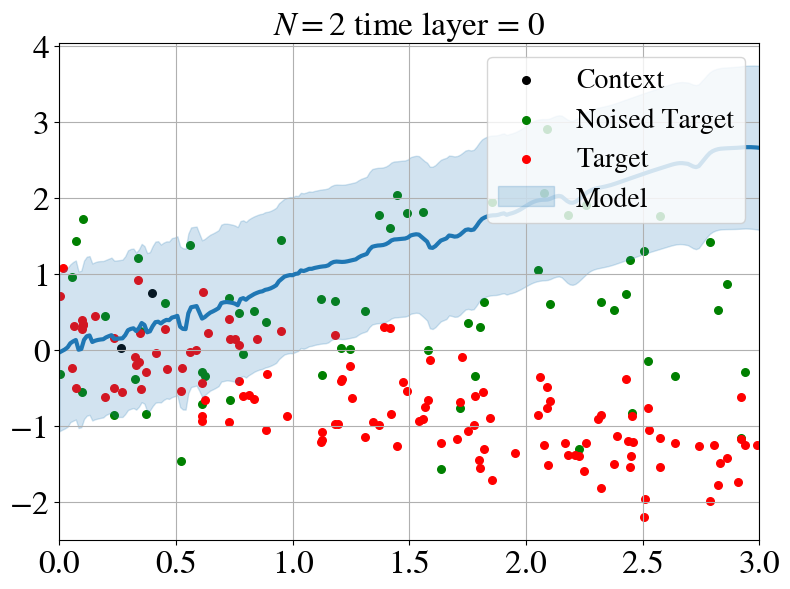

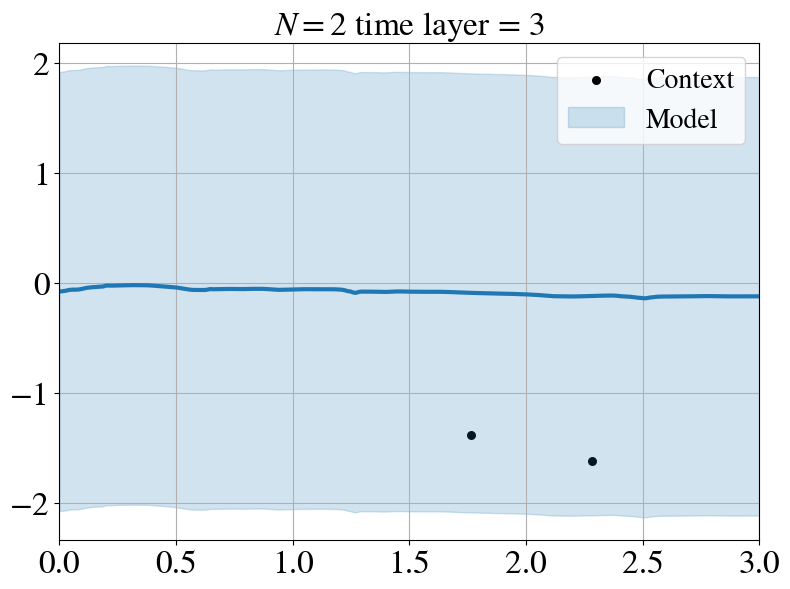

...

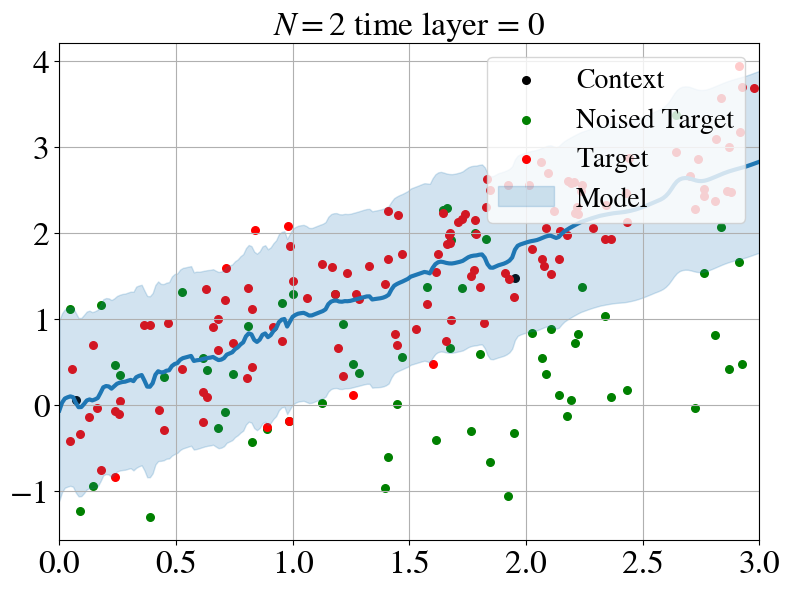

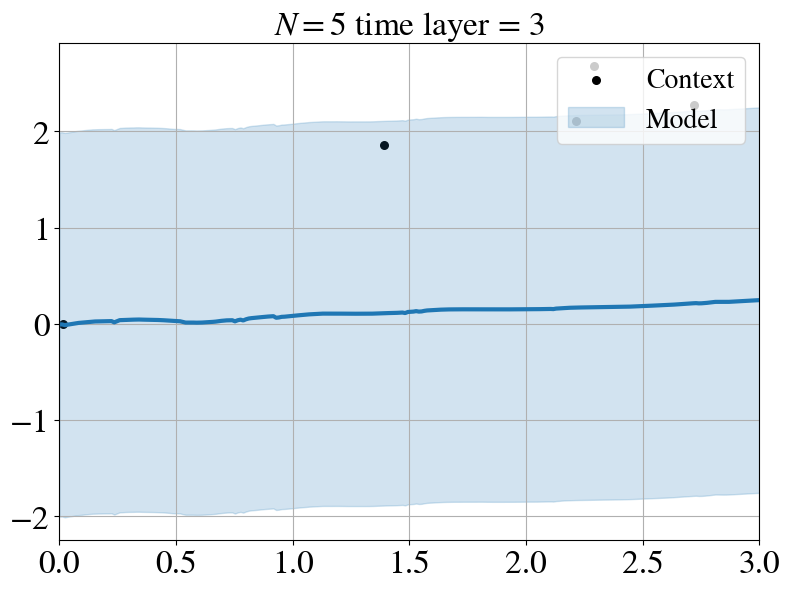

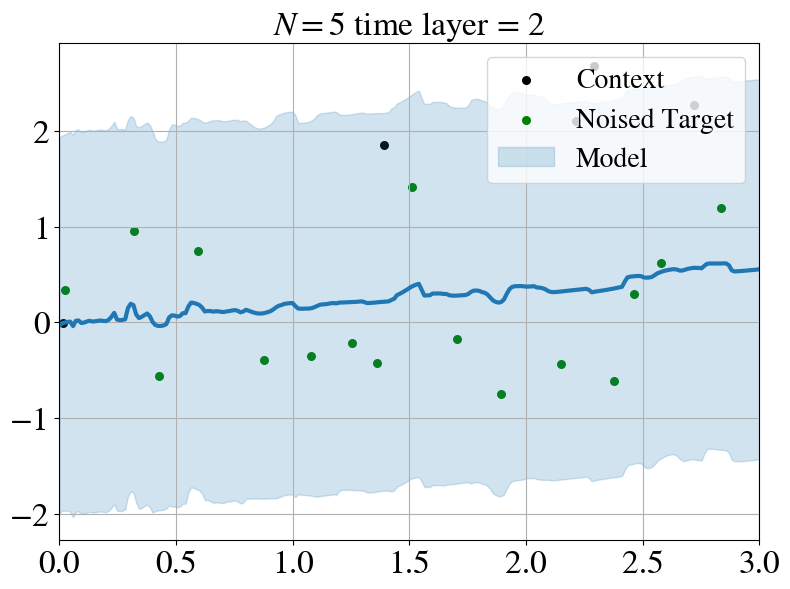

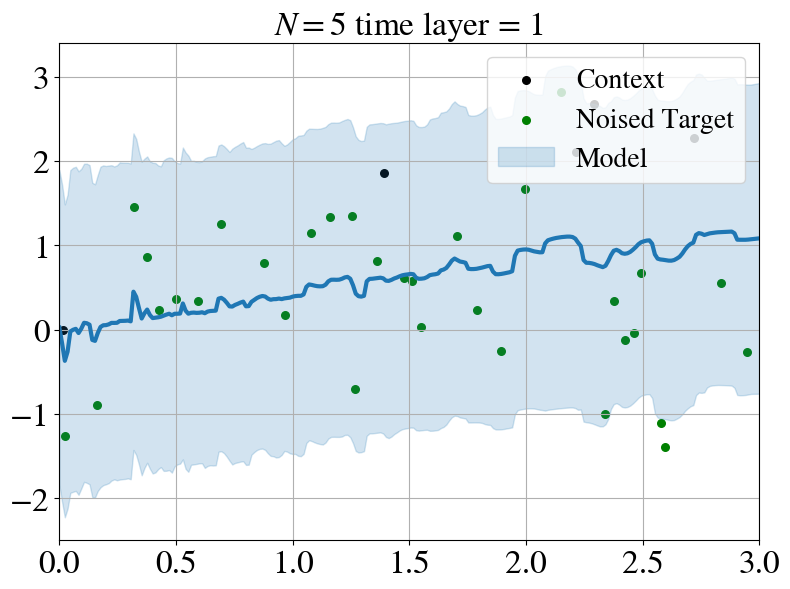

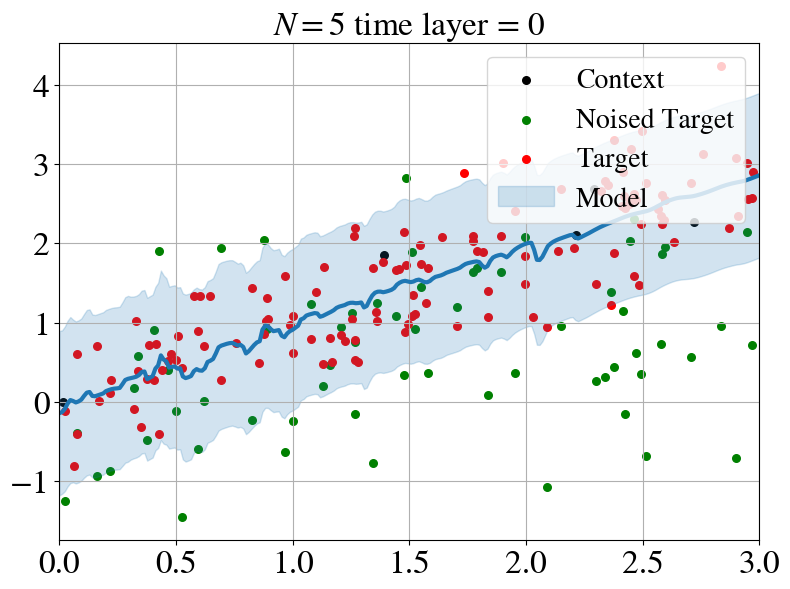

In [42]:
print("Predictions at each layer for model without Gaussian head, 3 layers, beta 0.8")
for i, batch in enumerate(gen_test):
    plot(
            model=model,
            scheduler=scheduler,
            batch=batch,
            pred_fn=discrete_denoising_sampling,
            x_range = (0.0, 3.0),
        )
    if i > 5:
        break


Predictions at each layer for model without Gaussian head, 3 layers, beta 0.7


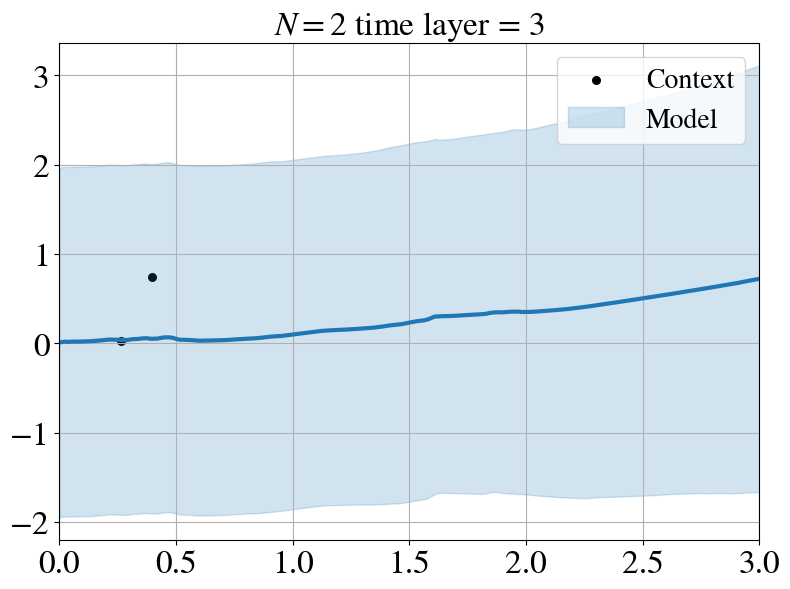

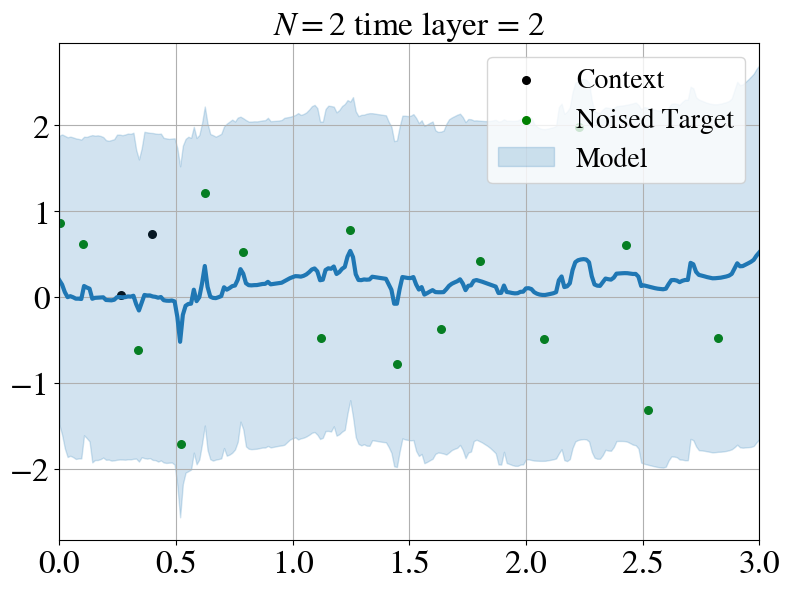

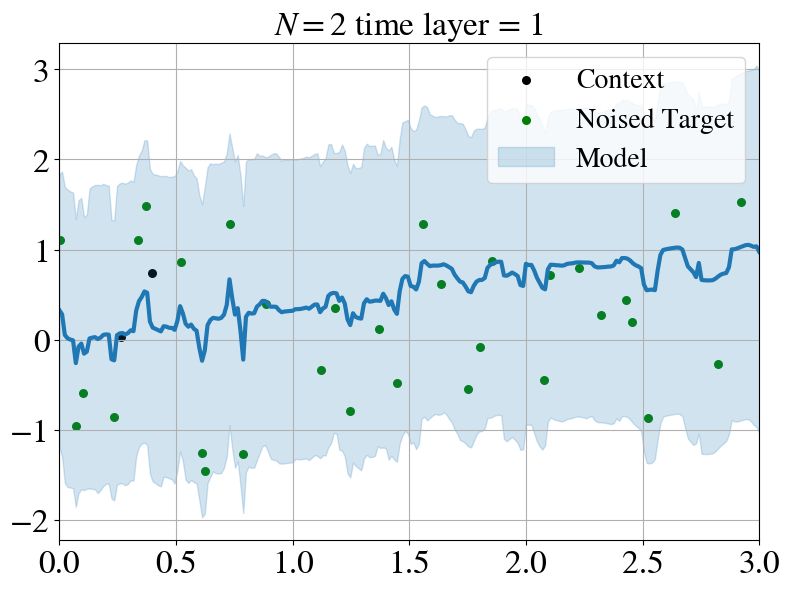

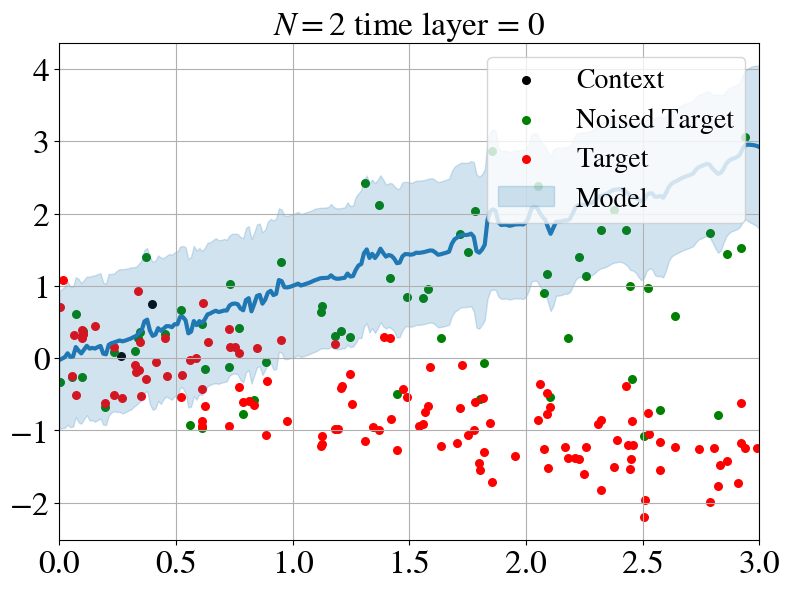

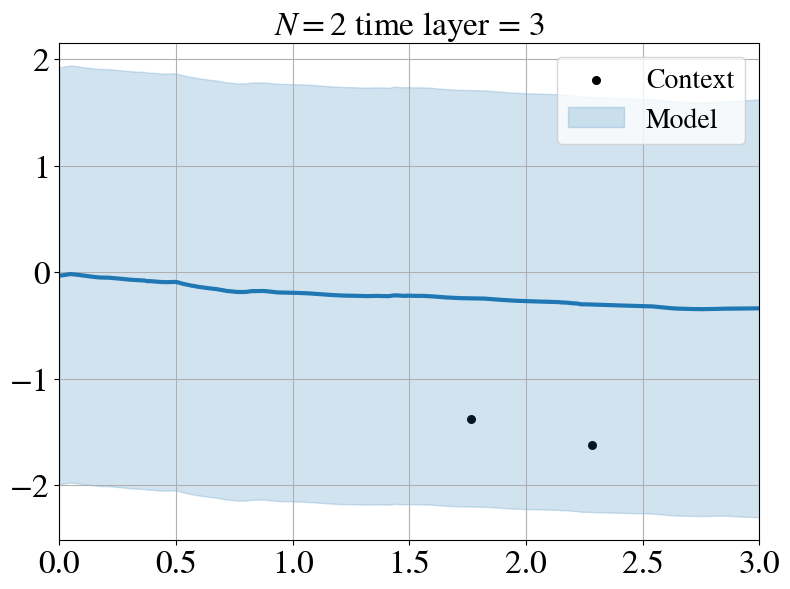

...

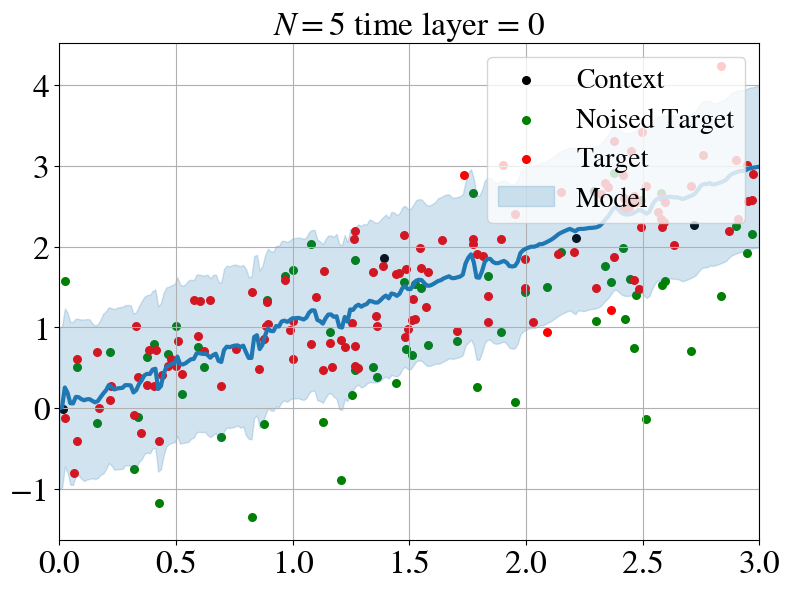

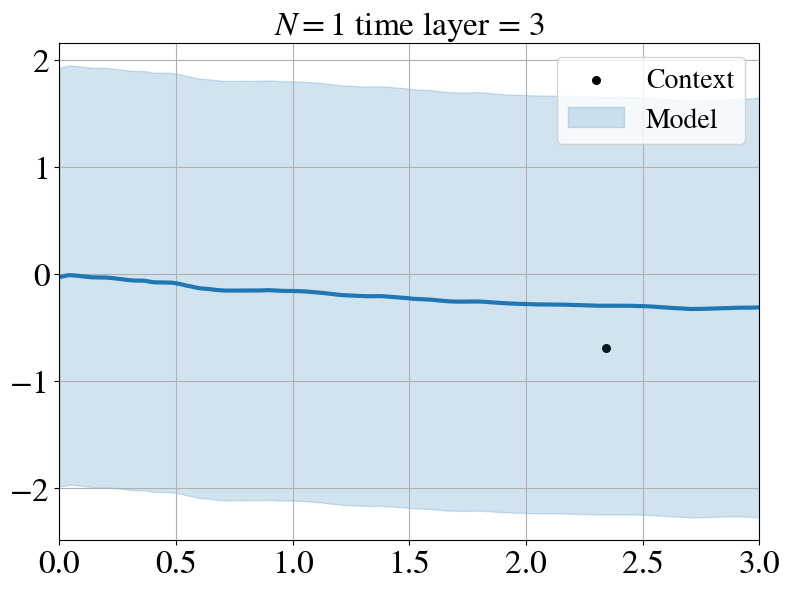

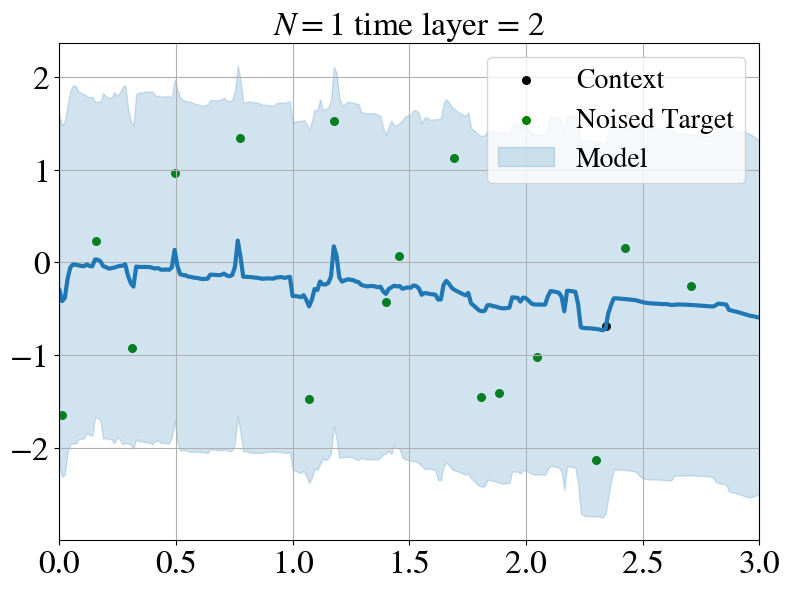

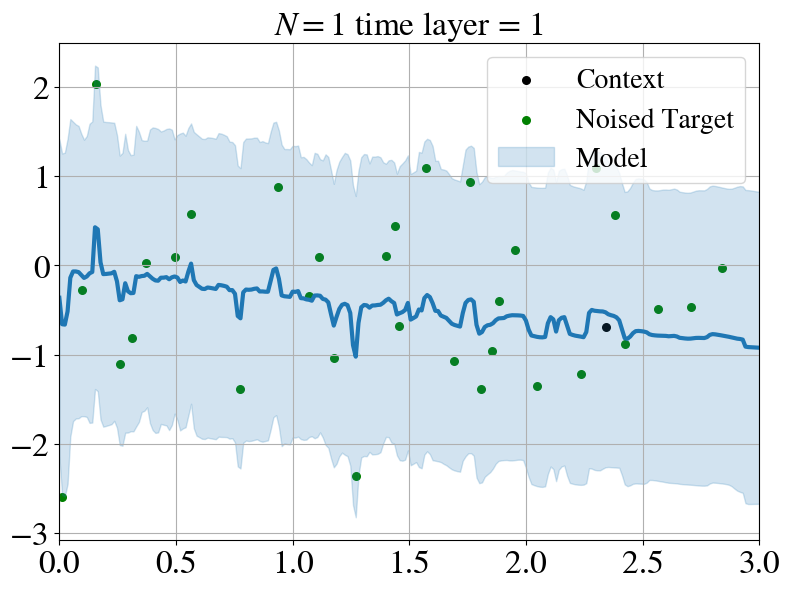

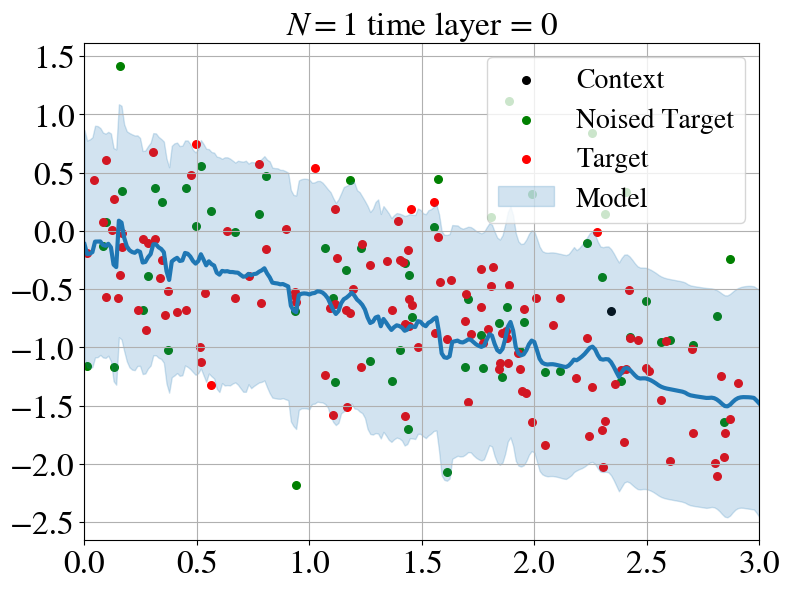

In [83]:
print("Predictions at each layer for model without Gaussian head, 3 layers, beta 0.7")
for i, batch in enumerate(gen_test):
    plot(
            model=model,
            scheduler=scheduler,
            batch=batch,
            pred_fn=discrete_denoising_sampling,
            x_range = (0.0, 3.0),
        )
    if i > 5:
        break


# Plot samples from train generator

In [48]:
xc, xt, yc, yt = [], [], [], []
for i, batch_iter in enumerate(gen_train):
    xc.append(batch_iter.xc)
    xt.append(batch_iter.xt)
    yc.append(batch_iter.yc)
    yt.append(batch_iter.yt)
xc = torch.cat(xc, dim = 1)
xt = torch.cat(xt, dim = 1)
yc = torch.cat(yc, dim = 1)
yt = torch.cat(yt, dim = 1)
xc.shape

torch.Size([16, 15467, 1])

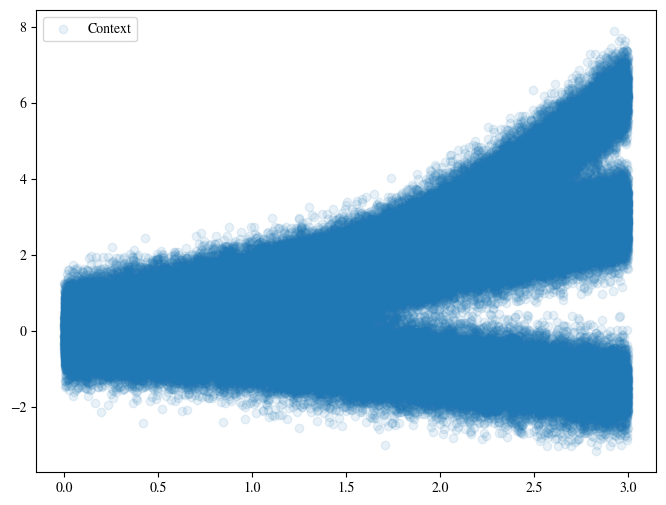

In [49]:
fig = plt.figure(figsize = (8.0, 6.0))
plt.scatter(xc[0:20, ...].view(-1, 1), yc[0:20, ...].view(-1, 1), alpha = 0.1, label = "Context")
plt.legend()

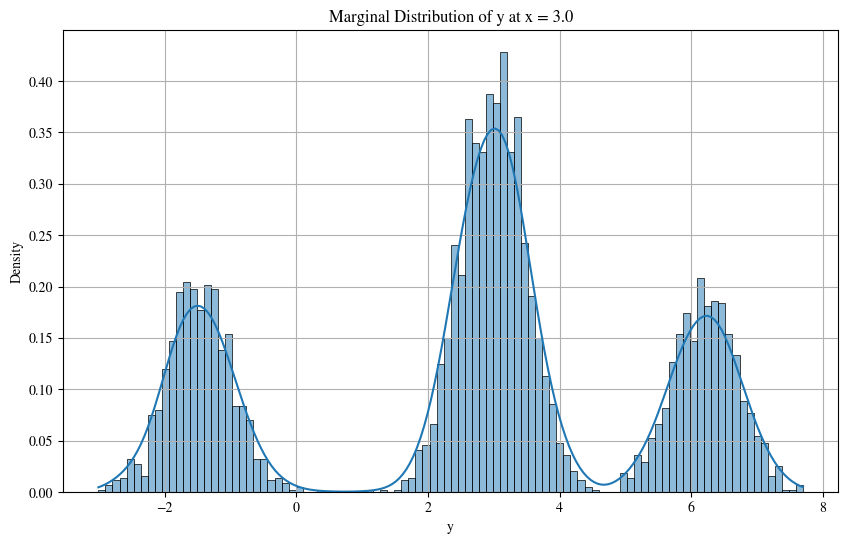

In [50]:
# The density plot of the samples
x_specific = 3.0
# Create a boolean mask where the absolute difference is less than 0.01
mask = torch.abs(xc - x_specific) < 0.05

# Use the mask to filter xc and yc
filtered_xc = xc[mask]
filtered_yc = yc[mask]

plt.figure(figsize=(10, 6))
sns.histplot(filtered_yc, bins=100, kde=True, kde_kws={'bw_adjust': 0.5},  stat='density')

plt.title(f'Marginal Distribution of y at x = {x_specific}')
plt.xlabel('y')
plt.ylabel('Density')
plt.grid(True)
plt.show()

# Plotting marginal

In [35]:
for i, batch_iter in enumerate(gen_test):
    print(batch_iter.xc.shape)
    if batch_iter.xc.shape[1]==0:
        batch = copy.deepcopy(batch_iter)
        # break

torch.Size([16, 2, 1])
torch.Size([16, 2, 1])
torch.Size([16, 0, 1])
torch.Size([16, 3, 1])
torch.Size([16, 2, 1])
torch.Size([16, 5, 1])
torch.Size([16, 1, 1])
torch.Size([16, 5, 1])
torch.Size([16, 4, 1])
torch.Size([16, 1, 1])
torch.Size([16, 3, 1])
torch.Size([16, 4, 1])


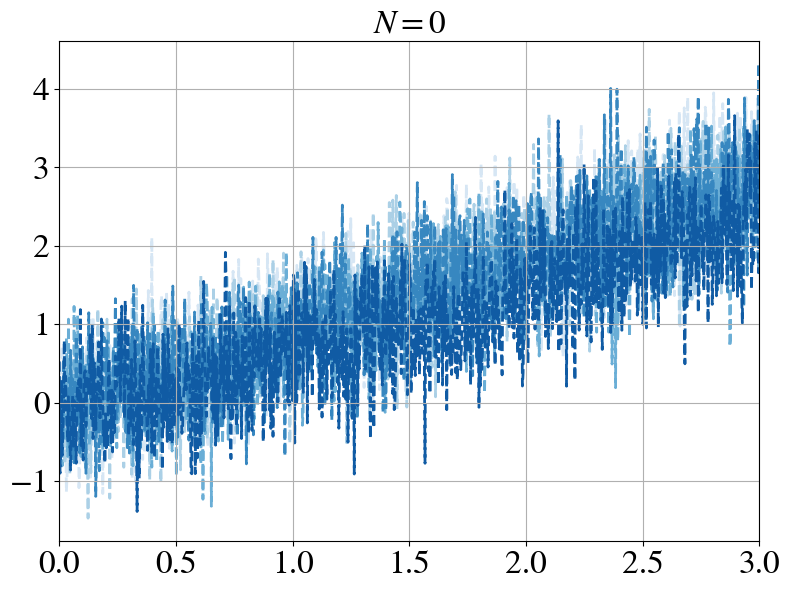

In [77]:
x_range = (0.0, 3.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 1500

colors = iter(list(sns.color_palette("Blues", 5)))
# Get dimension of input data
dim = batch.xc.shape[-1]

if dim == 1:
    x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
        batch.xc
    )[None, :, None]
    xc = batch.xc[:1]
    yc = batch.yc[:1]
    xt = batch.xt[:1]
    yt = batch.yt[:1]

    batch.xc = xc
    batch.yc = yc
    batch.xt = xt
    batch.yt = yt

    plot_batch = copy.deepcopy(batch)
    plot_batch.xt = x_plot

    with torch.no_grad():
        pred_dist = discrete_denoising_preddist(
                model=model,
                batch=plot_batch,
                scheduler=scheduler,
                num_samples=num_samples,
                subsample_targets=True,
        )

    # Make figure for plotting
    fig = plt.figure(figsize=figsize)

    # Plot context and target points
    plt.scatter(
        xc[0, :, 0].cpu().numpy(),
        yc[0, :, 0].cpu().numpy(),
        c="k",
        label="Context",
        s=30,
        zorder=4,
    )

    if len(scheduler)==0:
        pred = pred_dist.rsample((num_samples,)).squeeze(1)
    else:
        pred = pred_dist.rsample()
    for i in range(5):
        plt.plot(
            x_plot[0, :, 0].cpu(),
            pred.squeeze(-1)[i, :].cpu(),
            c=next(colors),
            lw=2,
            zorder=0,
            label=f"Sample {i}",
            linestyle="--",
        )
    title_str = f"$N = {xc.shape[1]}$"        

    plt.title(title_str, fontsize=24)
    plt.grid()

    # Set axis limits
    plt.xlim(x_range)

    plt.xticks(fontsize=24)
    plt.yticks(fontsize=24)

    #plt.legend(loc="upper right", fontsize=20)
    plt.tight_layout()
    plt.show()
    plt.close()
else:
    raise NotImplementedError

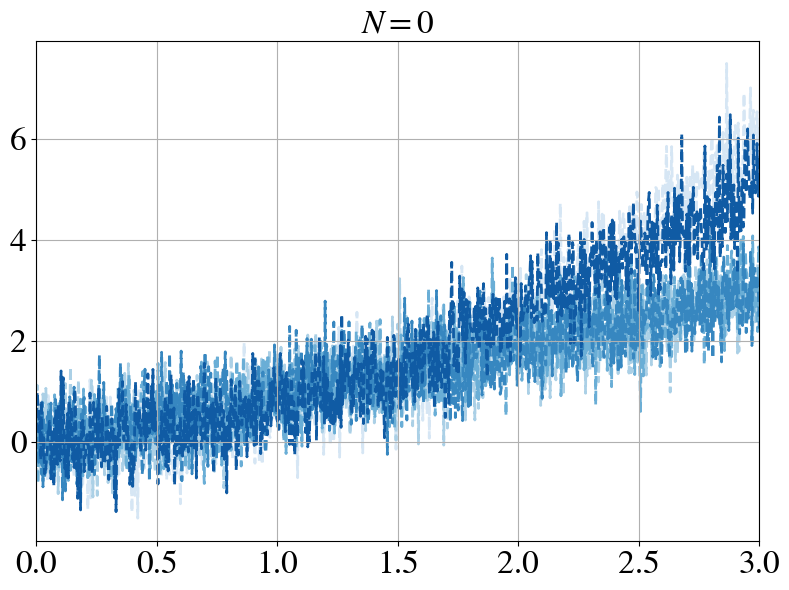

In [37]:
x_range = (0.0, 3.0)
points_per_dim = 1000
figsize = (8.0, 6.0)
num_samples = 5000

colors = iter(list(sns.color_palette("Blues", 5)))
# Get dimension of input data
dim = batch.xc.shape[-1]

if dim == 1:
    x_plot = torch.linspace(x_range[0], x_range[1], points_per_dim).to(
        batch.xc
    )[None, :, None]
    xc = batch.xc[:1]
    yc = batch.yc[:1]
    xt = batch.xt[:1]
    yt = batch.yt[:1]

    batch.xc = xc
    batch.yc = yc
    batch.xt = xt
    batch.yt = yt

    plot_batch = copy.deepcopy(batch)
    plot_batch.xt = x_plot

    with torch.no_grad():
        pred_dist = discrete_denoising_preddist(
                model=model,
                batch=plot_batch,
                scheduler=scheduler,
                num_samples=num_samples,
                subsample_targets=True,
        )

    # Make figure for plotting
    fig = plt.figure(figsize=figsize)

    # Plot context and target points
    plt.scatter(
        xc[0, :, 0].cpu().numpy(),
        yc[0, :, 0].cpu().numpy(),
        c="k",
        label="Context",
        s=30,
        zorder=4,
    )

    if len(scheduler)==0:
        pred = pred_dist.rsample((num_samples,)).squeeze(1)
    else:
        pred = pred_dist.rsample()
    for i in range(5):
        plt.plot(
            x_plot[0, :, 0].cpu(),
            pred.squeeze(-1)[i, :].cpu(),
            c=next(colors),
            lw=2,
            zorder=0,
            label=f"Sample {i}",
            linestyle="--",
        )
    title_str = f"$N = {xc.shape[1]}$"        

    plt.title(title_str, fontsize=24)
    plt.grid()

    # Set axis limits
    plt.xlim(x_range)

    plt.xticks(fontsize=24)
    plt.yticks(fontsize=24)

    #plt.legend(loc="upper right", fontsize=20)
    plt.tight_layout()
    plt.show()
    plt.close()
else:
    raise NotImplementedError

In [29]:
from scipy.stats import norm
# Define the mixture of Gaussians
def mixture_pdf(x_plot, x):
    component = 0
    for i in range(len(gen_test.generators)):
        mean = gen_test.generators[i].get_poly(x).squeeze(0, 1)
        component += gen_test.mixture_probs[i] * norm.pdf(x_plot, loc=mean, scale=gen_test.generators[i].noise_std)
    return component

def plot_marginal(x_specific, x_plot, pred, gen_test):
    # Compute the absolute difference
    diff = torch.abs(x_plot - x_specific)
    # Find the index of the minimum value along axis 1
    idx = torch.argmin(diff, dim=1)[0][0]

    # Get the Ideal CNP distribution
    mixture_components = torch.tensor(gen_test.mixture_probs)
    means = [gen_test.generators[i].get_poly(x_plot[0, idx, 0]).squeeze(0, 1) for i in range(len(gen_test.generators))]
    means = torch.stack(means)
    # Ideal CNP mean
    overall_mean = (means * mixture_components.view(-1, 1)).sum(dim=0)

    # Ideal CNP variance
    var = ((1 + means**2) * mixture_components.view(-1, 1)).sum(dim=0) - overall_mean**2

    plt.figure(figsize=(10, 6))
    #sns.histplot(pred[:, idx, 0], bins=100, kde=True, stat='density')
    sns.kdeplot(pred[:, idx, 0], bw_adjust=0.5, label = 'Empirical')

    # Ideal CNP distibution
    x_plot_true = torch.linspace(overall_mean.item() - 4*torch.sqrt(var).item(), overall_mean.item() + 4*torch.sqrt(var).item(), 1000)
    plt.plot(x_plot_true, norm.pdf(x_plot_true, overall_mean, torch.sqrt(var)), label = 'Ideal CNP', color = 'orange')

    # True distribution
    plt.fill_between(x_plot_true, mixture_pdf(x_plot_true, torch.tensor(x_specific)), alpha=0.4, label = 'True distribution')
    plt.title(f'Marginal Distribution of y at x = {x_specific}')
    plt.xlabel('y')
    plt.ylabel('Density')
    plt.grid(True)
    plt.legend()
    plt.show()
    return

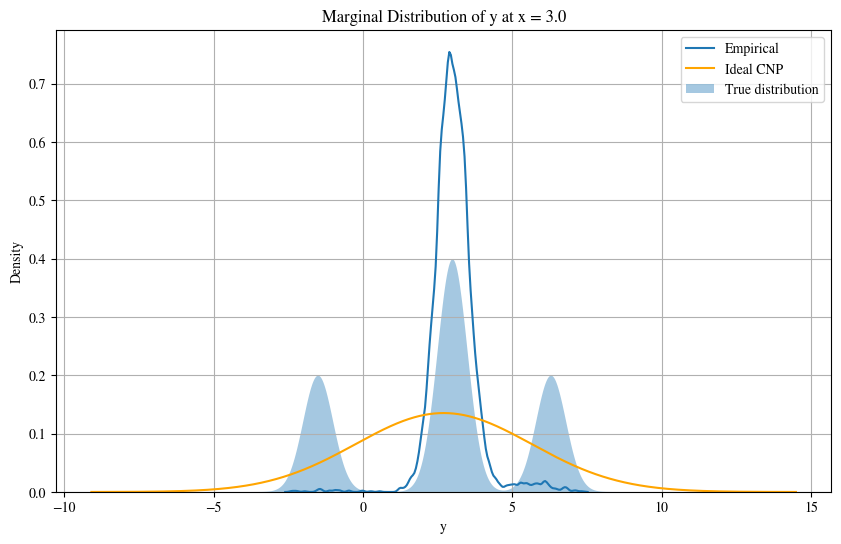

In [94]:
# 3 layers beta 0.6 - 0 context points (5000 samples)
x_specific = 3.0
plot_marginal(x_specific, x_plot, pred, gen_test)

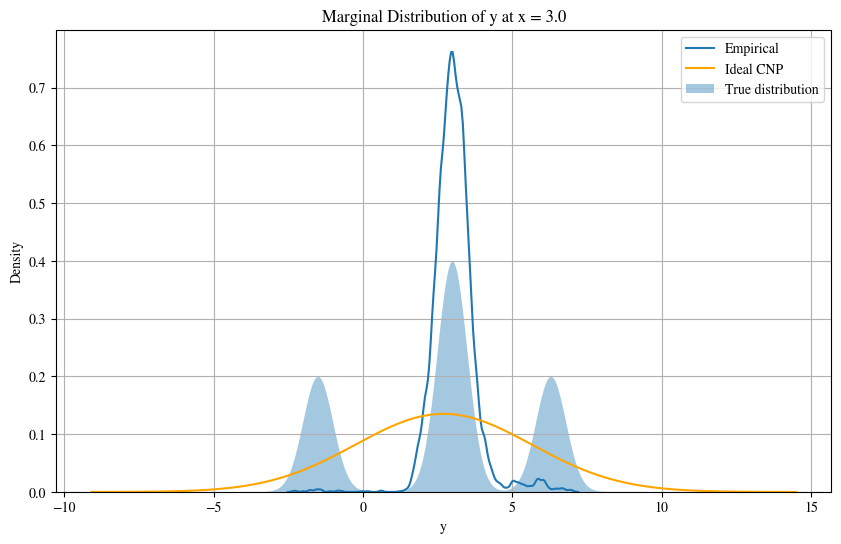

In [90]:
# 3 layers beta 0.7 - 0 context points (5000 samples)
x_specific = 3.0
plot_marginal(x_specific, x_plot, pred, gen_test)

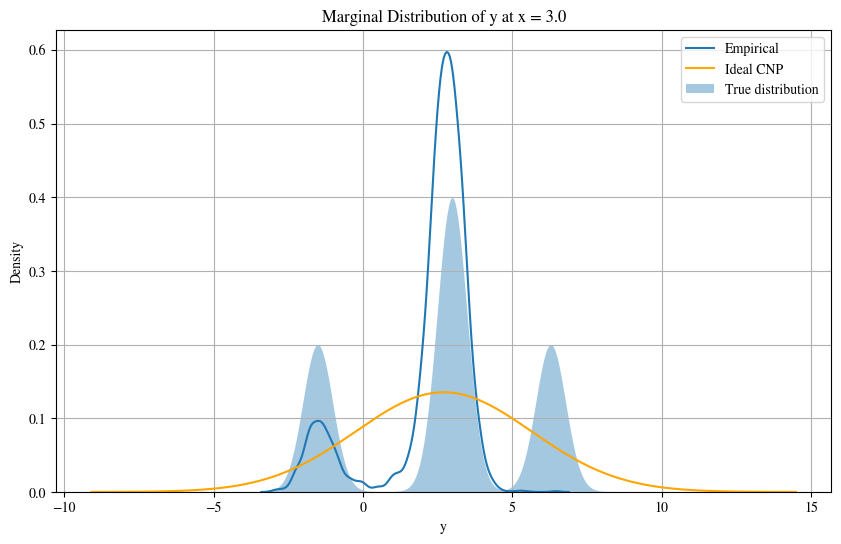

In [100]:
# 3 layers beta 0.8 - 0 context points (5000 samples)
x_specific = 3.0
plot_marginal(x_specific, x_plot, pred, gen_test)

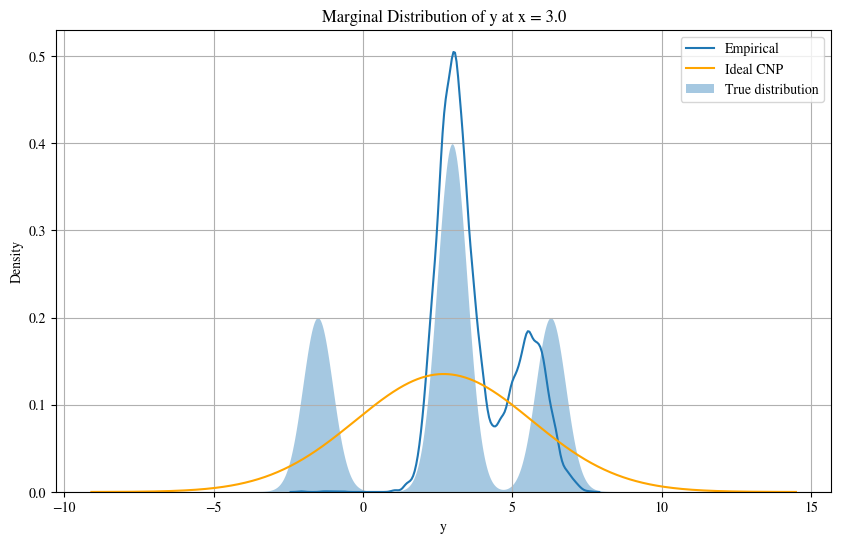

In [38]:
# 3 layers beta 0.6-0.8 - 0 context points (5000 samples)
x_specific = 3.0
plot_marginal(x_specific, x_plot, pred, gen_test)

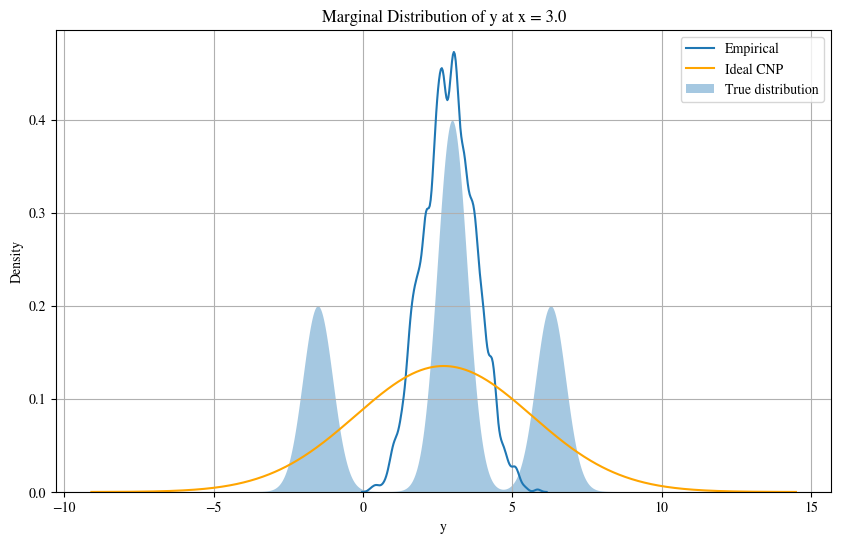

In [73]:
# 0 layers - 2 context points
x_specific = 3.0
plot_marginal(x_specific, x_plot, pred, gen_test)

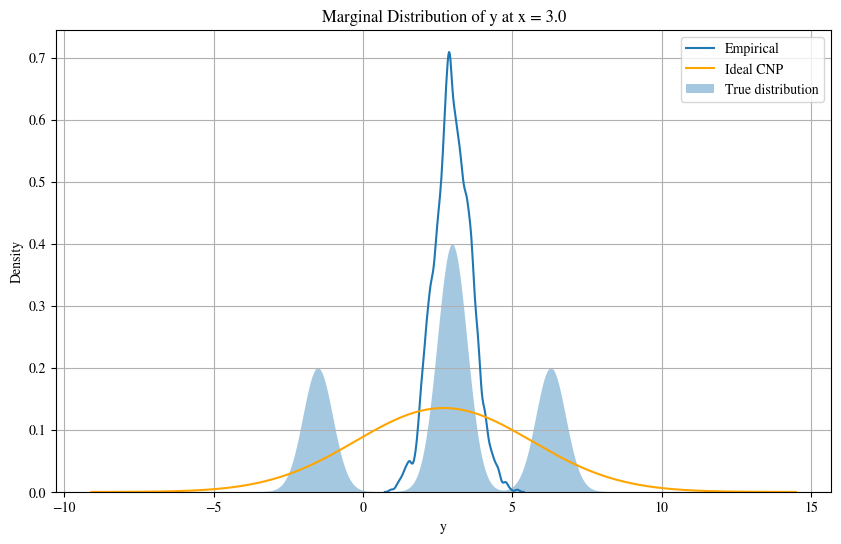

In [54]:
# 0 layers - 0 context points
x_specific = 3.0
plot_marginal(x_specific, x_plot, pred, gen_test)

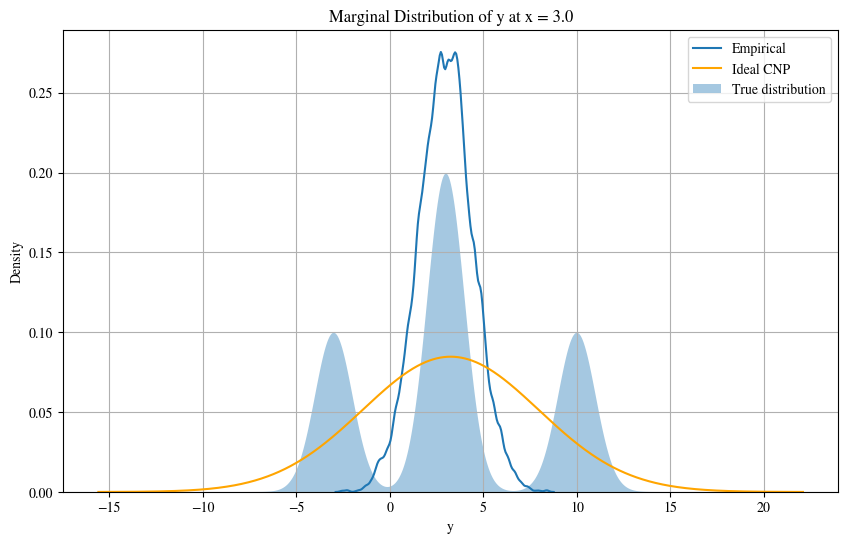

In [9]:
# 0 layers

from scipy.stats import norm
# Define the mixture of Gaussians
def mixture_pdf(x_plot, x):
    component = 0
    for i in range(len(gen_test.generators)):
        mean = gen_test.generators[i].get_poly(x).squeeze(0, 1)
        component += gen_test.mixture_probs[i] * norm.pdf(x_plot, loc=mean, scale=gen_test.generators[i].noise_std)
    return component

# The density plot of the samples
x_specific = 3.0
# Compute the absolute difference
diff = torch.abs(x_plot - x_specific)
# Find the index of the minimum value along axis 1
idx = torch.argmin(diff, dim=1)[0][0]

# Get the Ideal CNP distribution
mixture_components = torch.tensor(gen_test.mixture_probs)
means = [gen_test.generators[i].get_poly(x_plot[0, idx, 0]).squeeze(0, 1) for i in range(len(gen_test.generators))]
means = torch.stack(means)
# Ideal CNP mean
overall_mean = (means * mixture_components.view(-1, 1)).sum(dim=0)

# Ideal CNP variance
var = ((1 + means**2) * mixture_components.view(-1, 1)).sum(dim=0) - overall_mean**2

plt.figure(figsize=(10, 6))
#sns.histplot(pred[:, idx, 0], bins=100, kde=True, stat='density')
sns.kdeplot(pred[:, idx, 0], bw_adjust=0.5, label = 'Empirical')

# Ideal CNP distibution
x_plot_true = torch.linspace(overall_mean.item() - 4*torch.sqrt(var).item(), overall_mean.item() + 4*torch.sqrt(var).item(), 1000)
plt.plot(x_plot_true, norm.pdf(x_plot_true, overall_mean, torch.sqrt(var)), label = 'Ideal CNP', color = 'orange')

# True distribution
plt.fill_between(x_plot_true, mixture_pdf(x_plot_true, torch.tensor(x_specific)), alpha=0.4, label = 'True distribution')
plt.title(f'Marginal Distribution of y at x = {x_specific}')
plt.xlabel('y')
plt.ylabel('Density')
plt.grid(True)
plt.legend()
plt.show()